# Data Exploration Turbofan Dataset
Group 2

This data exploration is for each turbine independently, and in the end, we summarize the findings.

In [1]:
import os

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from scipy.stats import pearsonr
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

## 0. Load Data

In [2]:
turbine1_train = pd.read_csv('../data/train_FD001.txt', delim_whitespace=True, header=None)
turbine1_test = pd.read_csv('../data/test_FD001.txt', delim_whitespace=True, header=None)
turbine2_train = pd.read_csv('../data/train_FD002.txt', delim_whitespace=True, header=None)
turbine2_test = pd.read_csv('../data/test_FD002.txt', delim_whitespace=True, header=None)
turbine3_train = pd.read_csv('../data/train_FD003.txt', delim_whitespace=True, header=None)
turbine3_test = pd.read_csv('../data/test_FD003.txt', delim_whitespace=True, header=None)
turbine4_train = pd.read_csv('../data/train_FD004.txt', delim_whitespace=True, header=None)
turbine4_test = pd.read_csv('../data/test_FD004.txt', delim_whitespace=True, header=None)

/tmp/ipykernel_1061/1451112253.py:1: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  turbine1_train = pd.read_csv('../data/train_FD001.txt', delim_whitespace=True, header=None)
/tmp/ipykernel_1061/1451112253.py:2: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  turbine1_test = pd.read_csv('../data/test_FD001.txt', delim_whitespace=True, header=None)
/tmp/ipykernel_1061/1451112253.py:3: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  turbine2_train = pd.read_csv('../data/train_FD002.txt', delim_whitespace=True, header=None)
/tmp/ipykernel_1061/1451112253.py:4: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  tu

In [3]:
turbine1_rul_test = pd.read_csv('../data/RUL_FD001.txt',sep='\s+', header=None, names=["RUL"])
turbine2_rul_test = pd.read_csv('../data/RUL_FD002.txt',sep='\s+', header=None, names=["RUL"])
turbine3_rul_test = pd.read_csv('../data/RUL_FD003.txt',sep='\s+', header=None, names=["RUL"])
turbine4_rul_test = pd.read_csv('../data/RUL_FD004.txt',sep='\s+', header=None, names=["RUL"])

In [4]:
# Define column names
index_columns_names =  ["unit_number","cycle"]
operational_settings_columns_names = ["operational_setting_"+str(i) for i in range(1,4)]
sensor_measure_columns_names =["sensor_measure_"+str(i) for i in range(1,22)]
input_file_column_names = index_columns_names + operational_settings_columns_names + sensor_measure_columns_names

In [5]:
# Sensor dictionairy from corresponding paper: https://ieeexplore.ieee.org/stamp/stamp.jsp?tp=&arnumber=4711414
sensor_dict={}
dict_list=[ "(Total temperature at fan inlet) (◦R)",
"(Total temperature at LPC outlet) (◦R)",
"(Total temperature at HPC outlet) (◦R)",
"(Total temperature at LPT outlet) (◦R)",
"(Pressure at fan inlet) (psia)",
"(Total pressure in bypass-duct) (psia)",
"(Total pressure at HPC outlet) (psia)",
"(Physical fan speed) (rpm)",
"(Physical core speed) (rpm)",
"(Engine pressure ratio(P50/P2)",
"(Static pressure at HPC outlet) (psia)",
"(Ratio of fuel flow to Ps30) (pps/psia)",
"(Corrected fan speed) (rpm)",
"(Corrected core speed) (rpm)",
"(Bypass Ratio) ",
"(Burner fuel-air ratio)",
"(Bleed Enthalpy)",
"(Demanded fan speed) (rpm)",
"(Demanded corrected fan speed) (rpm)",
"(HPT coolant bleed) (lbm/s)",
"(LPT coolant bleed) (lbm/s)" ]
i=1
for x in dict_list :
    sensor_dict['sensor_measure_'+str(i)]=x
    i+=1
sensor_dict

{'sensor_measure_1': '(Total temperature at fan inlet) (◦R)',
 'sensor_measure_2': '(Total temperature at LPC outlet) (◦R)',
 'sensor_measure_3': '(Total temperature at HPC outlet) (◦R)',
 'sensor_measure_4': '(Total temperature at LPT outlet) (◦R)',
 'sensor_measure_5': '(Pressure at fan inlet) (psia)',
 'sensor_measure_6': '(Total pressure in bypass-duct) (psia)',
 'sensor_measure_7': '(Total pressure at HPC outlet) (psia)',
 'sensor_measure_8': '(Physical fan speed) (rpm)',
 'sensor_measure_9': '(Physical core speed) (rpm)',
 'sensor_measure_10': '(Engine pressure ratio(P50/P2)',
 'sensor_measure_11': '(Static pressure at HPC outlet) (psia)',
 'sensor_measure_12': '(Ratio of fuel flow to Ps30) (pps/psia)',
 'sensor_measure_13': '(Corrected fan speed) (rpm)',
 'sensor_measure_14': '(Corrected core speed) (rpm)',
 'sensor_measure_15': '(Bypass Ratio) ',
 'sensor_measure_16': '(Burner fuel-air ratio)',
 'sensor_measure_17': '(Bleed Enthalpy)',
 'sensor_measure_18': '(Demanded fan speed

In [6]:
turbine1_train.columns = input_file_column_names
turbine1_test.columns = input_file_column_names
turbine2_train.columns = input_file_column_names
turbine2_test.columns = input_file_column_names
turbine3_train.columns = input_file_column_names
turbine3_test.columns = input_file_column_names
turbine4_train.columns = input_file_column_names
turbine4_test.columns = input_file_column_names

In [7]:
# Add RUL column to the dataframes
def add_remaining_useful_life(df):
    # Get the total number of cycles for each unit
    grouped_by_unit = df.groupby(by="unit_number")
    max_cycle = grouped_by_unit["cycle"].max()
    result_frame = df.merge(max_cycle.to_frame(name='max_cycle'), left_on='unit_number', right_index=True)
    remaining_useful_life = result_frame["max_cycle"] - result_frame["cycle"]
    result_frame["RUL"] = remaining_useful_life
    result_frame.drop("max_cycle", axis=1, inplace=True)
    return result_frame

#Only for train data. Test data we dont have max_cycle
turbine1_train = add_remaining_useful_life(turbine1_train)
turbine2_train = add_remaining_useful_life(turbine2_train)
turbine3_train = add_remaining_useful_life(turbine3_train)
turbine4_train = add_remaining_useful_life(turbine4_train)

## 1. Data Exploration

### 1.1 Turbine 1

#### 1.1.1 Data inspection

In [8]:
print("Training Data Rows {}, Columns {}".format(turbine1_train.shape[0], turbine1_train.shape[1]))
print("Test Data Rows {}, Columns {}".format(turbine1_test.shape[0], turbine1_test.shape[1]))
turbine1_train.head()

Training Data Rows 20631, Columns 27
Test Data Rows 13096, Columns 26


,unit_number,cycle,operational_setting_1,operational_setting_2,operational_setting_3,sensor_measure_1,sensor_measure_2,sensor_measure_3,sensor_measure_4,sensor_measure_5,...,sensor_measure_13,sensor_measure_14,sensor_measure_15,sensor_measure_16,sensor_measure_17,sensor_measure_18,sensor_measure_19,sensor_measure_20,sensor_measure_21,RUL
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190,191
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236,190
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442,189
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739,188
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044,187


In [9]:
print("Test Data Rows {}, Columns {}".format(turbine1_test.shape[0], turbine1_test.shape[1]))
turbine1_test.head()

Test Data Rows 13096, Columns 26


,unit_number,cycle,operational_setting_1,operational_setting_2,operational_setting_3,sensor_measure_1,sensor_measure_2,sensor_measure_3,sensor_measure_4,sensor_measure_5,...,sensor_measure_12,sensor_measure_13,sensor_measure_14,sensor_measure_15,sensor_measure_16,sensor_measure_17,sensor_measure_18,sensor_measure_19,sensor_measure_20,sensor_measure_21
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,...,521.72,2388.03,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,...,522.16,2388.06,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,...,521.97,2388.03,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,...,521.38,2388.05,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,...,522.15,2388.03,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130


In [10]:
units = turbine1_train["unit_number"].unique()
print("The training data contains {} turbofan motors.".format(len(units)))

units = turbine1_test["unit_number"].unique()
print("The test data contains {} turbofan motors.".format(len(units)))

The training data contains 100 turbofan motors.
The test data contains 100 turbofan motors.


In [11]:
print("Y test shape: ", turbine1_rul_test.shape)

Y test shape:  (100, 1)


In [12]:
# Check  missing values
turbine1_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20631 entries, 0 to 20630
Data columns (total 27 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   unit_number            20631 non-null  int64  
 1   cycle                  20631 non-null  int64  
 2   operational_setting_1  20631 non-null  float64
 3   operational_setting_2  20631 non-null  float64
 4   operational_setting_3  20631 non-null  float64
 5   sensor_measure_1       20631 non-null  float64
 6   sensor_measure_2       20631 non-null  float64
 7   sensor_measure_3       20631 non-null  float64
 8   sensor_measure_4       20631 non-null  float64
 9   sensor_measure_5       20631 non-null  float64
 10  sensor_measure_6       20631 non-null  float64
 11  sensor_measure_7       20631 non-null  float64
 12  sensor_measure_8       20631 non-null  float64
 13  sensor_measure_9       20631 non-null  float64
 14  sensor_measure_10      20631 non-null  float64
 15  se

In [13]:
turbine1_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13096 entries, 0 to 13095
Data columns (total 26 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   unit_number            13096 non-null  int64  
 1   cycle                  13096 non-null  int64  
 2   operational_setting_1  13096 non-null  float64
 3   operational_setting_2  13096 non-null  float64
 4   operational_setting_3  13096 non-null  float64
 5   sensor_measure_1       13096 non-null  float64
 6   sensor_measure_2       13096 non-null  float64
 7   sensor_measure_3       13096 non-null  float64
 8   sensor_measure_4       13096 non-null  float64
 9   sensor_measure_5       13096 non-null  float64
 10  sensor_measure_6       13096 non-null  float64
 11  sensor_measure_7       13096 non-null  float64
 12  sensor_measure_8       13096 non-null  float64
 13  sensor_measure_9       13096 non-null  float64
 14  sensor_measure_10      13096 non-null  float64
 15  se

All values are numeric and there are no missing values.

In [14]:
# Check if there are missing cycles in any unit
grouped = turbine1_train.groupby('unit_number')
missing_cycles = []
for unit, group in grouped:
    # Check if all cycles from 1 to max cycle number exist
    if not all(cycle in group['cycle'].values for cycle in range(1, group['cycle'].max() + 1)):
        missing_cycles.append(unit)
print("Number of missing cycles: " ,missing_cycles)

Number of missing cycles:  []


In [15]:
# Statistics summary
turbine1_train.describe(include='all')

,unit_number,cycle,operational_setting_1,operational_setting_2,operational_setting_3,sensor_measure_1,sensor_measure_2,sensor_measure_3,sensor_measure_4,sensor_measure_5,...,sensor_measure_13,sensor_measure_14,sensor_measure_15,sensor_measure_16,sensor_measure_17,sensor_measure_18,sensor_measure_19,sensor_measure_20,sensor_measure_21,RUL
count,20631.000000,20631.000000,20631.000000,20631.000000,20631.0,2.063100e+04,20631.000000,20631.000000,20631.000000,2.063100e+04,...,20631.000000,20631.000000,20631.000000,2.063100e+04,20631.000000,20631.0,20631.0,20631.000000,20631.000000,20631.000000
mean,51.506568,108.807862,-0.000009,0.000002,100.0,5.186700e+02,642.680934,1590.523119,1408.933782,1.462000e+01,...,2388.096152,8143.752722,8.442146,3.000000e-02,393.210654,2388.0,100.0,38.816271,23.289705,107.807862
std,29.227633,68.880990,0.002187,0.000293,0.0,6.537152e-11,0.500053,6.131150,9.000605,3.394700e-12,...,0.071919,19.076176,0.037505,1.556432e-14,1.548763,0.0,0.0,0.180746,0.108251,68.880990
min,1.000000,1.000000,-0.008700,-0.000600,100.0,5.186700e+02,641.210000,1571.040000,1382.250000,1.462000e+01,...,2387.880000,8099.940000,8.324900,3.000000e-02,388.000000,2388.0,100.0,38.140000,22.894200,0.000000
25%,26.000000,52.000000,-0.001500,-0.000200,100.0,5.186700e+02,642.325000,1586.260000,1402.360000,1.462000e+01,...,2388.040000,8133.245000,8.414900,3.000000e-02,392.000000,2388.0,100.0,38.700000,23.221800,51.000000
50%,52.000000,104.000000,0.000000,0.000000,100.0,5.186700e+02,642.640000,1590.100000,1408.040000,1.462000e+01,...,2388.090000,8140.540000,8.438900,3.000000e-02,393.000000,2388.0,100.0,38.830000,23.297900,103.000000
75%,77.000000,156.000000,0.001500,0.000300,100.0,5.186700e+02,643.000000,1594.380000,1414.555000,1.462000e+01,...,2388.140000,8148.310000,8.465600,3.000000e-02,394.000000,2388.0,100.0,38.950000,23.366800,155.000000
max,100.000000,362.000000,0.008700,0.000600,100.0,5.186700e+02,644.530000,1616.910000,1441.490000,1.462000e+01,...,2388.560000,8293.720000,8.584800,3.000000e-02,400.000000,2388.0,100.0,39.430000,23.618400,361.000000


In [16]:
turbine1_test.describe(include='all')

,unit_number,cycle,operational_setting_1,operational_setting_2,operational_setting_3,sensor_measure_1,sensor_measure_2,sensor_measure_3,sensor_measure_4,sensor_measure_5,...,sensor_measure_12,sensor_measure_13,sensor_measure_14,sensor_measure_15,sensor_measure_16,sensor_measure_17,sensor_measure_18,sensor_measure_19,sensor_measure_20,sensor_measure_21
count,13096.000000,13096.000000,13096.000000,13096.000000,13096.0,1.309600e+04,13096.000000,13096.000000,13096.000000,1.309600e+04,...,13096.000000,13096.000000,13096.000000,13096.000000,1.309600e+04,13096.000000,13096.0,13096.0,13096.000000,13096.000000
mean,51.543907,76.836515,-0.000011,0.000004,100.0,5.186700e+02,642.475088,1588.099204,1404.735362,1.462000e+01,...,521.747724,2388.071025,8138.947817,8.425844,3.000000e-02,392.571625,2388.0,100.0,38.892502,23.335743
std,28.289423,53.057749,0.002203,0.000294,0.0,6.014263e-11,0.400899,5.003274,6.688309,2.671743e-12,...,0.559627,0.056934,10.188605,0.029009,8.823140e-15,1.233577,0.0,0.0,0.141681,0.084120
min,1.000000,1.000000,-0.008200,-0.000600,100.0,5.186700e+02,641.130000,1569.040000,1384.390000,1.462000e+01,...,519.380000,2387.890000,8108.500000,8.332800,3.000000e-02,389.000000,2388.0,100.0,38.310000,22.935400
25%,28.000000,33.000000,-0.001500,-0.000200,100.0,5.186700e+02,642.197500,1584.600000,1399.950000,1.462000e+01,...,521.380000,2388.030000,8132.310000,8.405600,3.000000e-02,392.000000,2388.0,100.0,38.800000,23.281600
50%,52.000000,69.000000,-0.000000,-0.000000,100.0,5.186700e+02,642.460000,1587.990000,1404.440000,1.462000e+01,...,521.780000,2388.070000,8138.390000,8.424900,3.000000e-02,393.000000,2388.0,100.0,38.900000,23.339200
75%,76.000000,113.000000,0.001500,0.000300,100.0,5.186700e+02,642.740000,1591.362500,1409.050000,1.462000e+01,...,522.150000,2388.110000,8144.360000,8.444300,3.000000e-02,393.000000,2388.0,100.0,38.990000,23.393600
max,100.000000,303.000000,0.007800,0.000700,100.0,5.186700e+02,644.300000,1607.550000,1433.360000,1.462000e+01,...,523.760000,2388.320000,8220.480000,8.541400,3.000000e-02,397.000000,2388.0,100.0,39.410000,23.641900


#### 1.1.2 Feauture distribution

In [17]:
# Search for constant columns
constant_columns = turbine1_train.columns[turbine1_train.nunique() == 1]

# Display constant value columns
constant_value_df = turbine1_train[constant_columns]
print("Constant value columns:")
print(constant_value_df)

Constant value columns:
       operational_setting_3  sensor_measure_1  sensor_measure_5  \
0                      100.0            518.67             14.62   
1                      100.0            518.67             14.62   
2                      100.0            518.67             14.62   
3                      100.0            518.67             14.62   
4                      100.0            518.67             14.62   
...                      ...               ...               ...   
20626                  100.0            518.67             14.62   
20627                  100.0            518.67             14.62   
20628                  100.0            518.67             14.62   
20629                  100.0            518.67             14.62   
20630                  100.0            518.67             14.62   

       sensor_measure_10  sensor_measure_16  sensor_measure_18  \
0                    1.3               0.03               2388   
1                    1.3   

The column setting_3, sensor_1, sensor_5, sensor_16,  sensor_10, sensor_18, and sensor_19 in  only contain a constant value both the training and test set and therefore add no information to the prediction. 

Moreover, the sensor_6 value exhibits a low std of 0.001389 which shows that there is minimal variability and that the value is mostly constant except for a few outliers. This is confirmed when observing the box plot and sensor signal plots below. Therefore, these sensor values can be dropped. 

In [18]:
columns_to_remove = ['operational_setting_3',  'sensor_measure_1', 'sensor_measure_5', 'sensor_measure_6', 'sensor_measure_10','sensor_measure_16', 'sensor_measure_18', 'sensor_measure_19']
turbine1_train =turbine1_train.drop(columns_to_remove, axis=1)
turbine1_test = turbine1_test.drop(columns_to_remove, axis=1)
sensor_names = [s for s in sensor_measure_columns_names if s not in columns_to_remove]

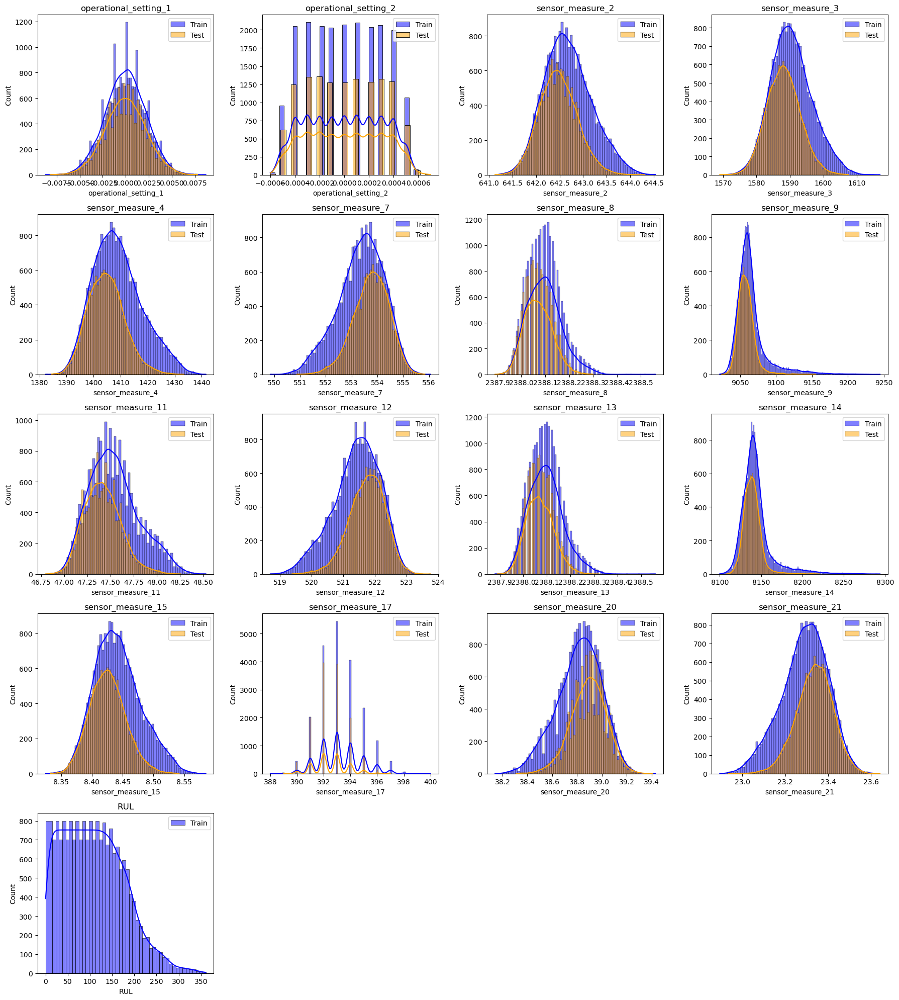

In [19]:
# Calculate the number of rows needed
columns = turbine1_train.drop(['unit_number', 'cycle'], axis=1).columns
num_rows = len(columns) // 4
if len(columns) % 4 != 0:
    num_rows += 1

fig, axes = plt.subplots(num_rows, 4, figsize=(18, 4 * num_rows))
axes = axes.flatten()

# Plot histograms for each sensor
for i, feature in enumerate(columns):
    ax = axes[i]
    sns.histplot(turbine1_train[feature], kde=True, color='blue', label='Train', ax=ax)
    if feature != 'RUL':
        sns.histplot(turbine1_test[feature], kde=True, color='orange', label='Test', ax=ax)
    ax.set_title(feature)
    ax.legend()

# Hide empty subplots
for i in range(len(columns), num_rows * 4):
    axes[i].axis('off')

plt.tight_layout()
plt.show()

Almost all variables follow a  gaussian distribution which is slightly skewed, except sensor_17 and setting_2.

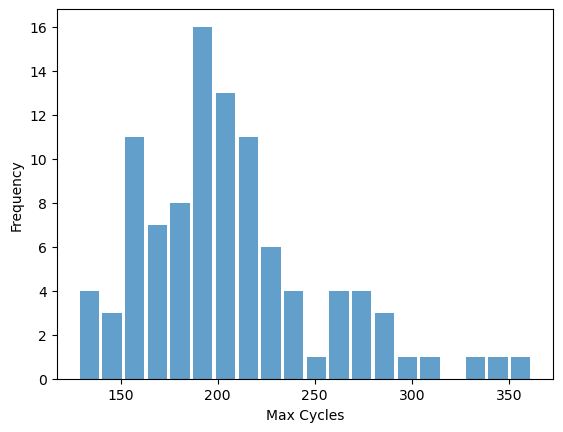

In [20]:
grouped_by_unit = turbine1_train.groupby(by="unit_number")
max_cycle = grouped_by_unit["cycle"].max()
plt.hist(x=max_cycle, bins=20,alpha=0.7, rwidth=0.85);
plt.xlabel('Max Cycles')
plt.ylabel('Frequency');

In [21]:
print("Maximum life cycle in the training set is :", max_cycle.max())
print("Minimum life cycle in the training set is :", max_cycle.min())

Maximum life cycle in the training set is : 362
Minimum life cycle in the training set is : 128


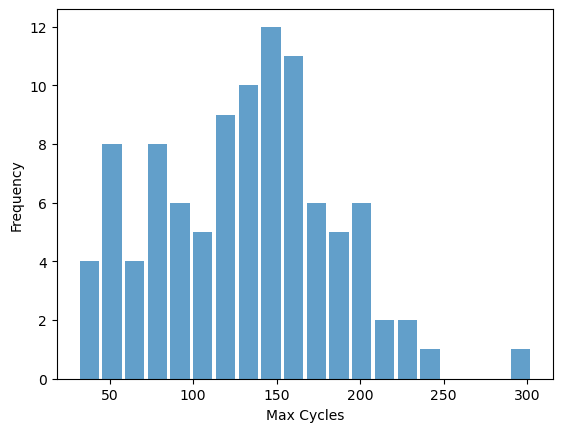

In [22]:
grouped_by_unit = turbine1_test.groupby(by="unit_number")
max_cycle = grouped_by_unit["cycle"].max()
plt.hist(x=max_cycle, bins=20,alpha=0.7, rwidth=0.85);
plt.xlabel('Max Cycles')
plt.ylabel('Frequency');

In [23]:
print("Maximum cycle number in the test set is :", max_cycle.max())
print("Minimum cycle number in the test set is :", max_cycle.min())

Maximum cycle number in the test set is : 303
Minimum cycle number in the test set is : 31


**The sliding window size should be smaller than 31 for this dataset**

#### 1.1.3 Correlation

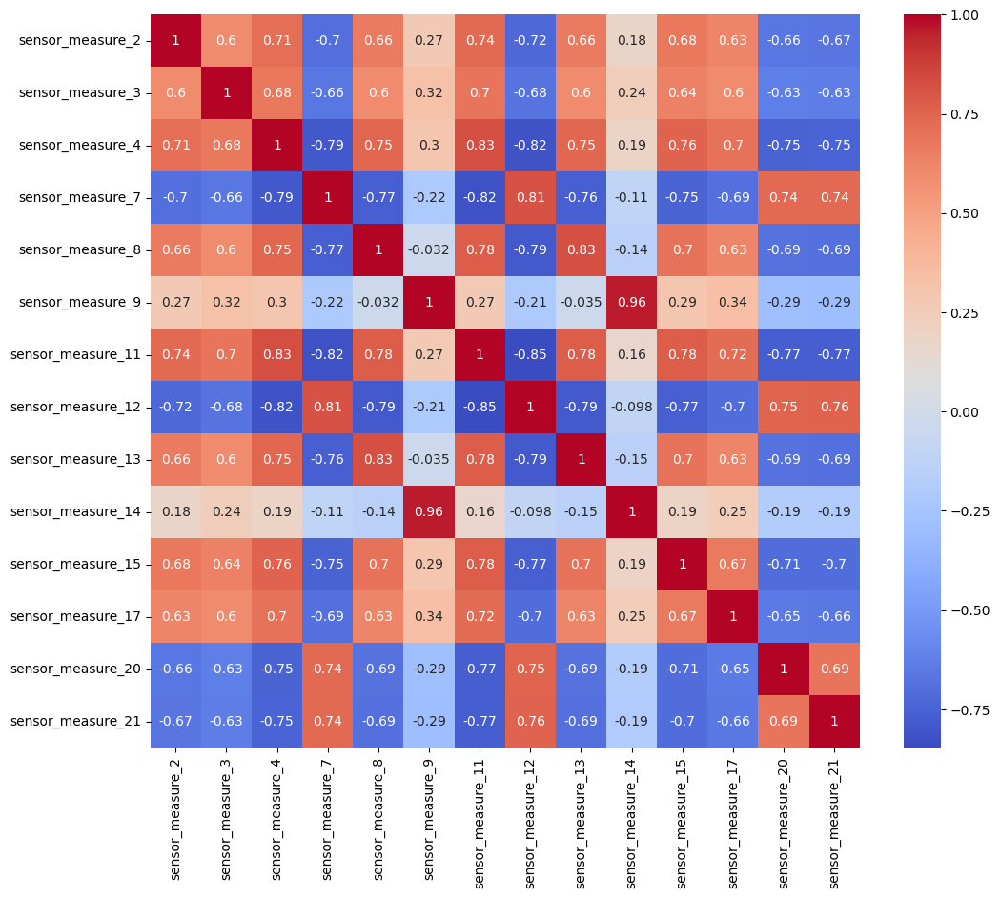

In [24]:
plt.figure(figsize=(12,10))
corr = turbine1_train[sensor_names].corr()
sns.heatmap(corr,annot=True, cmap = 'coolwarm')
plt.show()

Some sensor values are highly correlated with each other. 

In [25]:
def get_high_correlation_pairs(corr_matrix, threshold=0.8):
    # Get the upper triangle of the correlation matrix
    upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
    
    # Find index of feature pairs with correlation greater than the threshold
    high_corr_pairs = [(sensor1, sensor2, corr_matrix.loc[sensor1, sensor2])
                       for sensor1 in upper.columns for sensor2 in upper.index
                       if abs(upper.loc[sensor1, sensor2]) > threshold]
    
    return high_corr_pairs

# Get the high correlation pairs
high_corr_pairs = get_high_correlation_pairs(corr, threshold=0.8)

# Output the list of high correlation pairs
print("High correlation pairs (correlation > 0.8):")
for sensor1, sensor2, corr_value in high_corr_pairs:
    print(f"{sensor1} {sensor_dict[sensor1]} and {sensor2} {sensor_dict[sensor2]}: {corr_value:.2f}")

High correlation pairs (correlation > 0.8):
sensor_measure_4 (Total temperature at LPT outlet) (◦R) and sensor_measure_11 (Static pressure at HPC outlet) (psia): 0.83
sensor_measure_4 (Total temperature at LPT outlet) (◦R) and sensor_measure_12 (Ratio of fuel flow to Ps30) (pps/psia): -0.82
sensor_measure_7 (Total pressure at HPC outlet) (psia) and sensor_measure_11 (Static pressure at HPC outlet) (psia): -0.82
sensor_measure_7 (Total pressure at HPC outlet) (psia) and sensor_measure_12 (Ratio of fuel flow to Ps30) (pps/psia): 0.81
sensor_measure_8 (Physical fan speed) (rpm) and sensor_measure_13 (Corrected fan speed) (rpm): 0.83
sensor_measure_9 (Physical core speed) (rpm) and sensor_measure_14 (Corrected core speed) (rpm): 0.96
sensor_measure_11 (Static pressure at HPC outlet) (psia) and sensor_measure_12 (Ratio of fuel flow to Ps30) (pps/psia): -0.85


In [26]:
# Correlation to RUL
turbine1_train.corr()['RUL'].sort_values(ascending=False)

RUL                      1.000000
sensor_measure_12        0.671983
sensor_measure_7         0.657223
sensor_measure_21        0.635662
sensor_measure_20        0.629428
unit_number              0.078753
operational_setting_2   -0.001948
operational_setting_1   -0.003198
sensor_measure_14       -0.306769
sensor_measure_9        -0.390102
sensor_measure_13       -0.562569
sensor_measure_8        -0.563968
sensor_measure_3        -0.584520
sensor_measure_17       -0.606154
sensor_measure_2        -0.606484
sensor_measure_15       -0.642667
sensor_measure_4        -0.678948
sensor_measure_11       -0.696228
cycle                   -0.736241
Name: RUL, dtype: float64

- Strong positive correlation (>= 0.5): sensor_12, sensor_7, sensor_21, sensor_20
- Strong negative correlation (<= -0,5) : sensor_13, sensor_3, sensor_8, sensor_17, sensor_2, sensor_15, sensor_4, sensor_11
- weak correlation (abs value y< 0.5):  unit_number, setting_2, setting_1, sensor_14, sensor_9 have a weak correlation

In [27]:
# Correlation to settings
turbine1_train.corr()['operational_setting_1'].sort_values(ascending=False)

operational_setting_1    1.000000
operational_setting_2    0.011660
sensor_measure_11        0.011658
sensor_measure_4         0.009544
sensor_measure_2         0.009030
sensor_measure_15        0.007652
sensor_measure_17        0.002599
sensor_measure_13        0.002318
sensor_measure_8        -0.000427
sensor_measure_12       -0.001491
RUL                     -0.003198
sensor_measure_9        -0.004279
sensor_measure_14       -0.004469
cycle                   -0.004527
sensor_measure_3        -0.005651
sensor_measure_20       -0.005713
sensor_measure_7        -0.009437
sensor_measure_21       -0.014559
unit_number             -0.017895
Name: operational_setting_1, dtype: float64

In [28]:
turbine1_train.corr()['operational_setting_2'].sort_values(ascending=False)

operational_setting_2    1.000000
sensor_measure_13        0.018156
cycle                    0.016132
sensor_measure_4         0.014673
sensor_measure_15        0.014156
sensor_measure_8         0.013285
sensor_measure_17        0.012280
sensor_measure_11        0.011690
operational_setting_1    0.011660
sensor_measure_3         0.009068
sensor_measure_2         0.007266
RUL                     -0.001948
sensor_measure_9        -0.005425
unit_number             -0.006197
sensor_measure_14       -0.006310
sensor_measure_21       -0.007846
sensor_measure_20       -0.010554
sensor_measure_12       -0.010923
sensor_measure_7        -0.016678
Name: operational_setting_2, dtype: float64

There seems to be no strong correlation of sensor values or RUL to the settings

#### 1.1.4 Correlation for a single motor

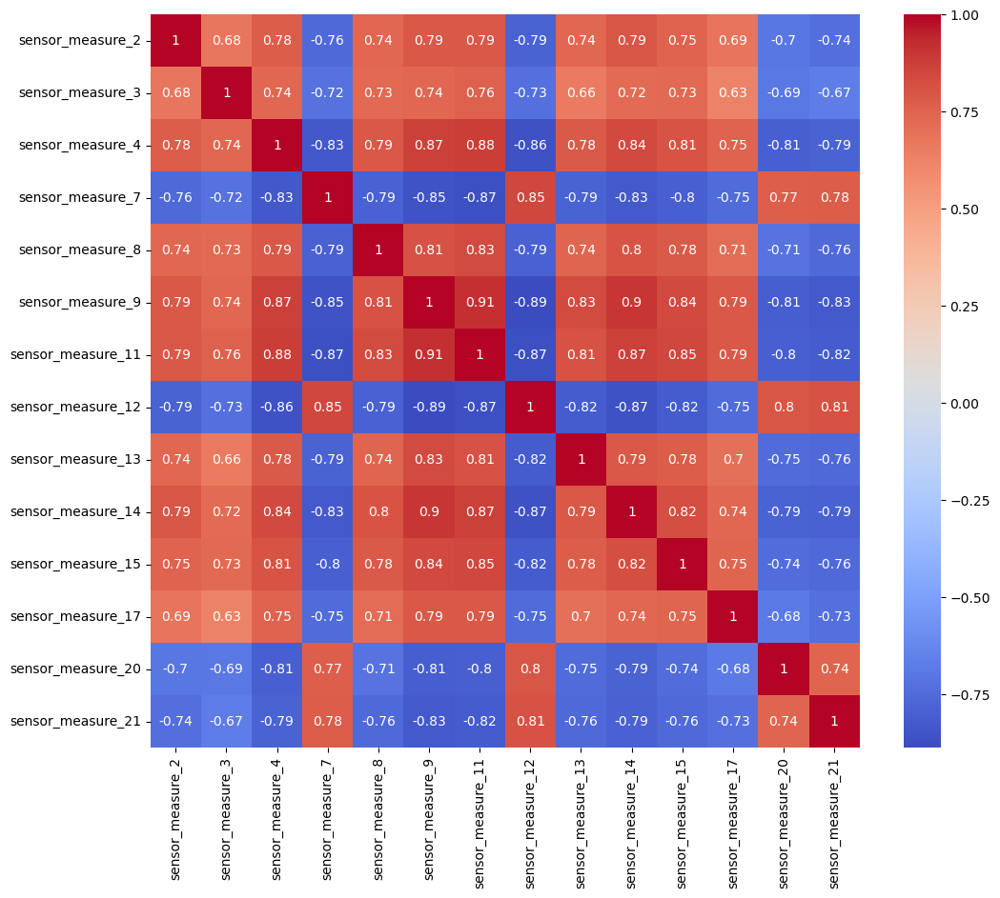

In [29]:
# Compare with single motor unit
plt.figure(figsize=(12,10))
unit_id = 2
unit_df = turbine1_train[turbine1_train['unit_number'] == unit_id]
# Calculate the correlation matrix for a single unit
corr_unit = unit_df[sensor_names].corr()
sns.heatmap(corr_unit,annot=True, cmap = 'coolwarm')
plt.show()

In [30]:
unit_df.corr()['RUL'].sort_values(ascending=False)

RUL                      1.000000
sensor_measure_12        0.825149
sensor_measure_7         0.803818
sensor_measure_21        0.779092
sensor_measure_20        0.767857
operational_setting_1    0.077614
operational_setting_2    0.000566
sensor_measure_17       -0.727412
sensor_measure_3        -0.734746
sensor_measure_8        -0.783505
sensor_measure_2        -0.786519
sensor_measure_14       -0.793333
sensor_measure_13       -0.802666
sensor_measure_15       -0.805365
sensor_measure_4        -0.830417
sensor_measure_9        -0.834042
sensor_measure_11       -0.854874
cycle                   -1.000000
unit_number                   NaN
Name: RUL, dtype: float64

In [31]:
# Get the high correlation pairs
high_corr_pairs = get_high_correlation_pairs(corr_unit, threshold=0.8)

# Output the list of high correlation pairs
print("High correlation pairs (correlation > 0.8):")
for sensor1, sensor2, corr_value in high_corr_pairs:
    print(f"{sensor1} and {sensor2}: {corr_value:.2f}")

High correlation pairs (correlation > 0.8):
sensor_measure_4 and sensor_measure_7: -0.83
sensor_measure_4 and sensor_measure_9: 0.87
sensor_measure_4 and sensor_measure_11: 0.88
sensor_measure_4 and sensor_measure_12: -0.86
sensor_measure_4 and sensor_measure_14: 0.84
sensor_measure_4 and sensor_measure_15: 0.81
sensor_measure_4 and sensor_measure_20: -0.81
sensor_measure_7 and sensor_measure_9: -0.85
sensor_measure_7 and sensor_measure_11: -0.87
sensor_measure_7 and sensor_measure_12: 0.85
sensor_measure_7 and sensor_measure_14: -0.83
sensor_measure_8 and sensor_measure_9: 0.81
sensor_measure_8 and sensor_measure_11: 0.83
sensor_measure_8 and sensor_measure_14: 0.80
sensor_measure_9 and sensor_measure_11: 0.91
sensor_measure_9 and sensor_measure_12: -0.89
sensor_measure_9 and sensor_measure_13: 0.83
sensor_measure_9 and sensor_measure_14: 0.90
sensor_measure_9 and sensor_measure_15: 0.84
sensor_measure_9 and sensor_measure_20: -0.81
sensor_measure_9 and sensor_measure_21: -0.83
sensor

The pairwise correlation of different sensors seems to be different when looking at different motor units

#### 1.1.5 Time and Distributions Plots

In [32]:
def plot_features(df, feature_name):
    plt.figure(figsize=(13,5))
    for i in df['unit_number'].unique():
        if (i % 10 == 0):  # only plot every 10th unit_number
            plt.plot('RUL', feature_name, 
                     data=df[df['unit_number']==i])
    plt.xlim(250, 0)  # reverse the x-axis so RUL counts down to zero
    plt.xticks(np.arange(0, 275, 25))
    plt.ylabel(feature_name)
    plt.xlabel('RUL')

    
    plt.show()

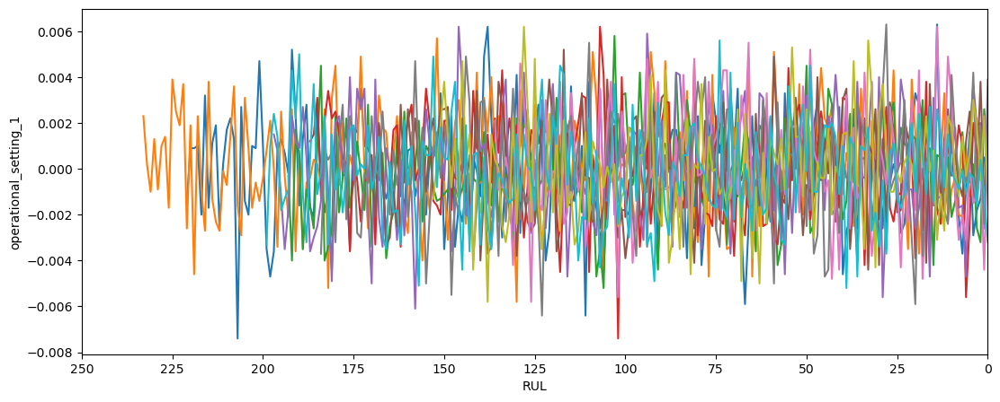

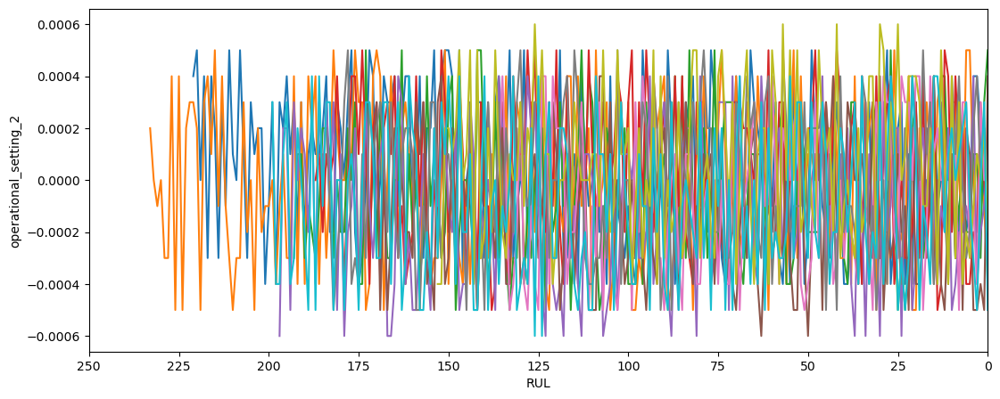

In [33]:
plot_features(turbine1_train, 'operational_setting_1')
plot_features(turbine1_train, 'operational_setting_2')

The sensor settings show no trend  but seem to flucutate between  the same a minimum and maximum value for all units, maybe due to noise.

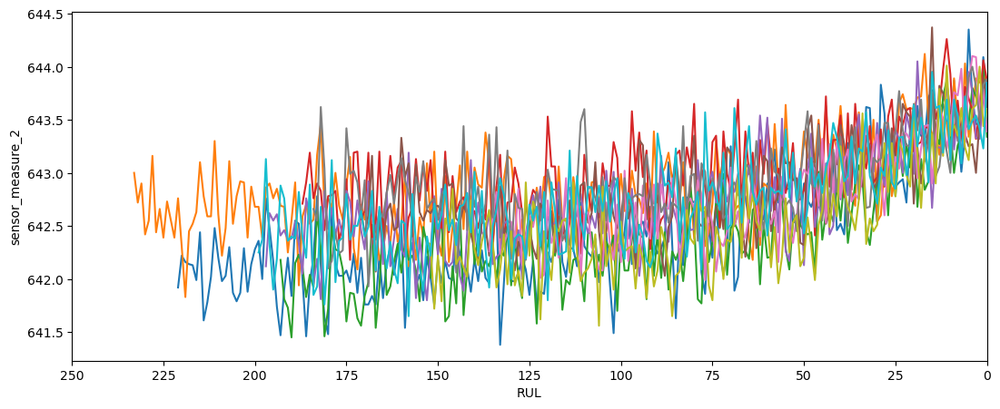

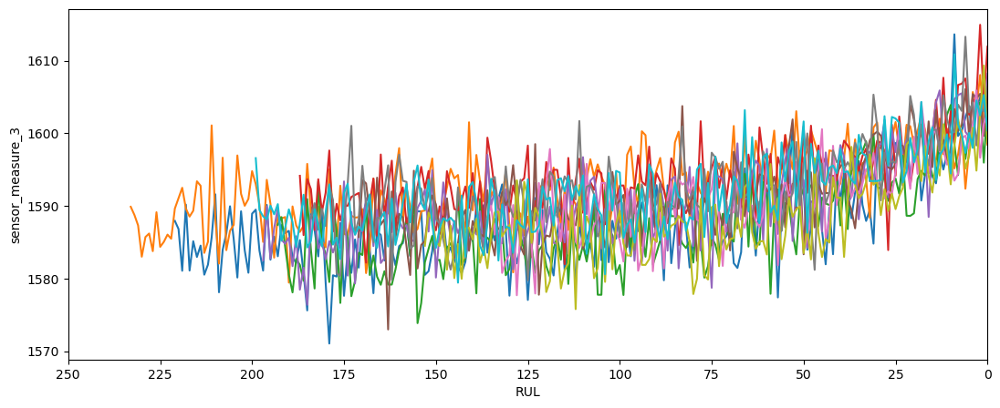

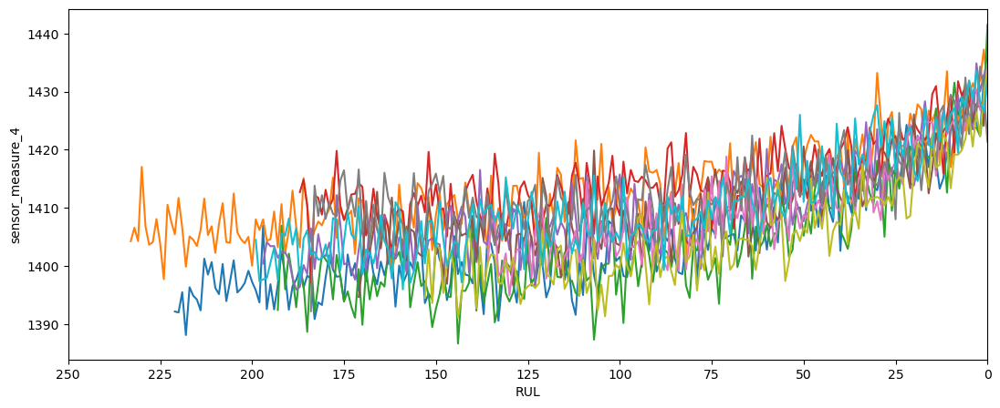

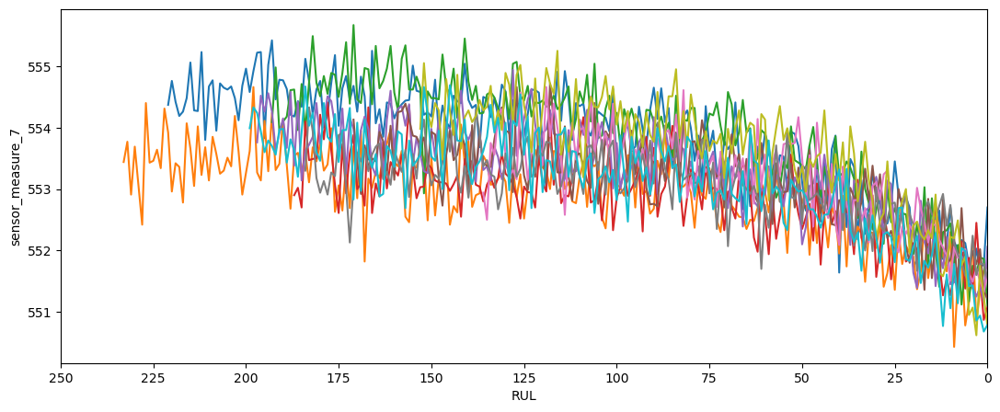

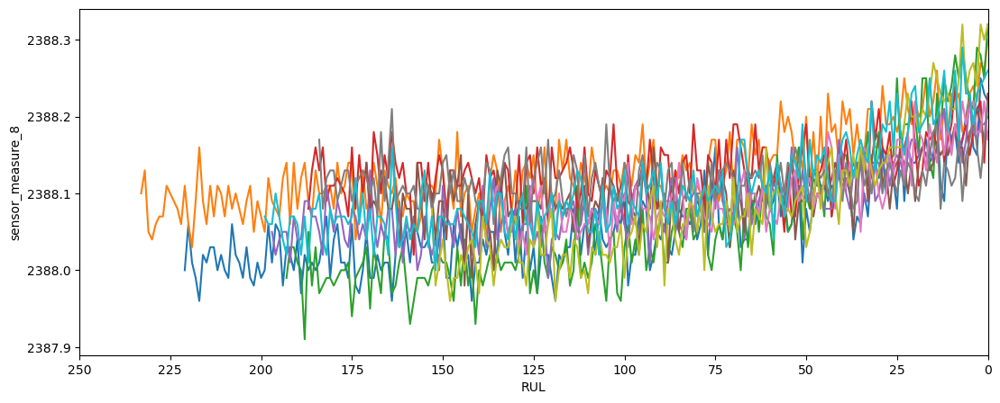

...

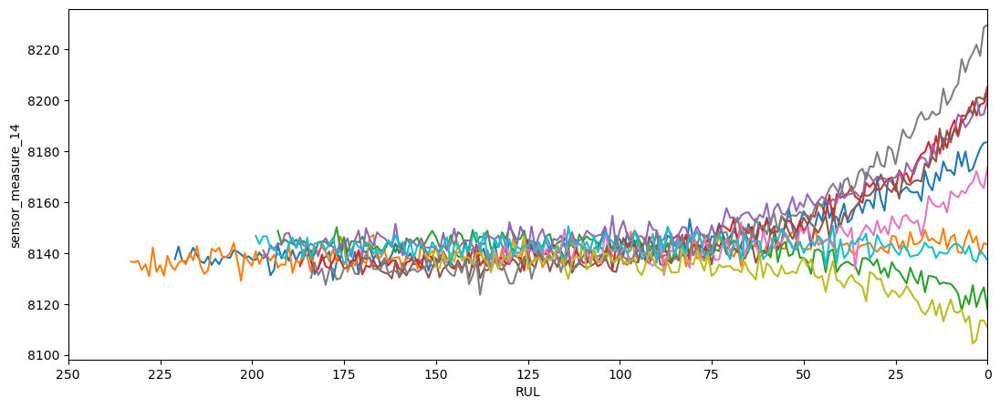

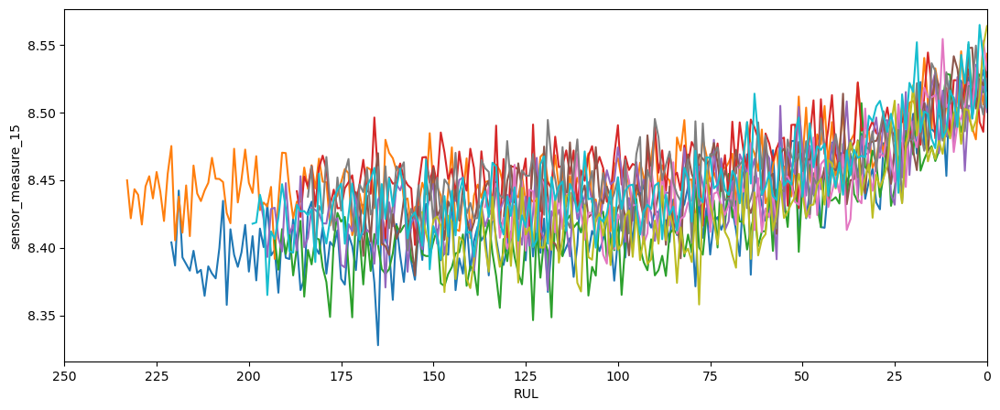

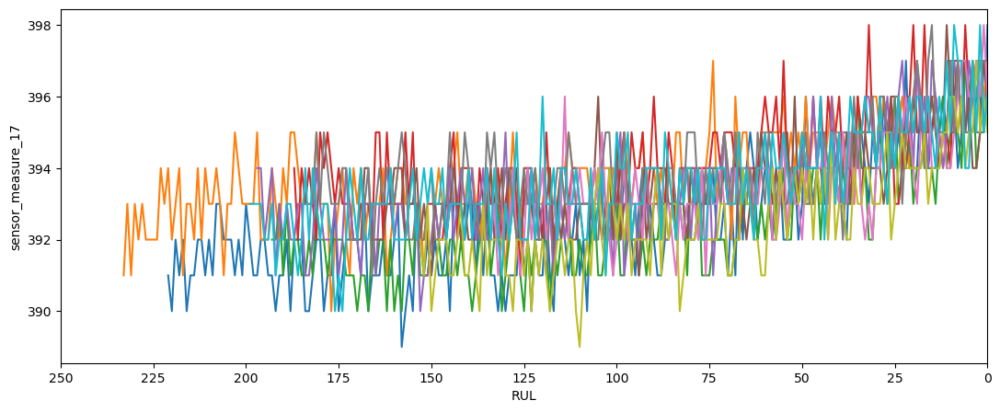

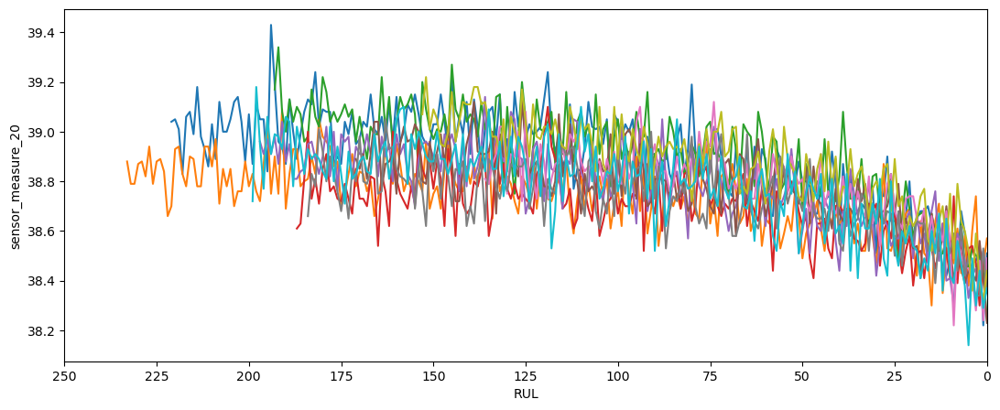

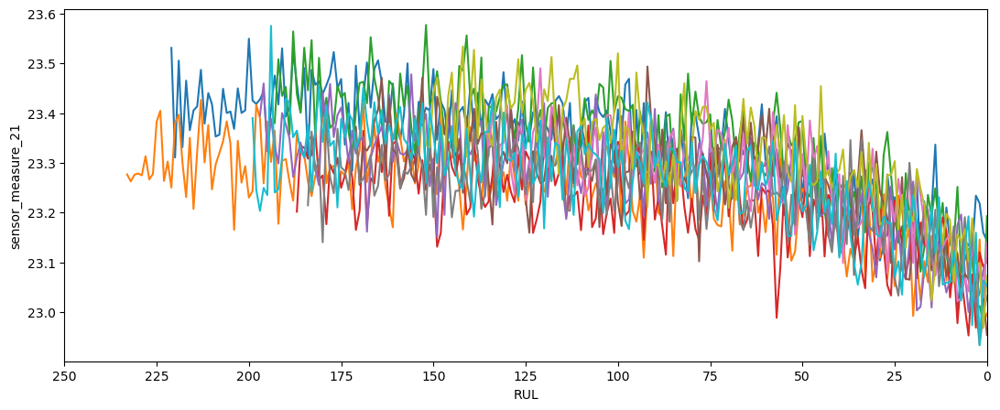

In [34]:
for sensor_name in sensor_names:
    plot_features(turbine1_train, sensor_name)

The minimum max_cycle (operating time) is 128. When passing this threshold, the sensor show a strong trend toward end of lifetime and therefore a correlation to RUL.

Mostly it's either an increasing or decreasing trends. For sensor_14 and sensor_9 the type  and strength of trend depends on the motor unit. Notable is that they also had the highest pairwise correlation. Removing variables that do now show a single trend (sensor_14, sensor_9 and settings) could therefore be considered as candidates for removal.

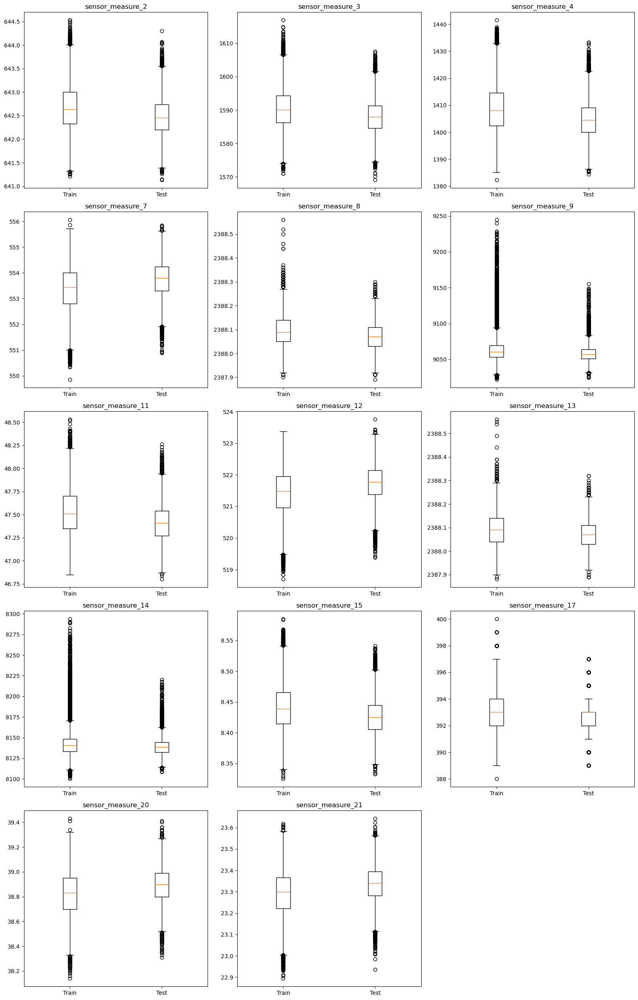

In [35]:
# Calculate the number of rows needed
num_rows = len(sensor_names) // 3
if len(sensor_names) % 3 != 0:
    num_rows += 1

fig, axes = plt.subplots(num_rows, 3, figsize=(16, 5 * num_rows))
axes = axes.flatten()

# Plot each sensor's boxplot for both train and test datasets
for i, sensor in enumerate(sensor_names):
    ax = axes[i]
    ax.boxplot([turbine1_train[sensor], turbine1_test[sensor]], labels=['Train', 'Test'])
    ax.set_title(sensor)
    ax.set_xticklabels(['Train', 'Test'])

# Hide empty subplots
for i in range(len(sensor_names), num_rows * 3):
    axes[i].axis('off')

plt.tight_layout()
plt.show()

#### 1.1.6 Stationary

Stationarity means that statistical features such as mean, variance, and correlation remain consistent over time and are not time-dependent. Some models assume stationarity of data, therefore it is important to check stationarity. This  involves examining trends, seasonality, and other patterns in the time series data. This can be done e.g. by examining the plots.
- Trends: increasing or decreasing values
- seasonality: repeating short-term cycle

Another way to stastically test is the Augmented Dickey-Fuller test which is called a unit root test.
- p-value > 0.05: Fail to reject the null hypothesis (H0), the data has a unit root and is non-stationary.
- p-value <= 0.05: Reject the null hypothesis (H0), the data does not have a unit root and is stationary.

https://himani-gulati.medium.com/time-series-analysis-data-exploration-and-visualization-9dbede5cbb8d

If data is found to be non-stationary, it may require preprocessing steps such as differencing or detrending to achieve stationarity.  This ensures that the time series data is in a suitable form for accurate autocorrelation assessment. Also some models assume stationarity in data (e.g. ARIMA, SARIMA) while others don't require stationarity (e.g. Random Forest, Regression, Gradient Boost, and Neural Networks.
- Differencing: Subtracting the previous value from the current value to remove trends.
- Detrending: Removing trends using regression techniques.

**However, for predicting  the RUL the trend is a key feature, so differencing removes essential information.**

In [36]:
# Create an empty DataFrame to store ADF test results
adf_results = None

# Group data by 'unit_number'
grouped = turbine1_train.groupby('unit_number')

# Iterate over each group (unit)
for unit, data in grouped:
    # Iterate over each sensor column
    for sensor_col in sensor_names: 
        # Perform ADF test for the sensor time series
        adf_statistic, p_value, _, _, critical_values, _ = adfuller(data[sensor_col])
        # Store ADF test results in the DataFrame
        new_df = pd.DataFrame({'Unit': unit, 'Sensor': sensor_col,  'ADF Statistic':  adf_statistic, 'p-value': p_value,  'Critical Value 1%': critical_values['1%'],  'Critical Value 5%': critical_values['5%'],  'Critical Value 10%': critical_values['10%'] }, index=[0]) 
        adf_results = new_df if adf_results is None else pd.concat([adf_results, new_df], ignore_index=True)

# Print or display the DataFrame
adf_results

,Unit,Sensor,ADF Statistic,p-value,Critical Value 1%,Critical Value 5%,Critical Value 10%
0,1,sensor_measure_2,0.402073,9.815723e-01,-3.466598,-2.877467,-2.575260
1,1,sensor_measure_3,0.517922,9.854078e-01,-3.467420,-2.877826,-2.575452
2,1,sensor_measure_4,0.726047,9.903436e-01,-3.466201,-2.877293,-2.575168
3,1,sensor_measure_7,1.844073,9.984325e-01,-3.467845,-2.878012,-2.575551
4,1,sensor_measure_8,2.798889,1.000000e+00,-3.467211,-2.877735,-2.575403
...,...,...,...,...,...,...,...
1395,100,sensor_measure_14,-14.284543,1.306691e-26,-3.463645,-2.876176,-2.574572
1396,100,sensor_measure_15,0.642744,9.886232e-01,-3.465244,-2.876875,-2.574945
1397,100,sensor_measure_17,0.326957,9.785480e-01,-3.465812,-2.877123,-2.575077
1398,100,sensor_measure_20,0.593698,9.874593e-01,-3.464694,-2.876635,-2.574816


In [37]:
(adf_results['p-value'] <= 0.05).sum()

46

46 of 1400 time series are stationary, so most of them are non-stationary.

#### 1.1.7 Difference

In [38]:
for sensor in sensor_names:
    turbine1_train[sensor + '_diff'] = turbine1_train[sensor] - turbine1_train[sensor].shift(1) # same as turbine1_train[sensor + '_diff'] = turbine1_train[sensor].diff()?
turbine1_train.dropna(inplace=True)  # Drop NaN values introduced by differencing
turbine1_train.head()

,unit_number,cycle,operational_setting_1,operational_setting_2,sensor_measure_2,sensor_measure_3,sensor_measure_4,sensor_measure_7,sensor_measure_8,sensor_measure_9,...,sensor_measure_8_diff,sensor_measure_9_diff,sensor_measure_11_diff,sensor_measure_12_diff,sensor_measure_13_diff,sensor_measure_14_diff,sensor_measure_15_diff,sensor_measure_17_diff,sensor_measure_20_diff,sensor_measure_21_diff
1,1,2,0.0019,-0.0003,642.15,1591.82,1403.14,553.75,2388.04,9044.07,...,-0.02,-2.12,0.02,0.62,0.05,-7.13,0.0123,0.0,-0.06,0.0046
2,1,3,-0.0043,0.0003,642.35,1587.99,1404.20,554.26,2388.08,9052.94,...,0.04,8.87,-0.22,0.14,-0.04,1.74,-0.0140,-2.0,-0.05,-0.0794
3,1,4,0.0007,0.0000,642.35,1582.79,1401.87,554.45,2388.11,9049.48,...,0.03,-3.46,-0.14,0.44,0.05,0.60,-0.0496,2.0,-0.07,0.0297
4,1,5,-0.0019,-0.0002,642.37,1582.85,1406.22,554.00,2388.06,9055.15,...,-0.05,5.67,0.15,-0.67,-0.04,-0.03,0.0612,1.0,0.02,0.0305
5,1,6,-0.0043,-0.0001,642.10,1584.47,1398.37,554.67,2388.02,9049.68,...,-0.04,-5.47,-0.12,-0.51,-0.01,-0.95,-0.0186,-2.0,0.08,-0.0375


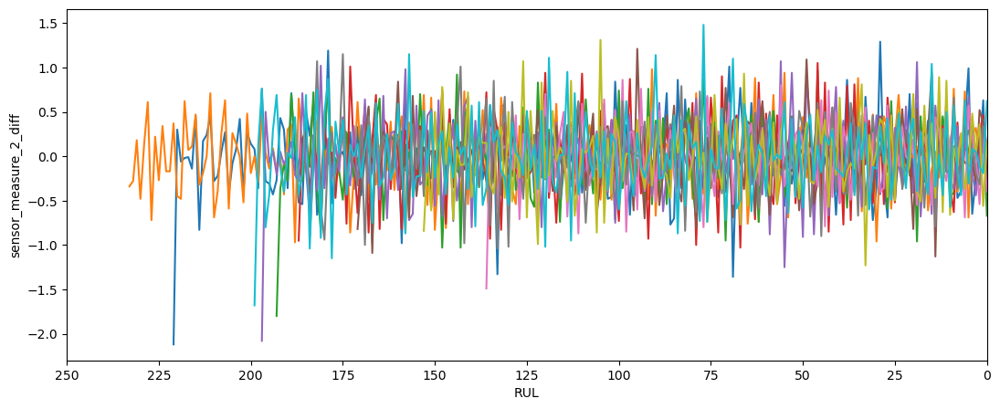

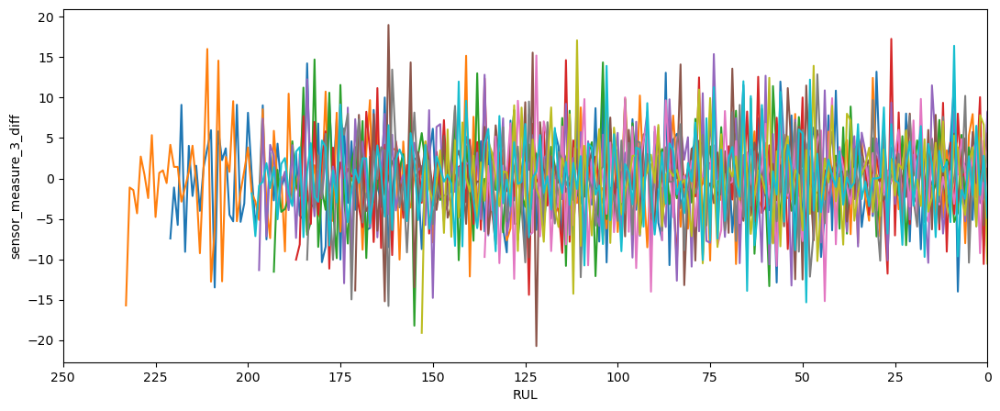

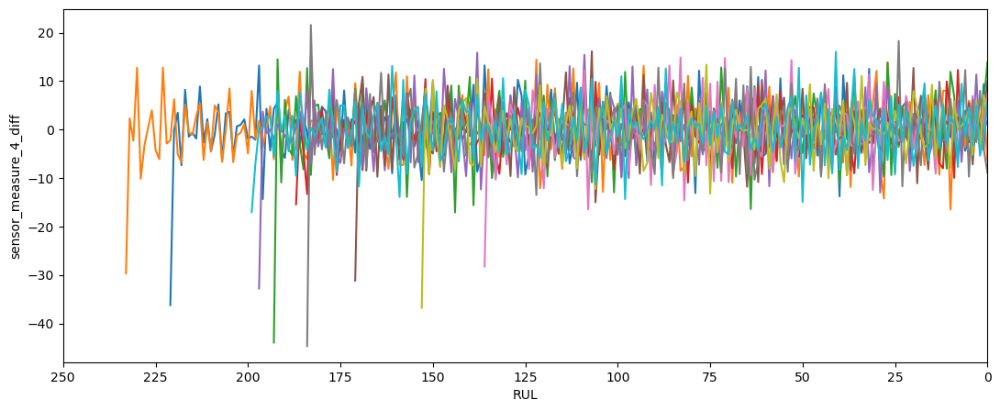

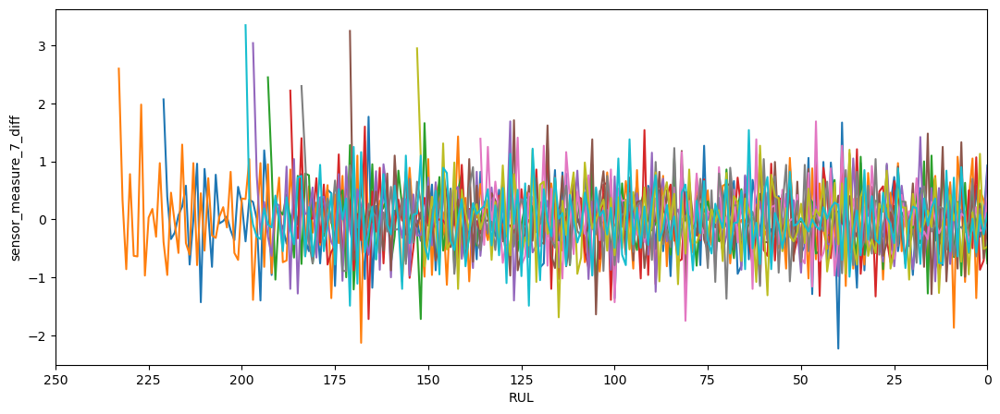

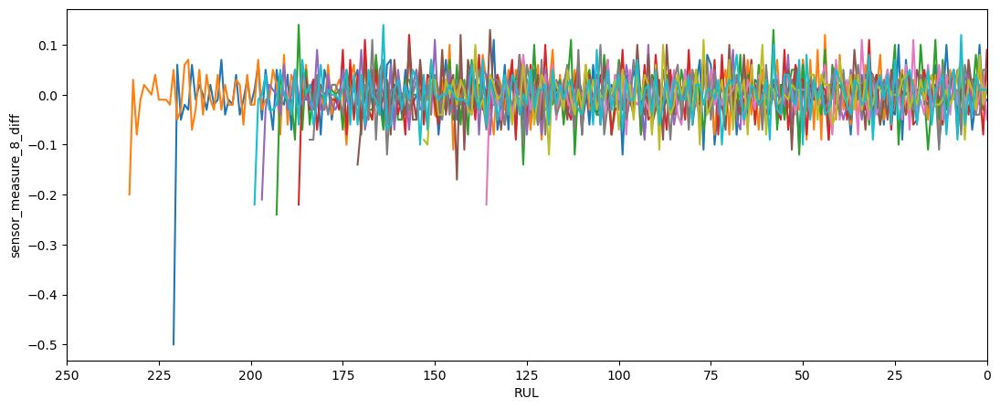

...

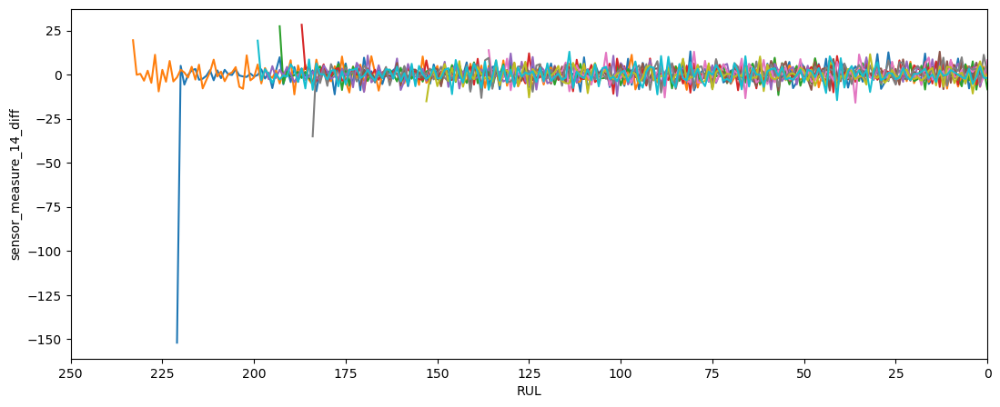

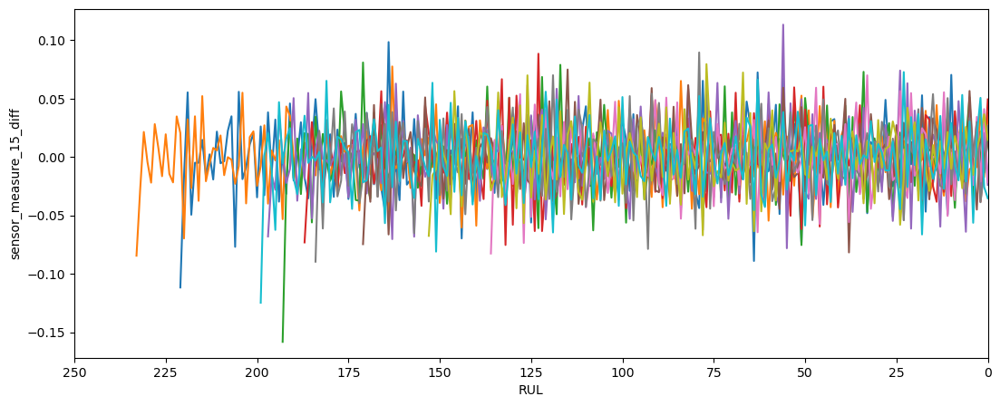

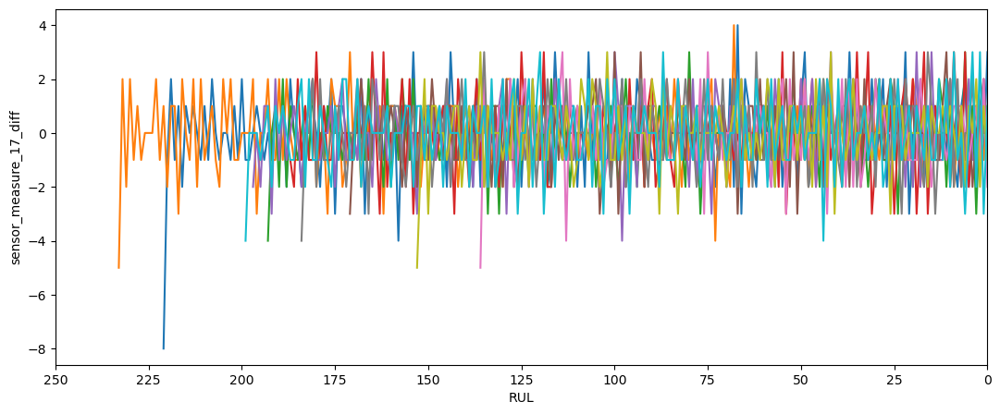

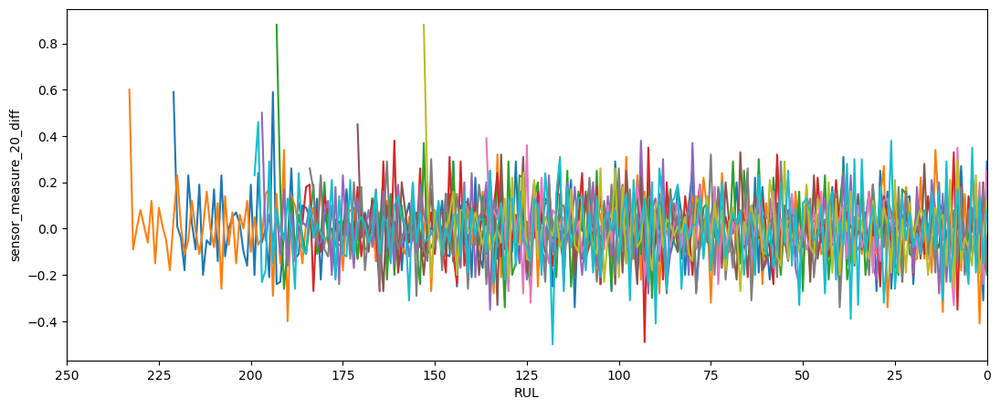

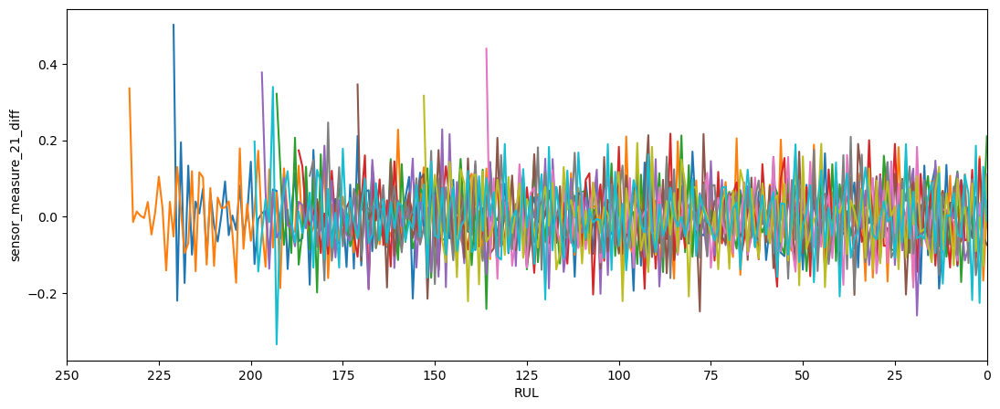

In [39]:
for sensor_name in sensor_names:
        plot_features(turbine1_train, sensor_name + '_diff')

#### 1.1.8 Autocorrelation

Auto-correlation measures the correlation between a time series and its lagged values (previous time steps), revealing how each observation in the series is related to its past observation.
Partial Autocorellation  measures the correlation between a time series and specific lagged values without taking effect of intermediate lags into account.
Both provide insights into the underlying structure of the data and help identify potential patterns and relationships, which helps to select the right model.
between an observation and its previous observations at a specific lag, excluding the contributions from intermediate lags.
In the plots the spikes indicate the degree of correlation between the time series and its lagged values
- Look for significant spikes outside the blue confidence intervals (autocorrelation is unlikely to be due to random noise)
- ACF plot: identify patterns (slow decay suggests non-stationarity, cutoff suggests stationarity)
- PACF plot:  cut-off pattern can help determine the order of an autoregressive (AR) process (sharp cut-off after lag p suggests an AR(p) process)

Autocorellation and Partial Correlation for sensors of motor unit  40


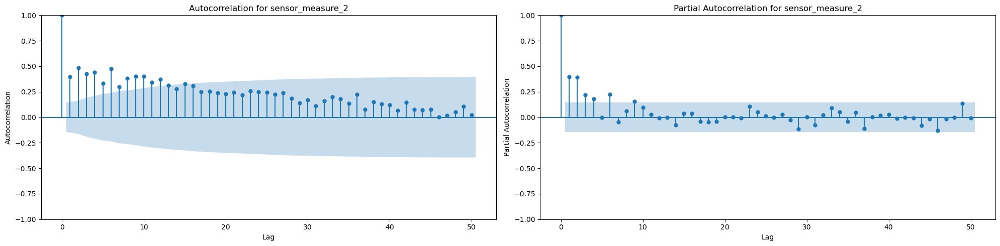

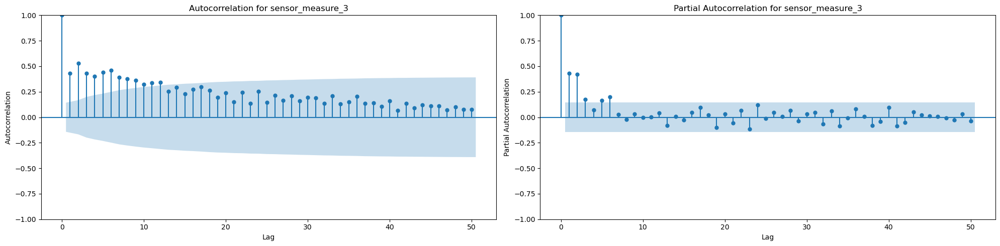

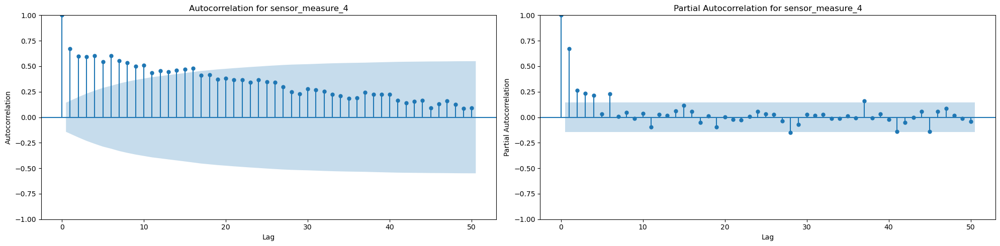

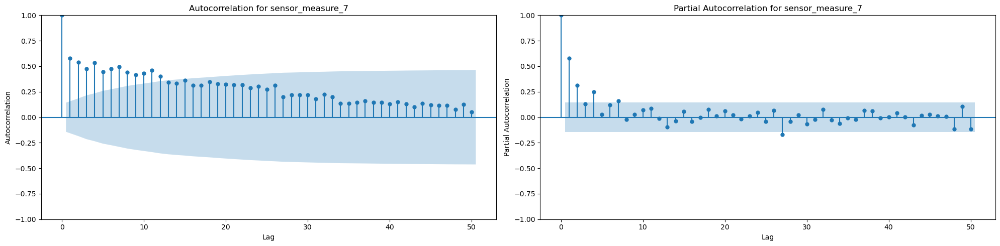

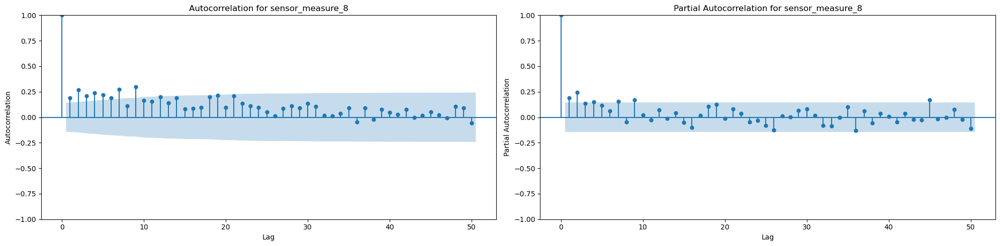

...

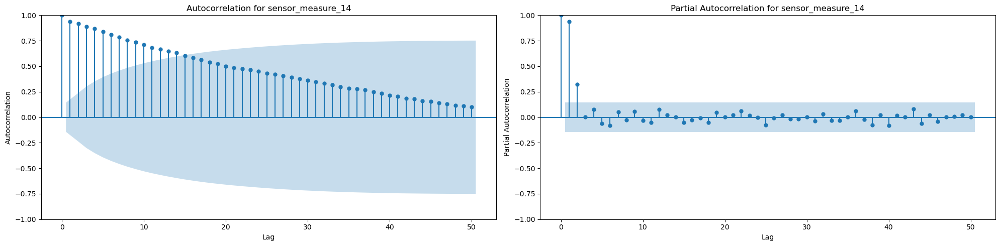

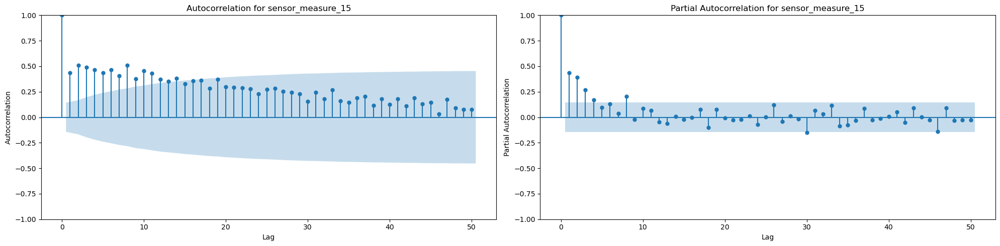

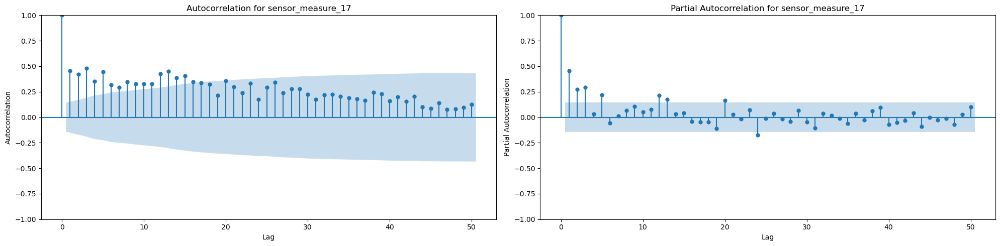

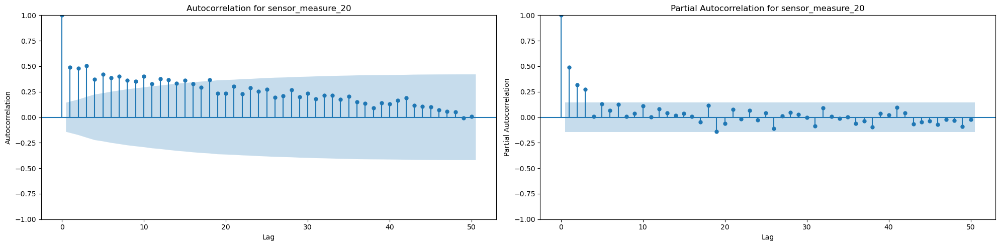

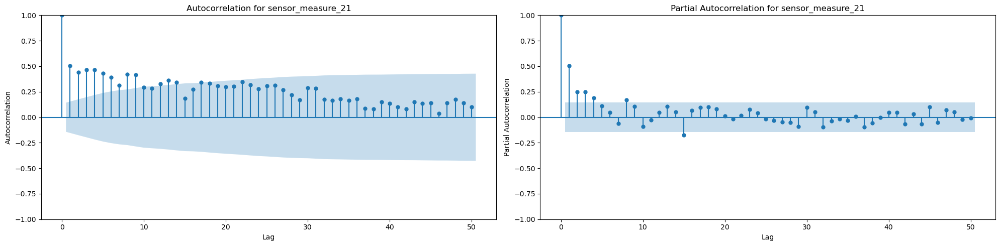

In [40]:
grouped = turbine1_train.groupby('unit_number')

for unit, data in grouped:
    if unit == 40: # show just for one unit
        print("Autocorellation and Partial Correlation for sensors of motor unit ", unit)
            
        for sensor in sensor_names:
            fig, axes = plt.subplots(1, 2, figsize=(20, 5))
            sensor = sensor
            
            # ACF plot
            plot_acf(data[sensor], lags=50, ax=axes[0])
            axes[0].set_title(f'Autocorrelation for {sensor}')
            axes[0].set_xlabel('Lag')
            axes[0].set_ylabel('Autocorrelation')
            
            # PACF plot
            plot_pacf(data[sensor], lags=50, ax=axes[1])
            axes[1].set_title(f'Partial Autocorrelation for {sensor}')
            axes[1].set_xlabel('Lag')
            axes[1].set_ylabel('Partial Autocorrelation')
            
            # Adjust layout to prevent overlap
            plt.tight_layout()
            plt.show()

- ACF plot:slow decay, sifnicant correlation to lags until around lag 10-13
- PCF plot: sharp cutoff at around 1-2 lags

#### 1.1.9 Seasonal Decomposition

Seasonality: recurring patterns or fluctuations that exhibit regularity at fixed intervals over time.

tested for one sensor and one unit

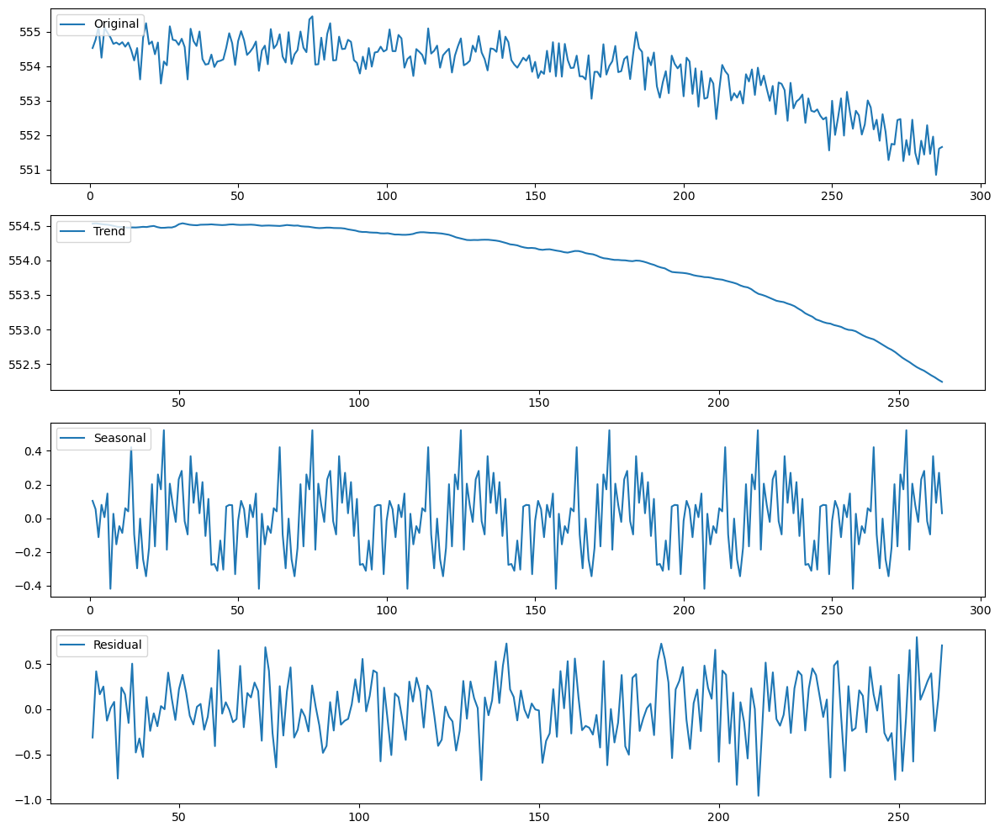

In [41]:
unit_df = turbine1_train[turbine1_train['unit_number'] == unit_id]

# Decompose time series into trend, seasonal, and residual components
decomposition = sm.tsa.seasonal_decompose(unit_df['sensor_measure_7'], period=50)  # Adjust period as needed
trend = decomposition.trend
seasonal = decomposition.seasonal
residual = decomposition.resid

# Plot decomposed components
plt.figure(figsize=(12, 10))

plt.subplot(411)
plt.plot(unit_df['cycle'], unit_df['sensor_measure_7'], label='Original')
plt.legend(loc='upper left')

plt.subplot(412)
plt.plot(unit_df['cycle'], trend, label='Trend')
plt.legend(loc='upper left')

plt.subplot(413)
plt.plot(unit_df['cycle'], seasonal, label='Seasonal')
plt.legend(loc='upper left')

plt.subplot(414)
plt.plot(unit_df['cycle'], residual, label='Residual')
plt.legend(loc='upper left')

plt.tight_layout()
plt.show()

Observing some examples for unit ans sensor there seems to be some seasonality and fluctuations at regular patterns. Therefore, it might be helpful to remove seasonality, e.g. through Moving Average Smoothing with size of season interval to smooth out data  and better analyze the underlying trend.

### 1.2 Turbine 2

#### 1.2.1 Data inspection

In [42]:
# Printing number of rows and columns
print(f"Train set -> Number of rows: {turbine2_train.shape[0]}, Number of columns: {turbine2_train.shape[1]}")
print(f"Test set -> Number of rows: {turbine2_test.shape[0]}, Number of columns: {turbine2_test.shape[1]}")

Train set -> Number of rows: 53759, Number of columns: 27
Test set -> Number of rows: 33991, Number of columns: 26


In [43]:
print(turbine2_train.info(), turbine2_test.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53759 entries, 0 to 53758
Data columns (total 27 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   unit_number            53759 non-null  int64  
 1   cycle                  53759 non-null  int64  
 2   operational_setting_1  53759 non-null  float64
 3   operational_setting_2  53759 non-null  float64
 4   operational_setting_3  53759 non-null  float64
 5   sensor_measure_1       53759 non-null  float64
 6   sensor_measure_2       53759 non-null  float64
 7   sensor_measure_3       53759 non-null  float64
 8   sensor_measure_4       53759 non-null  float64
 9   sensor_measure_5       53759 non-null  float64
 10  sensor_measure_6       53759 non-null  float64
 11  sensor_measure_7       53759 non-null  float64
 12  sensor_measure_8       53759 non-null  float64
 13  sensor_measure_9       53759 non-null  float64
 14  sensor_measure_10      53759 non-null  float64
 15  se

Let's check for missing values:

In [44]:
print(turbine2_train.isnull().sum(), turbine2_test.isnull().sum())

unit_number              0
cycle                    0
operational_setting_1    0
operational_setting_2    0
operational_setting_3    0
sensor_measure_1         0
sensor_measure_2         0
sensor_measure_3         0
sensor_measure_4         0
sensor_measure_5         0
sensor_measure_6         0
sensor_measure_7         0
sensor_measure_8         0
sensor_measure_9         0
sensor_measure_10        0
sensor_measure_11        0
sensor_measure_12        0
sensor_measure_13        0
sensor_measure_14        0
sensor_measure_15        0
sensor_measure_16        0
sensor_measure_17        0
sensor_measure_18        0
sensor_measure_19        0
sensor_measure_20        0
sensor_measure_21        0
RUL                      0
dtype: int64 unit_number              0
cycle                    0
operational_setting_1    0
operational_setting_2    0
operational_setting_3    0
sensor_measure_1         0
sensor_measure_2         0
sensor_measure_3         0
sensor_measure_4         0
sensor_measure_

-> We don't have any missing values, great!

In [45]:
# Statistical overview
turbine2_train.describe()

,unit_number,cycle,operational_setting_1,operational_setting_2,operational_setting_3,sensor_measure_1,sensor_measure_2,sensor_measure_3,sensor_measure_4,sensor_measure_5,...,sensor_measure_13,sensor_measure_14,sensor_measure_15,sensor_measure_16,sensor_measure_17,sensor_measure_18,sensor_measure_19,sensor_measure_20,sensor_measure_21,RUL
count,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,...,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000
mean,131.082981,109.154746,23.998407,0.572056,94.046020,472.910207,579.672399,1419.971013,1205.442024,8.031986,...,2334.557253,8066.597682,9.329654,0.023326,348.309511,2228.806358,97.756838,20.789296,12.473423,108.154746
std,74.463862,69.180569,14.747376,0.310016,14.237735,26.389707,37.289399,105.946341,119.123428,3.613839,...,128.068271,84.837950,0.749335,0.004711,27.754515,145.327980,5.364067,9.869331,5.921615,69.180569
min,1.000000,1.000000,0.000000,0.000000,60.000000,445.000000,535.530000,1243.730000,1023.770000,3.910000,...,2027.610000,7848.360000,8.335700,0.020000,303.000000,1915.000000,84.930000,10.180000,6.010500,0.000000
25%,68.000000,52.000000,10.004600,0.250700,100.000000,445.000000,549.570000,1352.760000,1123.655000,3.910000,...,2387.900000,8062.140000,8.677800,0.020000,331.000000,2212.000000,100.000000,10.910000,6.546300,51.000000
50%,131.000000,104.000000,25.001300,0.700000,100.000000,462.540000,555.980000,1369.180000,1138.890000,7.050000,...,2388.080000,8082.540000,9.310900,0.020000,335.000000,2223.000000,100.000000,14.880000,8.929200,103.000000
75%,195.000000,157.000000,41.998000,0.840000,100.000000,491.190000,607.340000,1499.370000,1306.850000,10.520000,...,2388.170000,8127.195000,9.386900,0.030000,369.000000,2324.000000,100.000000,28.470000,17.083200,156.000000
max,260.000000,378.000000,42.008000,0.842000,100.000000,518.670000,644.520000,1612.880000,1439.230000,14.620000,...,2390.480000,8268.500000,11.066900,0.030000,399.000000,2388.000000,100.000000,39.340000,23.590100,377.000000


In the following, we will plot the number of engines we have in each data set. 

In [46]:
unit = turbine2_train["unit_number"].unique()
print("In den Trainingsdaten sind {} Turbofan-Motor enthalten.".format(len(unit)))

unit = turbine2_test["unit_number"].unique()
print("In den Testdaten sind {} Turbofan-Motor enthalten.".format(len(unit)))

In den Trainingsdaten sind 260 Turbofan-Motor enthalten.
In den Testdaten sind 259 Turbofan-Motor enthalten.


Let's now see how often each number of cycles is represented in our datasets.

#### 1.2.2 Feature distributions

Let's now see how often each number of cycles is represented in our datasets.

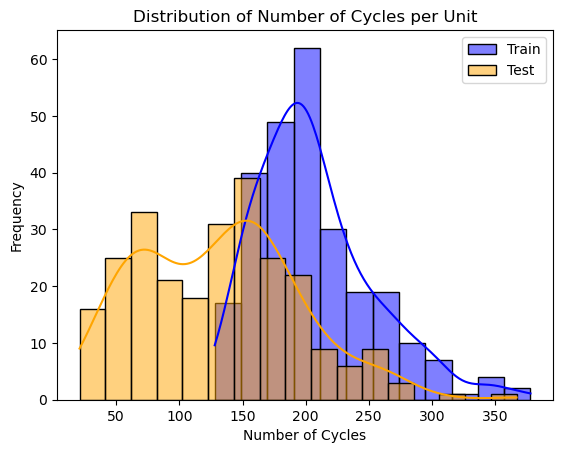

In [47]:
sns.histplot(data=turbine2_train.groupby('unit_number')['cycle'].max(), binwidth=20, kde=True, color='blue', label='Train')
sns.histplot(data=turbine2_test.groupby('unit_number')['cycle'].max(), binwidth=20, kde=True, color='orange', label='Test')

# Setting title and axes
plt.title('Distribution of Number of Cycles per Unit')
plt.xlabel("Number of Cycles")  
plt.ylabel("Frequency")             

plt.legend()

plt.show()

It appears that the test set has a bimodal distribution whereas the train set is unimodal.

#### 1.2.3 Correlation

Now, let's have a look on the correlation map for the individual features.

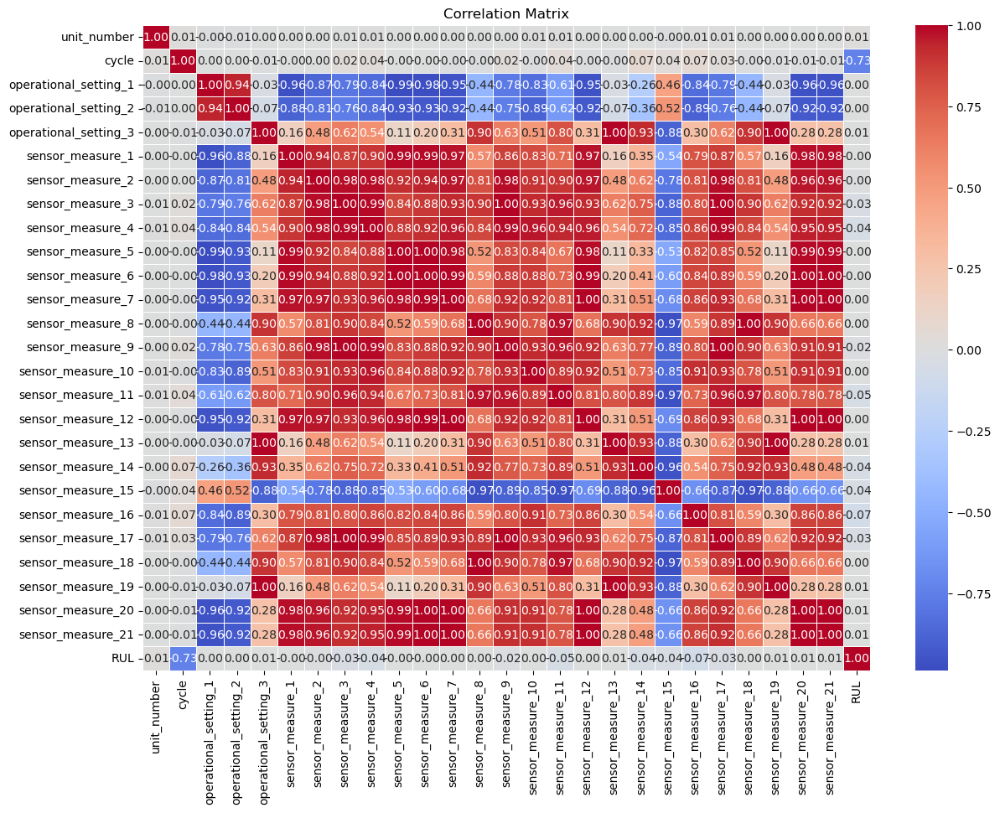

In [48]:
# Correlation heatmap
plt.figure(figsize=(14, 10))
corr_matrix = turbine2_train.corr()
sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap="coolwarm", linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

In [49]:
# Calculate the correlation matrix
correlation_matrix = turbine2_train.corr()

# Convert the correlation matrix to absolute values
abs_correlation_matrix = correlation_matrix.abs()

# Unstack the correlation matrix and sort by absolute value
sorted_correlation = abs_correlation_matrix.unstack().sort_values(ascending=False)

# Drop duplicate pairs
sorted_correlation = sorted_correlation[sorted_correlation.index.get_level_values(0) != sorted_correlation.index.get_level_values(1)]

# Drop the duplicate rows by keeping the first occurrence
sorted_correlation = sorted_correlation[~sorted_correlation.index.duplicated(keep='first')]

sorted_correlation

sorted_correlation_df = sorted_correlation.reset_index()
sorted_correlation_df.columns = ['Feature1', 'Feature2', 'Correlation']

sorted_correlation_df

,Feature1,Feature2,Correlation
0,sensor_measure_19,operational_setting_3,1.000000
1,operational_setting_3,sensor_measure_19,1.000000
2,sensor_measure_18,sensor_measure_8,0.999999
3,sensor_measure_8,sensor_measure_18,0.999999
4,sensor_measure_13,operational_setting_3,0.999998
...,...,...,...
697,RUL,operational_setting_2,0.000047
698,cycle,operational_setting_1,0.000039
699,operational_setting_1,cycle,0.000039
700,sensor_measure_1,RUL,0.000023


In [50]:
# Plot correlations as a table
sorted_correlation_df = sorted_correlation_df.iloc[::2].reset_index(drop=True)
# Filter the DataFrame to include only rows where the absolute value of the correlation is greater than 0.99
sorted_correlation_df = sorted_correlation_df[sorted_correlation_df['Correlation'] > 0.99]

sorted_correlation_df

,Feature1,Feature2,Correlation
0,sensor_measure_19,operational_setting_3,1.000000
1,sensor_measure_18,sensor_measure_8,0.999999
2,sensor_measure_13,operational_setting_3,0.999998
3,sensor_measure_13,sensor_measure_19,0.999998
4,sensor_measure_12,sensor_measure_7,0.999993
5,sensor_measure_21,sensor_measure_20,0.999898
6,sensor_measure_20,sensor_measure_7,0.999146
7,sensor_measure_7,sensor_measure_21,0.999145
8,sensor_measure_20,sensor_measure_12,0.999087
9,sensor_measure_12,sensor_measure_21,0.999086


We can see that we have a lot of highly correlated features in our dataset. 

In [51]:
motor_id = 1
Dataframe_id = turbine2_train[turbine2_train["unit_number"]==motor_id]
print("Turbofan mit ID {} lief insgesamt {} Zyklen".format(motor_id, Dataframe_id.shape[0]))

Turbofan mit ID 1 lief insgesamt 149 Zyklen


In [52]:
motor_id = 2
Dataframe_id = turbine2_train[turbine2_train["unit_number"]==motor_id]
print("Turbofan mit ID {} lief insgesamt {} Zyklen".format(motor_id, Dataframe_id.shape[0]))

Turbofan mit ID 2 lief insgesamt 269 Zyklen


In [53]:
motor_id = 100
Dataframe_id = turbine2_train[turbine2_train["unit_number"]==motor_id]
Dataframe_id

,unit_number,cycle,operational_setting_1,operational_setting_2,operational_setting_3,sensor_measure_1,sensor_measure_2,sensor_measure_3,sensor_measure_4,sensor_measure_5,...,sensor_measure_13,sensor_measure_14,sensor_measure_15,sensor_measure_16,sensor_measure_17,sensor_measure_18,sensor_measure_19,sensor_measure_20,sensor_measure_21,RUL
19998,100,1,0.0024,0.0014,100.0,518.67,642.85,1593.43,1395.24,14.62,...,2388.01,8146.28,8.3972,0.03,391,2388,100.0,39.04,23.3416,211
19999,100,2,10.0022,0.2518,100.0,489.05,604.91,1496.73,1301.57,10.52,...,2388.07,8134.91,8.6337,0.03,369,2319,100.0,28.55,17.2782,210
20000,100,3,0.0001,0.0000,100.0,518.67,641.91,1592.44,1395.57,14.62,...,2388.03,8153.37,8.4231,0.03,391,2388,100.0,38.95,23.3693,209
20001,100,4,0.0017,0.0017,100.0,518.67,642.11,1587.74,1405.77,14.62,...,2388.00,8147.20,8.4156,0.03,392,2388,100.0,39.00,23.3783,208
20002,100,5,0.0023,0.0000,100.0,518.67,642.20,1586.80,1404.11,14.62,...,2388.07,8145.00,8.4240,0.03,393,2388,100.0,39.00,23.4162,207
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20205,100,208,41.9999,0.8418,100.0,445.00,550.59,1365.59,1140.34,3.91,...,2388.25,8100.95,9.4295,0.02,333,2212,100.0,10.57,6.1784,4
20206,100,209,42.0026,0.8416,100.0,445.00,550.54,1365.38,1136.76,3.91,...,2388.33,8107.96,9.4230,0.02,334,2212,100.0,10.63,6.3221,3
20207,100,210,35.0029,0.8400,100.0,449.44,556.85,1374.10,1148.17,5.48,...,2388.42,8090.64,9.4412,0.02,336,2223,100.0,14.74,8.8036,2
20208,100,211,35.0055,0.8400,100.0,449.44,556.49,1380.26,1151.67,5.48,...,2388.49,8085.25,9.4136,0.02,336,2223,100.0,14.62,8.7448,1


#### 1.2.4 RUL plot

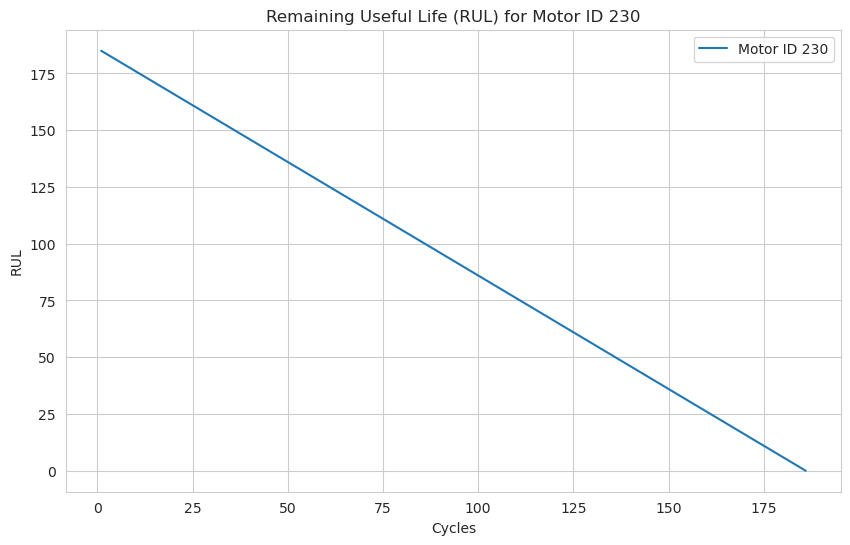

In [54]:
# Example motor ID
motor_id = 230
motor_data = turbine2_train[turbine2_train["unit_number"] == motor_id]

# Set the aesthetic style of the plots
sns.set_style("whitegrid")

# Plot the RUL with "cycles" on the x-axis using Seaborn
plt.figure(figsize=(10, 6))
sns.lineplot(data=motor_data, x="cycle", y="RUL", label=f'Motor ID {motor_id}')
plt.title(f'Remaining Useful Life (RUL) for Motor ID {motor_id}')
plt.xlabel('Cycles')
plt.ylabel('RUL')
plt.legend()
plt.show()

#### 1.2.5 Time and distribution plots

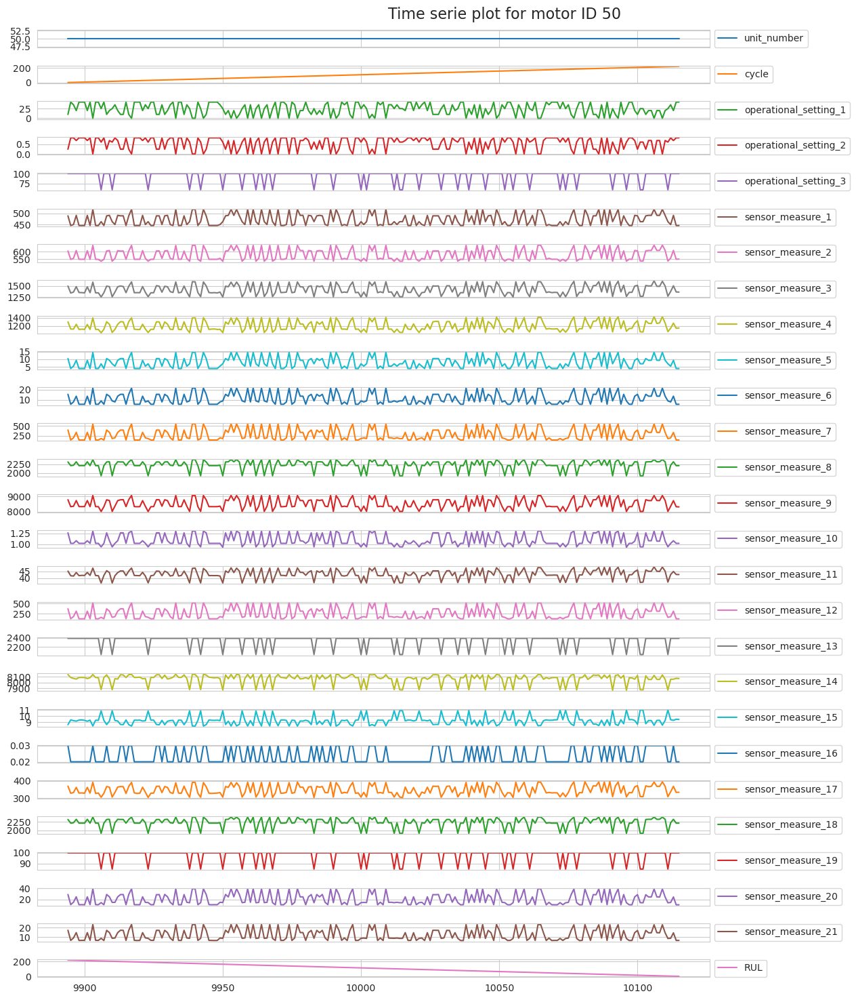

In [55]:
# Plot all sensor data of one motor
motor_id = 50

axes = turbine2_train[turbine2_train['unit_number']==motor_id].plot(subplots=True, figsize=(15, 15))
for ax in axes:
    # Set the legend to be outside the plot on the right
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout(rect=[0, 0, 0.85, 0.97])  # Make room on the right for the legends
plt.suptitle(f'Time serie plot for motor ID {motor_id}', fontsize=16)
plt.show()

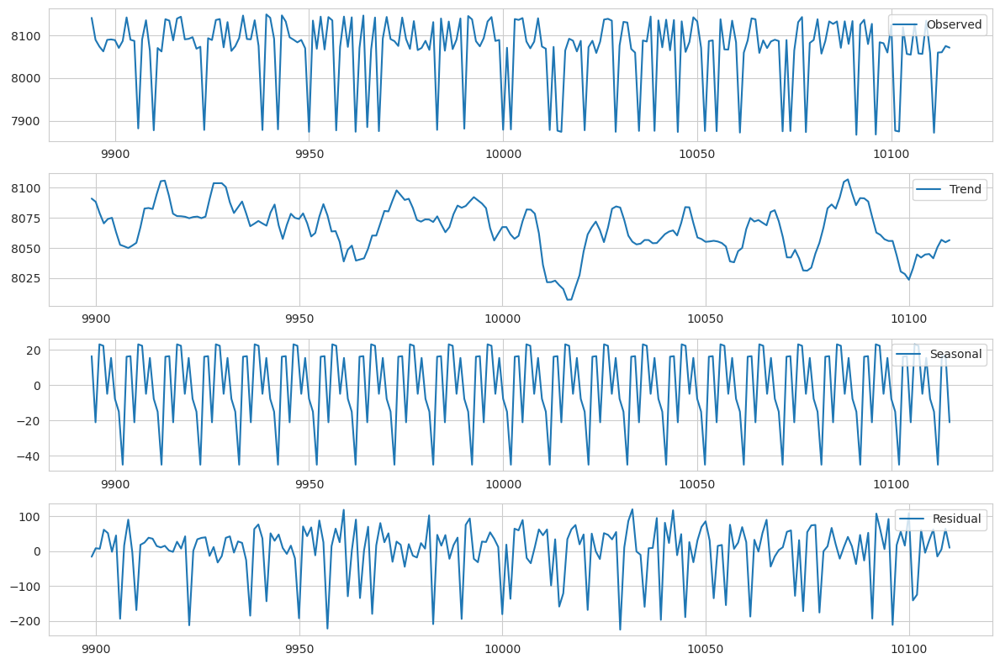

In [56]:
feature = 'sensor_measure_14' #Choose feature to see
motor_id = 50
ts = turbine2_train[turbine2_train['unit_number'] == motor_id][feature]

decomposition = sm.tsa.seasonal_decompose(ts, model='additive', period=10)
# Plot the decomposition components
plt.figure(figsize=(12, 8))

plt.subplot(411)
plt.plot(ts, label='Observed')
plt.legend(loc='upper right')

plt.subplot(412)
plt.plot(decomposition.trend, label='Trend')
plt.legend(loc='upper right')

plt.subplot(413)
plt.plot(decomposition.seasonal, label='Seasonal')
plt.legend(loc='upper right')

plt.subplot(414)
plt.plot(decomposition.resid, label='Residual')
plt.legend(loc='upper right')

plt.tight_layout()
plt.show()

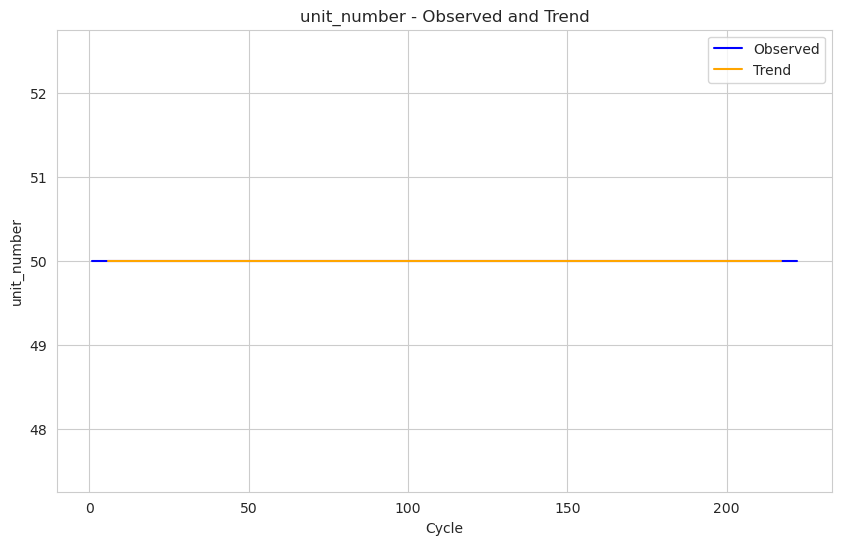

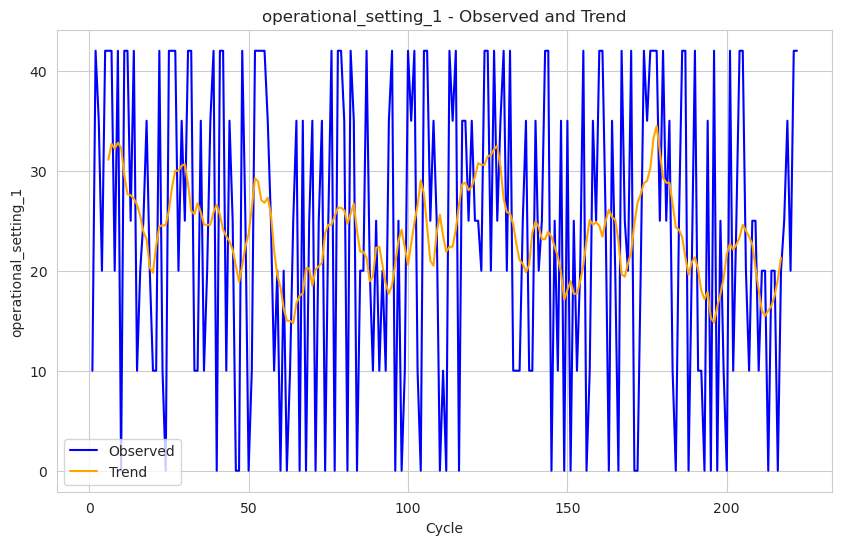

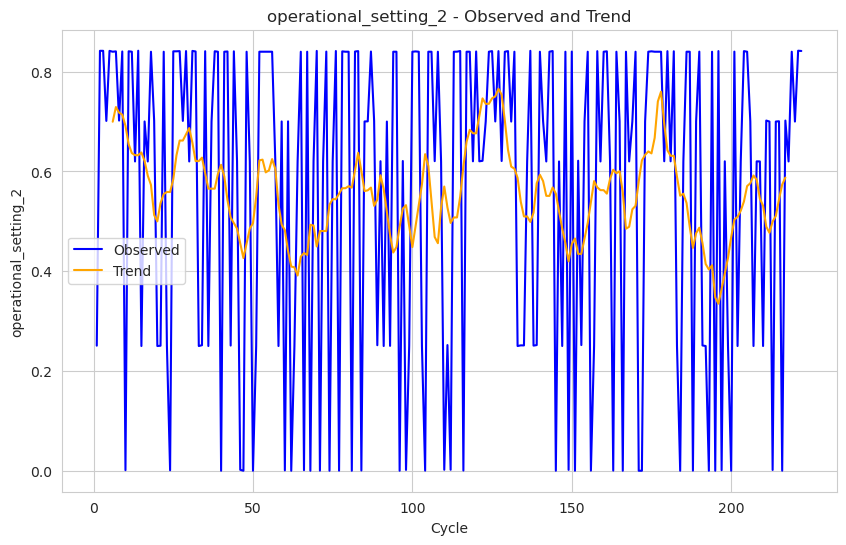

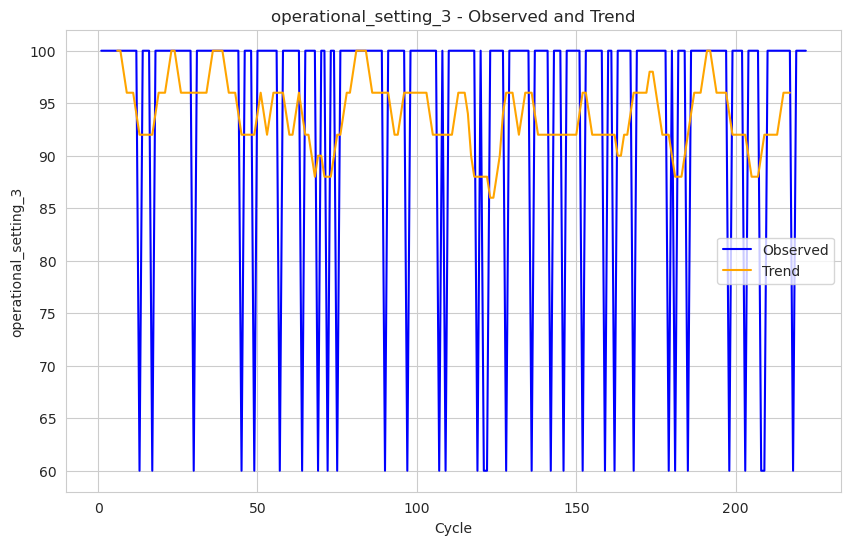

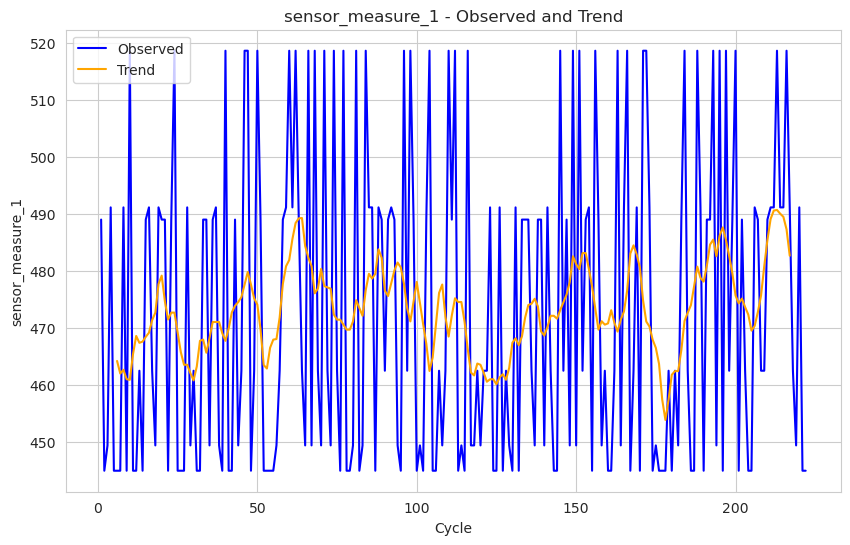

...

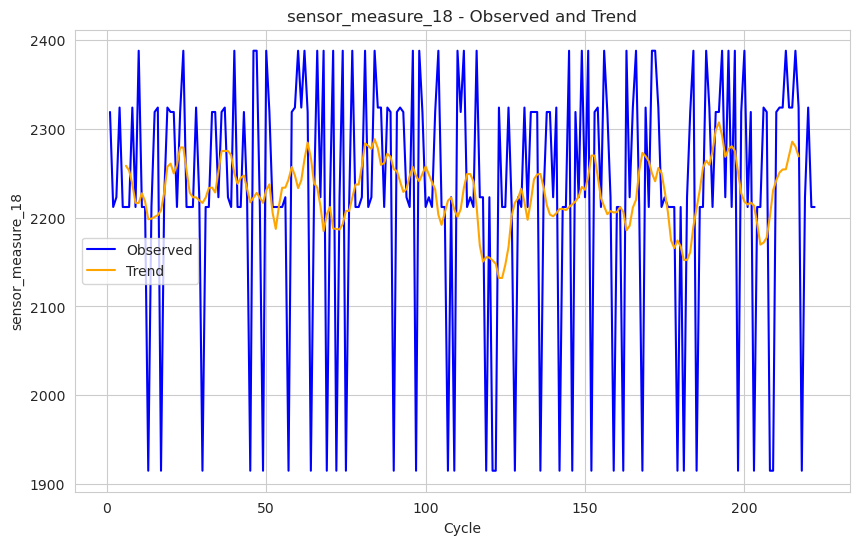

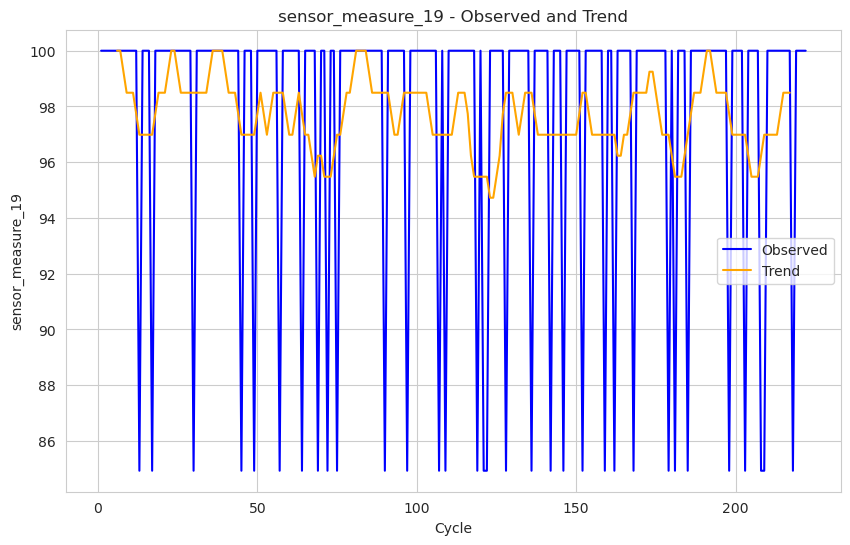

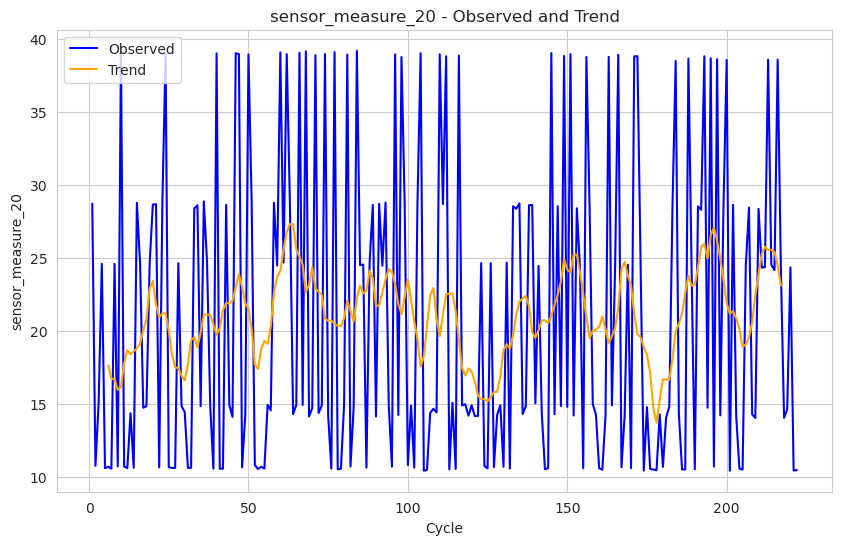

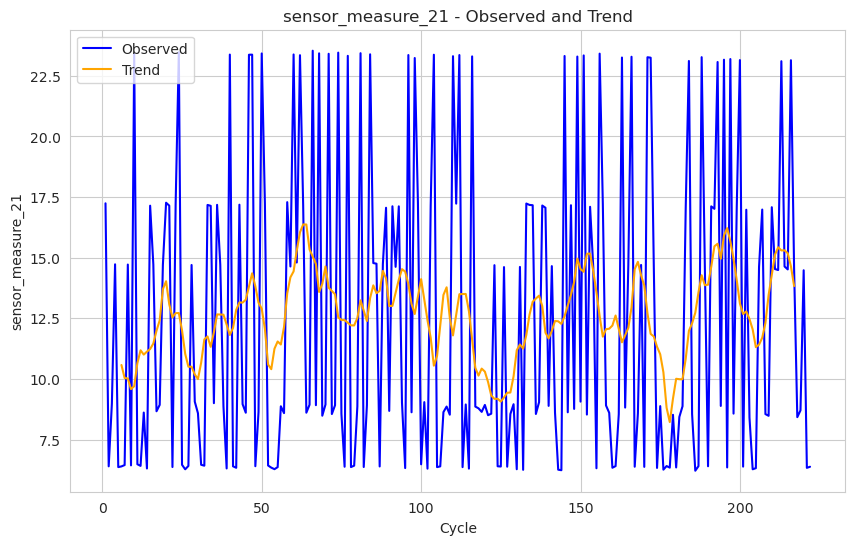

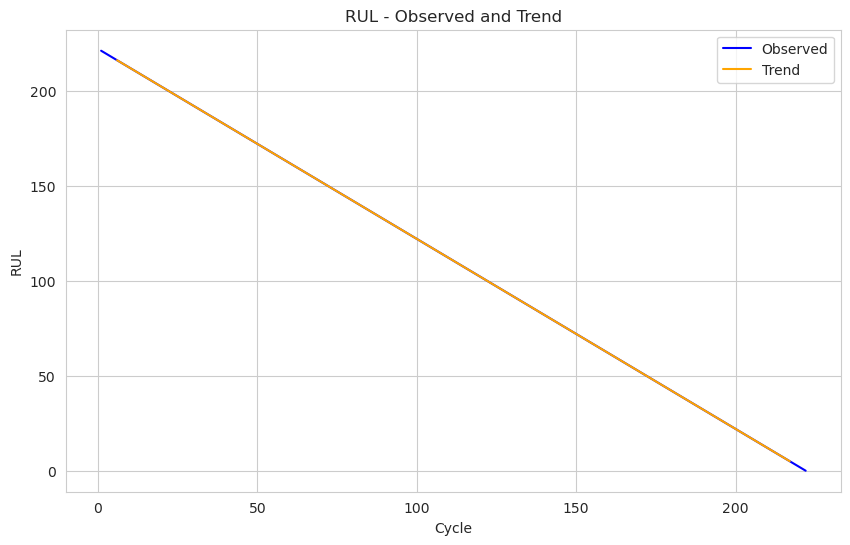

In [57]:
motor_id = 50
unit_data = turbine2_train[turbine2_train['unit_number'] == motor_id].set_index('cycle')
period = 10  # Adjust the period as needed

# Plot observed and trend data for each sensor column
for feature in unit_data.columns:
    ts = unit_data[feature]

    # Perform seasonal decomposition
    decomposition = sm.tsa.seasonal_decompose(ts, model='additive', period=period)

    # Plot the observed and trend components
    plt.figure(figsize=(10, 6))
    plt.plot(ts, label='Observed', color='blue')
    plt.plot(decomposition.trend, label='Trend', color='orange')
    plt.xlabel('Cycle')
    plt.ylabel(feature)
    plt.title(f'{feature} - Observed and Trend')
    plt.legend()
    plt.grid(True)
    plt.show()

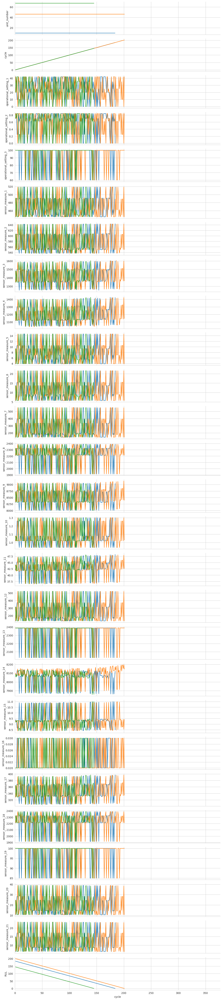

In [110]:
# Plot random 3 motors.
random_motor_ids = pd.Series(unit).sample(n=3, random_state=42).tolist()
filtered_data = turbine2_train[turbine2_train['unit_number'].isin(random_motor_ids)]
g = sns.PairGrid(data=filtered_data, x_vars='cycle', y_vars=filtered_data.columns, hue="unit_number", height=2, aspect=6,)
g = g.map(plt.plot)
g = g.set(xlim=(turbine2_train['RUL'].min(), turbine2_train['RUL'].max()))

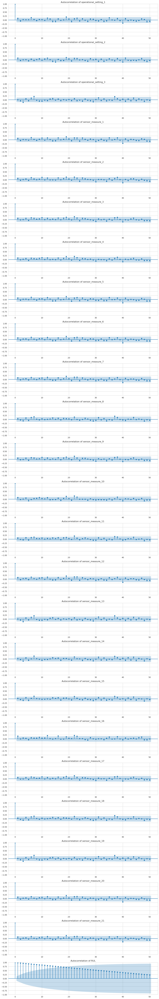

In [59]:
motor_id = 10  # Example unit_id, change as needed
unit_data = turbine2_train[turbine2_train['unit_number'] == motor_id].set_index('cycle')
unit_data = unit_data.drop(['unit_number'], axis=1)

# Create subplots for autocorrelation plots
num_data = len(unit_data.columns)
fig, axes = plt.subplots(nrows=num_data, ncols=1, figsize=(12, num_data * 3))

# Compute and plot autocorrelation for each sensor column
for ax, feature in zip(axes, unit_data.columns):
    ts = unit_data[feature]
    
    # Plot the autocorrelation function (ACF)
    sm.graphics.tsa.plot_acf(ts.dropna(), lags=50, ax=ax)
    ax.set_title(f'Autocorrelation of {feature}')

plt.tight_layout()
plt.show()

### 1.3 Turbine 3

#### 1.3.1 Data inspection

In [60]:
print("Training Data:")
display(turbine3_train.head())
print("\nTest Data:")
display(turbine3_test.head())
print("\nRUL Data:")
display(turbine3_rul_test.head())

Training Data:


,unit_number,cycle,operational_setting_1,operational_setting_2,operational_setting_3,sensor_measure_1,sensor_measure_2,sensor_measure_3,sensor_measure_4,sensor_measure_5,...,sensor_measure_13,sensor_measure_14,sensor_measure_15,sensor_measure_16,sensor_measure_17,sensor_measure_18,sensor_measure_19,sensor_measure_20,sensor_measure_21,RUL
0,1,1,-0.0005,0.0004,100.0,518.67,642.36,1583.23,1396.84,14.62,...,2388.01,8145.32,8.4246,0.03,391,2388,100.0,39.11,23.3537,258
1,1,2,0.0008,-0.0003,100.0,518.67,642.50,1584.69,1396.89,14.62,...,2388.03,8152.85,8.4403,0.03,392,2388,100.0,38.99,23.4491,257
2,1,3,-0.0014,-0.0002,100.0,518.67,642.18,1582.35,1405.61,14.62,...,2388.00,8150.17,8.3901,0.03,391,2388,100.0,38.85,23.3669,256
3,1,4,-0.0020,0.0001,100.0,518.67,642.92,1585.61,1392.27,14.62,...,2388.08,8146.56,8.3878,0.03,392,2388,100.0,38.96,23.2951,255
4,1,5,0.0016,0.0000,100.0,518.67,641.68,1588.63,1397.65,14.62,...,2388.03,8147.80,8.3869,0.03,392,2388,100.0,39.14,23.4583,254



Test Data:


,unit_number,cycle,operational_setting_1,operational_setting_2,operational_setting_3,sensor_measure_1,sensor_measure_2,sensor_measure_3,sensor_measure_4,sensor_measure_5,...,sensor_measure_12,sensor_measure_13,sensor_measure_14,sensor_measure_15,sensor_measure_16,sensor_measure_17,sensor_measure_18,sensor_measure_19,sensor_measure_20,sensor_measure_21
0,1,1,-0.0017,-0.0004,100.0,518.67,641.94,1581.93,1396.93,14.62,...,521.89,2387.94,8133.48,8.3760,0.03,391,2388,100.0,39.07,23.4468
1,1,2,0.0006,-0.0002,100.0,518.67,642.02,1584.86,1398.90,14.62,...,521.85,2388.01,8137.44,8.4062,0.03,391,2388,100.0,39.04,23.4807
2,1,3,0.0014,-0.0003,100.0,518.67,641.68,1581.78,1391.92,14.62,...,522.10,2387.94,8138.25,8.3553,0.03,391,2388,100.0,39.10,23.4244
3,1,4,0.0027,0.0001,100.0,518.67,642.20,1584.53,1395.34,14.62,...,522.45,2387.96,8137.07,8.3709,0.03,392,2388,100.0,38.97,23.4782
4,1,5,-0.0001,0.0001,100.0,518.67,642.46,1589.03,1395.86,14.62,...,521.91,2387.97,8134.20,8.4146,0.03,391,2388,100.0,39.09,23.3950



RUL Data:


,RUL
0,44
1,51
2,27
3,120
4,101


In [61]:
print("Shape of Training Data:")
print(turbine3_train.shape)
print("\nShape of Test Data:")
print(turbine3_test.shape)
print("\nShape of RUL Data:")
print(turbine3_rul_test.shape)

Shape of Training Data:
(24720, 27)

Shape of Test Data:
(16596, 26)

Shape of RUL Data:
(100, 1)


In [62]:
#Get number of units
unique_units_train = turbine3_train['unit_number'].nunique()
unique_units_test = turbine3_test['unit_number'].nunique()

# Display the results
print("Unique unit numbers in Training Data:", unique_units_train)
print("Unique unit numbers in Test Data:", unique_units_test)

#Both have 100 Units with several Cycles per Unit. The RUL is the RUL for each Unit of the train set.

Unique unit numbers in Training Data: 100
Unique unit numbers in Test Data: 100


In [63]:
# Closer look on the test dataset
turbine3_test.describe()

,unit_number,cycle,operational_setting_1,operational_setting_2,operational_setting_3,sensor_measure_1,sensor_measure_2,sensor_measure_3,sensor_measure_4,sensor_measure_5,...,sensor_measure_12,sensor_measure_13,sensor_measure_14,sensor_measure_15,sensor_measure_16,sensor_measure_17,sensor_measure_18,sensor_measure_19,sensor_measure_20,sensor_measure_21
count,16596.000000,16596.000000,16596.000000,16596.000000,16596.0,1.659600e+04,16596.00000,16596.000000,16596.000000,1.659600e+04,...,16596.000000,16596.000000,16596.000000,16596.000000,1.659600e+04,16596.000000,16596.0,16596.0,16596.000000,16596.000000
mean,51.887383,105.999518,-0.000017,-0.000004,100.0,5.186700e+02,642.26798,1585.608286,1400.567943,1.462000e+01,...,522.466597,2388.021013,8138.326536,8.395036,3.000000e-02,391.900036,2388.0,100.0,38.996889,23.398909
std,29.853523,83.286900,0.002201,0.000294,0.0,6.309810e-11,0.41885,5.538577,7.150365,3.089178e-12,...,2.113488,0.149771,9.974272,0.041332,1.271591e-14,1.390909,0.0,0.0,0.174817,0.105415
min,1.000000,1.000000,-0.008700,-0.000600,100.0,5.186700e+02,640.91000,1565.080000,1379.380000,1.462000e+01,...,517.670000,2386.940000,8105.450000,8.198000,3.000000e-02,387.000000,2388.0,100.0,38.320000,23.039000
25%,24.000000,42.000000,-0.001500,-0.000300,100.0,5.186700e+02,641.98000,1581.847500,1395.440000,1.462000e+01,...,521.370000,2387.980000,8132.310000,8.368700,3.000000e-02,391.000000,2388.0,100.0,38.880000,23.327500
50%,52.000000,87.000000,0.000000,0.000000,100.0,5.186700e+02,642.24000,1585.460000,1399.840000,1.462000e+01,...,522.010000,2388.040000,8137.595000,8.395100,3.000000e-02,392.000000,2388.0,100.0,39.000000,23.398500
75%,78.000000,149.000000,0.001500,0.000300,100.0,5.186700e+02,642.55000,1589.240000,1405.230000,1.462000e+01,...,523.000000,2388.090000,8143.190000,8.424125,3.000000e-02,393.000000,2388.0,100.0,39.110000,23.465400
max,100.000000,475.000000,0.008300,0.000600,100.0,5.186700e+02,644.03000,1607.130000,1430.210000,1.462000e+01,...,535.630000,2388.530000,8191.380000,8.532800,3.000000e-02,398.000000,2388.0,100.0,39.750000,23.849600


In [64]:
# Check for missing values
print("\nData types and null counts:")
summary = pd.DataFrame({
    'Data Type': turbine3_train.dtypes,
    'Null Count': turbine3_train.isnull().sum()
})
print(summary)
print()
rows_with_missing_values = turbine3_train[turbine3_train.isnull().any(axis=1)]

print("Rows with missing values:")
print(rows_with_missing_values)


Data types and null counts:
                      Data Type  Null Count
unit_number               int64           0
cycle                     int64           0
operational_setting_1   float64           0
operational_setting_2   float64           0
operational_setting_3   float64           0
sensor_measure_1        float64           0
sensor_measure_2        float64           0
sensor_measure_3        float64           0
sensor_measure_4        float64           0
sensor_measure_5        float64           0
sensor_measure_6        float64           0
sensor_measure_7        float64           0
sensor_measure_8        float64           0
sensor_measure_9        float64           0
sensor_measure_10       float64           0
sensor_measure_11       float64           0
sensor_measure_12       float64           0
sensor_measure_13       float64           0
sensor_measure_14       float64           0
sensor_measure_15       float64           0
sensor_measure_16       float64           0
sen

#### 1.3.2 Feature distribution

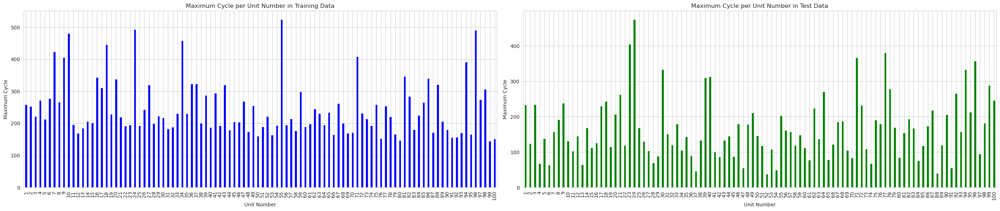


Average Max Cycle for Training Data  247.2

Average Max Cycle for Test Data  165.96


In [65]:
# Group by 'UnitNumber' and find the maximum 'Cycle' for each unit in Training and Test Data
max_cycle_train = turbine3_train.groupby('unit_number')['cycle'].max()
max_cycle_test = turbine3_test.groupby('unit_number')['cycle'].max()

# Create the plot
plt.figure(figsize=(28, 6))

# Plot Training Data
plt.subplot(1, 2, 1)
max_cycle_train.plot(kind='bar', color='blue')
plt.title('Maximum Cycle per Unit Number in Training Data')
plt.xlabel('Unit Number')
plt.ylabel('Maximum Cycle')

# Plot Test Data
plt.subplot(1, 2, 2)
max_cycle_test.plot(kind='bar', color='green')
plt.title('Maximum Cycle per Unit Number in Test Data')
plt.xlabel('Unit Number')
plt.ylabel('Maximum Cycle')

plt.tight_layout()
plt.show()

print("\nAverage Max Cycle for Training Data ", np.mean(max_cycle_train) )
print("\nAverage Max Cycle for Test Data ", np.mean(max_cycle_test) )

In [66]:
# Calculate the standard deviation for each column in the DataFrame
std_devs = turbine3_train.std()

# Identify columns where the standard deviation is 0
zero_std_cols = std_devs[std_devs == 0].index.tolist()

# Loop through each column with std of 0, print the column name and its constant value
for col in zero_std_cols:
    print(f"Column: {col}, Constant Value: {turbine3_train[col].iloc[0]}")

# Remove the columns with a standard deviation of 0 from the DataFrame
turbine3_train.drop(columns=zero_std_cols, inplace=True)

# Optionally, print the DataFrame to verify the columns are removed
display(turbine3_train.describe())

Column: operational_setting_3, Constant Value: 100.0
Column: sensor_measure_18, Constant Value: 2388
Column: sensor_measure_19, Constant Value: 100.0


,unit_number,cycle,operational_setting_1,operational_setting_2,sensor_measure_1,sensor_measure_2,sensor_measure_3,sensor_measure_4,sensor_measure_5,sensor_measure_6,...,sensor_measure_11,sensor_measure_12,sensor_measure_13,sensor_measure_14,sensor_measure_15,sensor_measure_16,sensor_measure_17,sensor_measure_20,sensor_measure_21,RUL
count,24720.000000,24720.000000,24720.000000,24720.000000,2.472000e+04,24720.000000,24720.000000,24720.000000,2.472000e+04,24720.000000,...,24720.000000,24720.000000,24720.000000,24720.000000,24720.000000,2.472000e+04,24720.000000,24720.000000,24720.000000,24720.000000
mean,48.631877,139.077063,-0.000024,0.000005,5.186700e+02,642.457858,1588.079175,1404.471212,1.462000e+01,21.595841,...,47.415707,523.050873,2388.071643,8144.202916,8.396176,3.000000e-02,392.566545,38.988552,23.393024,138.077063
std,29.348985,98.846675,0.002194,0.000294,6.684921e-11,0.523031,6.810418,9.773178,3.602525e-12,0.018116,...,0.300074,3.255314,0.158121,16.504118,0.060512,1.750371e-14,1.761459,0.248865,0.149234,98.846675
min,1.000000,1.000000,-0.008600,-0.000600,5.186700e+02,640.840000,1564.300000,1377.060000,1.462000e+01,21.450000,...,46.690000,517.770000,2386.930000,8099.680000,8.156300,3.000000e-02,388.000000,38.170000,22.872600,0.000000
25%,23.000000,62.000000,-0.001500,-0.000200,5.186700e+02,642.080000,1583.280000,1397.187500,1.462000e+01,21.580000,...,47.190000,521.150000,2388.010000,8134.510000,8.360600,3.000000e-02,391.000000,38.830000,23.296200,61.000000
50%,47.000000,124.000000,-0.000000,-0.000000,5.186700e+02,642.400000,1587.520000,1402.910000,1.462000e+01,21.600000,...,47.360000,521.980000,2388.070000,8141.200000,8.398300,3.000000e-02,392.000000,38.990000,23.391600,123.000000
75%,74.000000,191.000000,0.001500,0.000300,5.186700e+02,642.790000,1592.412500,1410.600000,1.462000e+01,21.610000,...,47.600000,523.840000,2388.140000,8149.230000,8.437000,3.000000e-02,394.000000,39.140000,23.483300,190.000000
max,100.000000,525.000000,0.008600,0.000700,5.186700e+02,645.110000,1615.390000,1441.160000,1.462000e+01,21.610000,...,48.440000,537.400000,2388.610000,8290.550000,8.570500,3.000000e-02,399.000000,39.850000,23.950500,524.000000


In [67]:
# Also remove 5 and 16 as they only have the same value, but due to some calculation problems they won't get dropped

columns_to_remove = ["sensor_measure_5", "sensor_measure_16"]
all_columns_to_drop = zero_std_cols + columns_to_remove
turbine3_train.drop(columns=columns_to_remove, inplace = True)
display(turbine3_train.describe())

,unit_number,cycle,operational_setting_1,operational_setting_2,sensor_measure_1,sensor_measure_2,sensor_measure_3,sensor_measure_4,sensor_measure_6,sensor_measure_7,...,sensor_measure_10,sensor_measure_11,sensor_measure_12,sensor_measure_13,sensor_measure_14,sensor_measure_15,sensor_measure_17,sensor_measure_20,sensor_measure_21,RUL
count,24720.000000,24720.000000,24720.000000,24720.000000,2.472000e+04,24720.000000,24720.000000,24720.000000,24720.000000,24720.000000,...,24720.000000,24720.000000,24720.000000,24720.000000,24720.000000,24720.000000,24720.000000,24720.000000,24720.000000,24720.000000
mean,48.631877,139.077063,-0.000024,0.000005,5.186700e+02,642.457858,1588.079175,1404.471212,21.595841,555.143808,...,1.301232,47.415707,523.050873,2388.071643,8144.202916,8.396176,392.566545,38.988552,23.393024,138.077063
std,29.348985,98.846675,0.002194,0.000294,6.684921e-11,0.523031,6.810418,9.773178,0.018116,3.437343,...,0.003485,0.300074,3.255314,0.158121,16.504118,0.060512,1.761459,0.248865,0.149234,98.846675
min,1.000000,1.000000,-0.008600,-0.000600,5.186700e+02,640.840000,1564.300000,1377.060000,21.450000,549.610000,...,1.290000,46.690000,517.770000,2386.930000,8099.680000,8.156300,388.000000,38.170000,22.872600,0.000000
25%,23.000000,62.000000,-0.001500,-0.000200,5.186700e+02,642.080000,1583.280000,1397.187500,21.580000,553.110000,...,1.300000,47.190000,521.150000,2388.010000,8134.510000,8.360600,391.000000,38.830000,23.296200,61.000000
50%,47.000000,124.000000,-0.000000,-0.000000,5.186700e+02,642.400000,1587.520000,1402.910000,21.600000,554.050000,...,1.300000,47.360000,521.980000,2388.070000,8141.200000,8.398300,392.000000,38.990000,23.391600,123.000000
75%,74.000000,191.000000,0.001500,0.000300,5.186700e+02,642.790000,1592.412500,1410.600000,21.610000,556.040000,...,1.300000,47.600000,523.840000,2388.140000,8149.230000,8.437000,394.000000,39.140000,23.483300,190.000000
max,100.000000,525.000000,0.008600,0.000700,5.186700e+02,645.110000,1615.390000,1441.160000,21.610000,570.490000,...,1.320000,48.440000,537.400000,2388.610000,8290.550000,8.570500,399.000000,39.850000,23.950500,524.000000


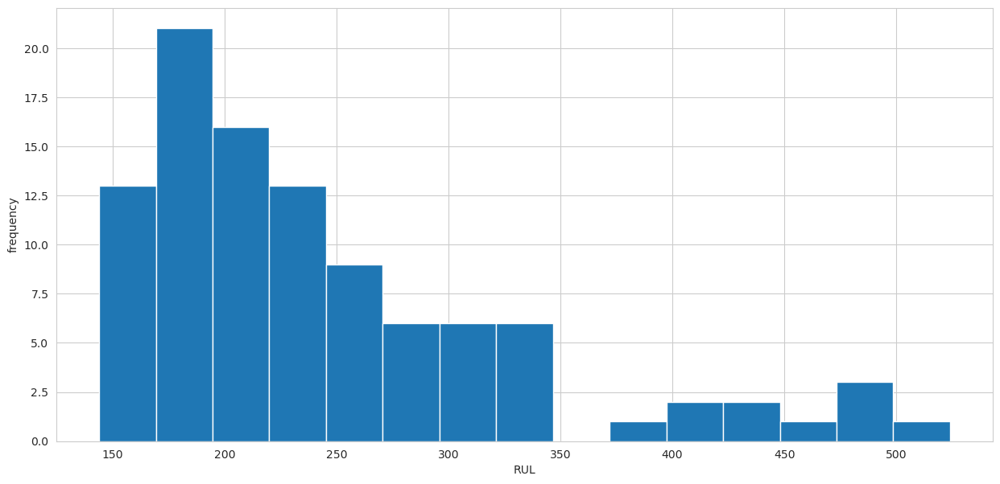

In [68]:
df_max_rul = turbine3_train[['unit_number', 'RUL']].groupby('unit_number').max().reset_index()
df_max_rul['RUL'].hist(bins=15, figsize=(15,7))
plt.xlabel('RUL')
plt.ylabel('frequency')
plt.show()

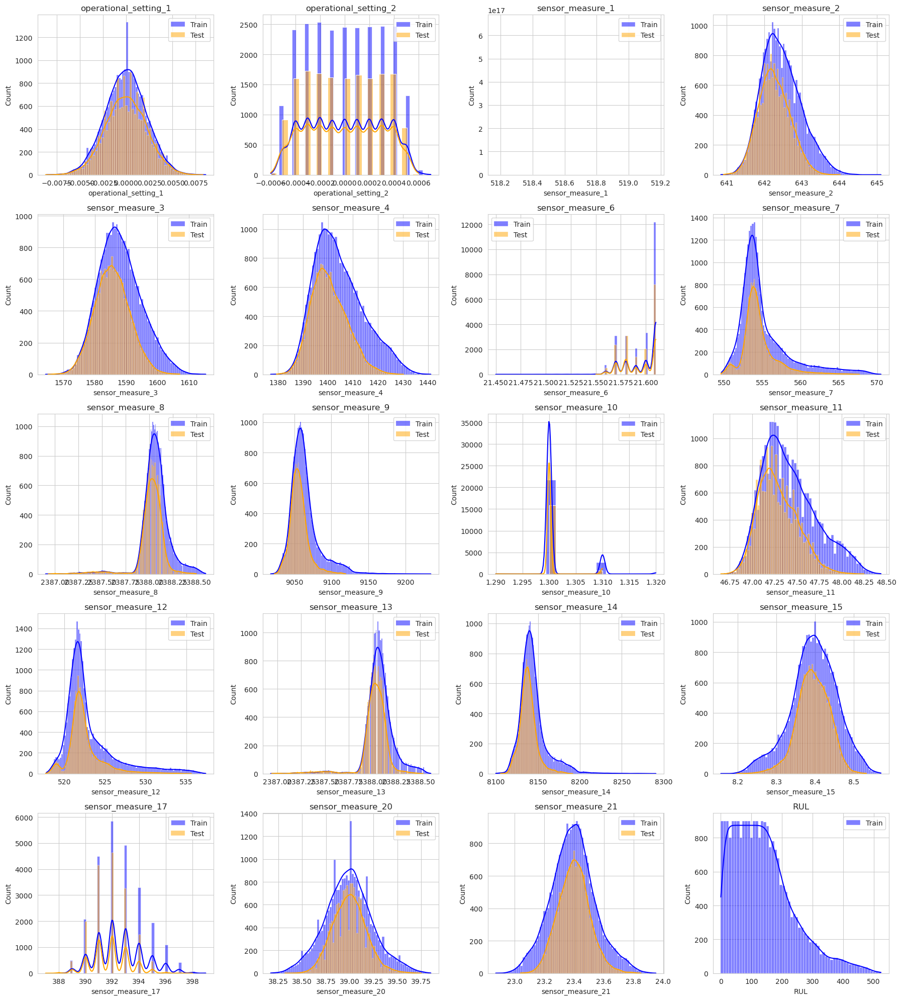

In [69]:
# Calculate the number of rows needed
columns = turbine3_train.drop(['unit_number', 'cycle'], axis=1).columns
num_rows = len(columns) // 4
if len(columns) % 4 != 0:
    num_rows += 1

fig, axes = plt.subplots(num_rows, 4, figsize=(18, 4 * num_rows))
axes = axes.flatten()

# Plot histograms for each sensor
for i, feature in enumerate(columns):
    ax = axes[i]
    sns.histplot(turbine3_train[feature], kde=True, color='blue', label='Train', ax=ax)
    if feature != 'RUL':
        sns.histplot(turbine3_test[feature], kde=True, color='orange', label='Test', ax=ax)
    ax.set_title(feature)
    ax.legend()

# Hide empty subplots
for i in range(len(columns), num_rows * 4):
    axes[i].axis('off')

plt.tight_layout()
plt.show()

**Hier aufpassen, da unterschiedliche Anzahl an Werten je nach Test und Train, also nicht zu 100 Prozent aussagekräftig.**

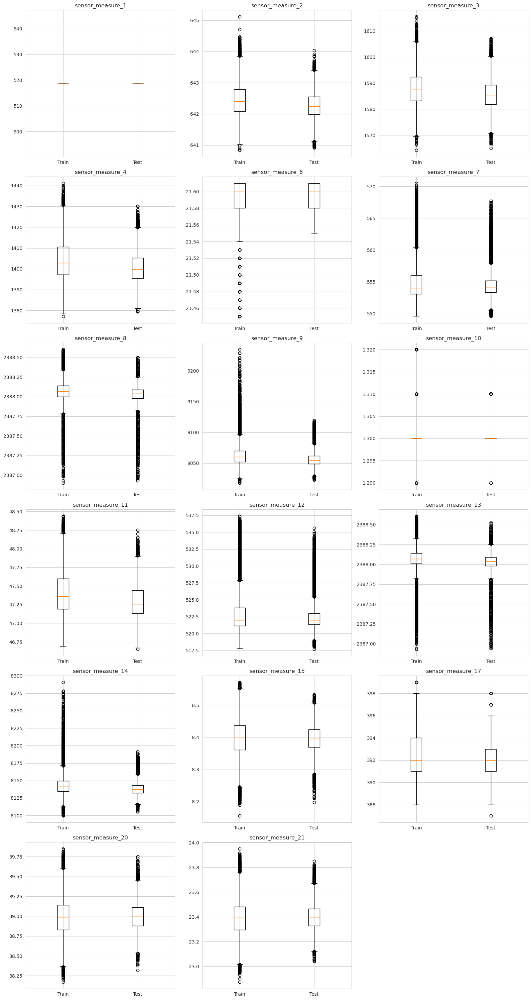

In [70]:
# Calculate the number of rows needed
sensor_columns = [col for col in turbine3_train.columns if col.startswith('sensor')]
num_rows = len(sensor_columns) // 3
if len(sensor_columns) % 3 != 0:
    num_rows += 1

fig, axes = plt.subplots(num_rows, 3, figsize=(16, 5 * num_rows))
axes = axes.flatten()

# Plot each sensor's boxplot for both train and test datasets
for i, sensor in enumerate(sensor_columns):
    ax = axes[i]
    ax.boxplot([turbine3_train[sensor], turbine3_test[sensor]], labels=['Train', 'Test'])
    ax.set_title(sensor)
    ax.set_xticklabels(['Train', 'Test'])

# Hide empty subplots
for i in range(len(sensor_columns), num_rows * 3):
    axes[i].axis('off')

plt.tight_layout()
plt.show()

We can see some extreme values, that only occur in the Train dataset and not in the test dataset

#### 1.3.3 Time and Distrubition Plots

In [71]:
def print_time_series(dataframe, id=2):
    # Filter the DataFrame for the specified motor ID
    Dataframe_id = dataframe[dataframe["unit_number"] == id]

    # Generate a list of column names that include sensor measurements or principal components
    sensor_measure_columns_names = [
        col for col in Dataframe_id.columns
        if 'sensor_measure' in col or 'PC' in col  # Check for 'sm' and 'PC' in column names
    ]

    # Determine the number of columns to be plotted
    numberOfcolumns = len(sensor_measure_columns_names)

    # Set up the figure with an appropriate size based on the number of columns
    plt.figure(figsize=(15, 2.5 * numberOfcolumns))

    # Plot each column in a separate subplot
    for i, col_name in enumerate(sensor_measure_columns_names):
        ax = plt.subplot(numberOfcolumns, 1, i + 1)
        ax.plot(Dataframe_id.index.values, Dataframe_id[col_name].values)  # Use column names directly
        ax.title.set_text(col_name)
        plt.tight_layout()

    # Print a description and show the plot
    print(f"Zeitliche Verlauf von Turbofan mit id {id}. X Axis is the Cycle Number, Y Axis is the Sensor Value")
    plt.show()


Zeitliche Verlauf von Turbofan mit id 57. X Axis is the Cycle Number, Y Axis is the Sensor Value


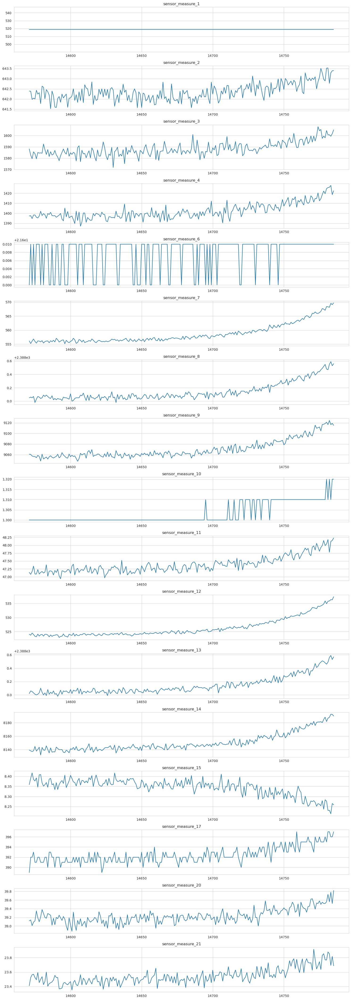

In [72]:
print_time_series(dataframe=turbine3_train, id=57)

In [73]:
def plot_operational_settings(data):
    # Unique list of unit numbers
    unit_numbers = data['unit_number'].unique()[:3]

    # Determine the number of unit numbers to set figure size dynamically
    plt.figure(figsize=(15, 5 * len(unit_numbers)))

    # Loop through each unit number and plot operational settings
    for i, unit in enumerate(unit_numbers, start=1):
        # Filter data for the specific unit
        unit_data = data[data['unit_number'] == unit]

        # Create subplot for each unit
        ax = plt.subplot(len(unit_numbers), 1, i)
        ax.plot(unit_data['cycle'], unit_data['operational_setting_1'], label='OS1', marker='o', linestyle='-')
        ax.plot(unit_data['cycle'], unit_data['operational_setting_2'], label='OS2', marker='x', linestyle='--')

        # Adding titles and labels
        ax.set_title(f'Operational Settings Over Cycles for Unit {unit}')
        ax.set_xlabel('Cycle')
        ax.set_ylabel('Operational Setting Value')
        ax.legend()

    plt.tight_layout()
    plt.show()

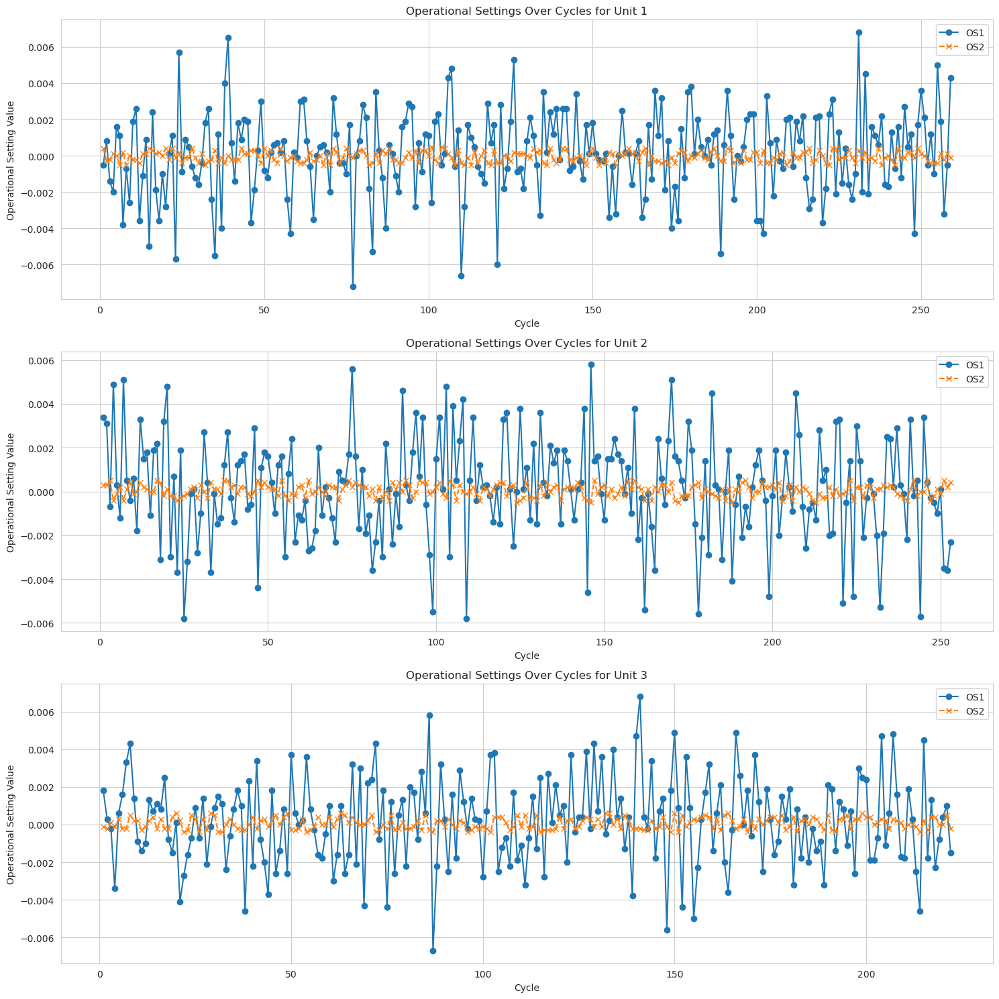

In [74]:
plot_operational_settings(turbine3_train)

In [75]:
# Check relationship between Max Cycles and Remaining Useful Lifetime

max_cycle_test_df = max_cycle_test.to_frame(name='Max Cycle')

# Optionally, if you want to reset the index to make the original index a column
max_cycle_test_df.reset_index(inplace=True)
max_cycle_test_df.rename(columns={'index': 'Unit Number'}, inplace=True)
max_cycle_test_df['RUL'] = turbine3_rul_test

# Display the new DataFrame
print(max_cycle_test_df)

    unit_number  Max Cycle  RUL
0             1        233   44
1             2        124   51
2             3        234   27
3             4         68  120
4             5        138  101
..          ...        ...  ...
95           96        358  113
96           97         95  123
97           98        182   17
98           99        289    8
99          100        247   28

[100 rows x 3 columns]


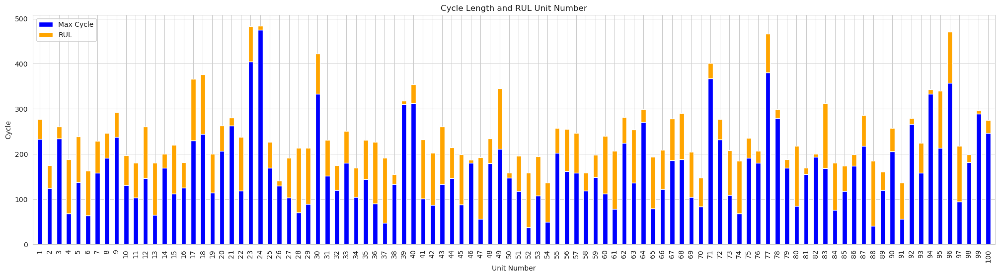

Correlation coefficient: -0.4842054127596086
P-value: 3.3232563781600715e-07
Negative and significant Correlation -> logical


In [76]:
# Setting up the figure and axis
plt.figure(figsize=(25, 6))
ax = plt.gca()

# Data preparation
units = max_cycle_test_df['unit_number']  # Extracting Unit Numbers
max_cycles = max_cycle_test_df['Max Cycle']  # Extracting Max Cycle values
ruls = max_cycle_test_df['RUL']  # Extracting RUL values


index = np.arange(len(units))
bar_width = 0.5

# Creating the bar for Max Cycle
ax.bar(index, max_cycles, bar_width, label='Max Cycle', color='blue')

# Stacking the RUL bar on top of the Max Cycle bar
ax.bar(index, ruls, bar_width, bottom=max_cycles, label='RUL', color='orange')

# Adding title and labels
ax.set_xlabel('Unit Number')
ax.set_ylabel('Cycle')
ax.set_title('Cycle Length and RUL Unit Number')
ax.set_xticks(index)
ax.set_xticklabels(units)

# Rotate x-labels vertically
plt.xticks(rotation='vertical')

# Remove the margins on the x-axis
plt.margins(x=0.005)

# Adding legend
ax.legend()

# Show the plot
plt.show()

# Extract the two columns as numpy arrays
max_cycle_values = max_cycle_test_df['Max Cycle']
rul_values = max_cycle_test_df['RUL']

# Calculate Pearson's correlation
correlation, p_value = pearsonr(max_cycle_values, rul_values)

# Print the correlation and the p-value
print("Correlation coefficient:", correlation)
print("P-value:", p_value)
print("Negative and significant Correlation -> logical")

#### 1.3.4 Correlation

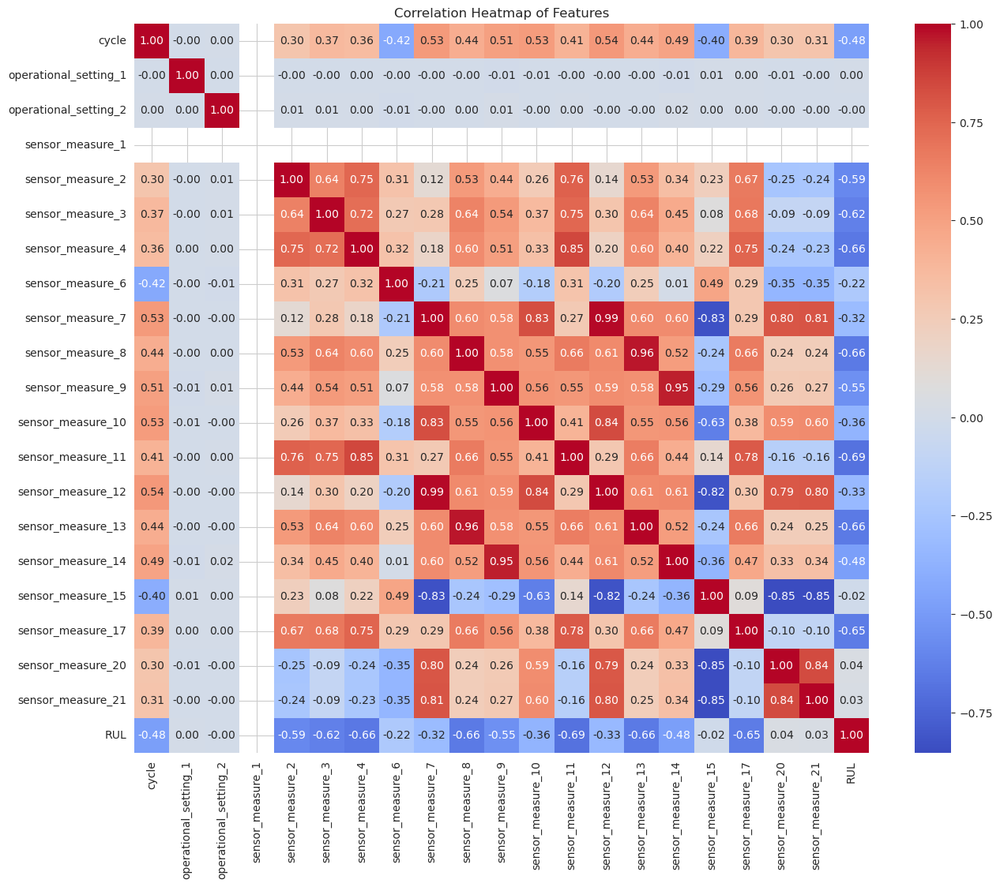

In [77]:
# Compute the correlation matrix for all columns except 'unitnr'
corr_matrix = turbine3_train.drop('unit_number', axis=1).corr()

# Create a heatmap to visualize the correlation matrix
plt.figure(figsize=(15, 12))  # Adjust the size of the figure as needed
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', cbar=True)
plt.title('Correlation Heatmap of Features')
plt.show()

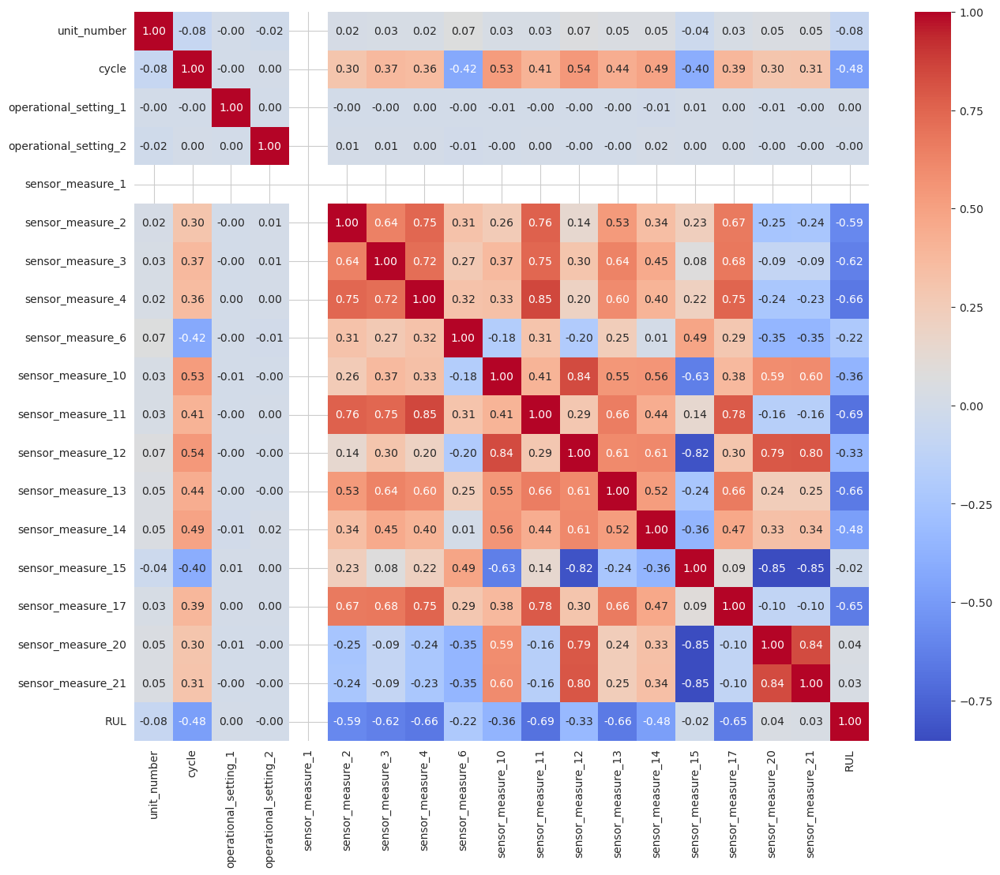

In [78]:
# Identify pairs of features with correlation greater than 0.95
high_corr = set()
for i in range(len(corr_matrix.columns)):
    for j in range(i + 1, len(corr_matrix.columns)):
        if abs(corr_matrix.iloc[i, j]) > 0.95:  # absolute value of correlation coefficient
            colname = corr_matrix.columns[i]
            high_corr.add(colname)

# Decide which features to drop
# For simplicity, let's drop all identified features
turbine3_train.drop(columns=list(high_corr), inplace=True)

corr_matrix = turbine3_train.corr()

# Visualize the correlation matrix
plt.figure(figsize=(15, 12))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm')
plt.show()

PCA for two Correlation Clusters

Cluster 1: Sensor Measurements 10,12,15,20,21
Cluster 2: Sensor Measurements 2,3,4,11,17

Correlationts of over 70%

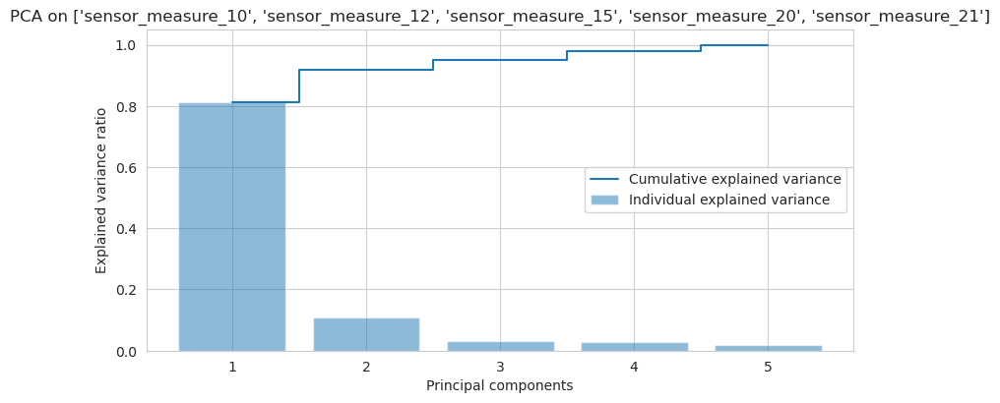

Cluster 1 Components Needed: 2


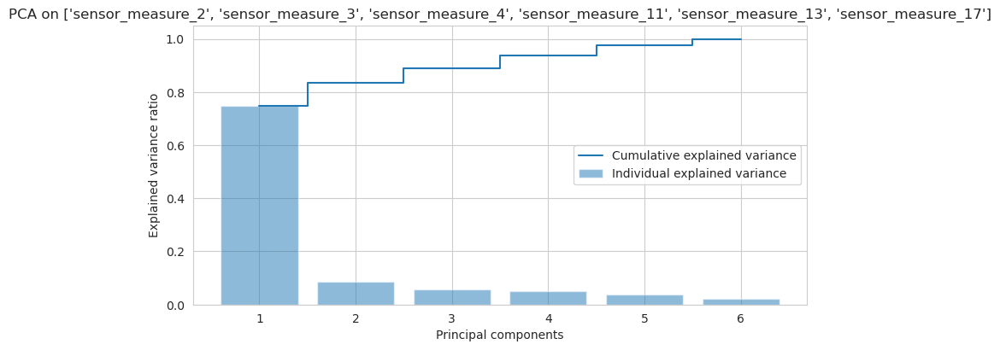

Cluster 2 Components Needed: 4


In [79]:
# Define the clusters of features
cluster_1 = ['sensor_measure_10', 'sensor_measure_12', 'sensor_measure_15', 'sensor_measure_20', 'sensor_measure_21']
cluster_2 = ['sensor_measure_2', 'sensor_measure_3', 'sensor_measure_4', 'sensor_measure_11','sensor_measure_13', 'sensor_measure_17']

# Function to perform PCA and plot explained variance
def perform_pca(features, threshold=0.9):
    # Filter the data to include only the specified features
    data_subset = turbine3_train[features]

    # Standardize the data
    scaler = StandardScaler()
    data_std = scaler.fit_transform(data_subset)

    # Initialize PCA
    pca = PCA()

    # Fit PCA on the standardized data
    pca.fit(data_std)

    # Calculate cumulative sum of explained variances
    cum_var_exp = np.cumsum(pca.explained_variance_ratio_)

    # Determine the number of components to reach the threshold
    num_components = np.where(cum_var_exp >= threshold)[0][0] + 1

    # Plot the explained variances
    plt.figure(figsize=(8, 4))
    plt.bar(range(1, len(pca.explained_variance_ratio_) + 1), pca.explained_variance_ratio_, alpha=0.5, align='center',
            label='Individual explained variance')
    plt.step(range(1, len(cum_var_exp) + 1), cum_var_exp, where='mid',
             label='Cumulative explained variance')
    plt.ylabel('Explained variance ratio')
    plt.xlabel('Principal components')
    plt.legend(loc='best')
    plt.tight_layout()
    plt.title(f"PCA on {features}")
    plt.show()

    return num_components

# Perform PCA on each cluster
print("Cluster 1 Components Needed:", perform_pca(cluster_1))
print("Cluster 2 Components Needed:", perform_pca(cluster_2))

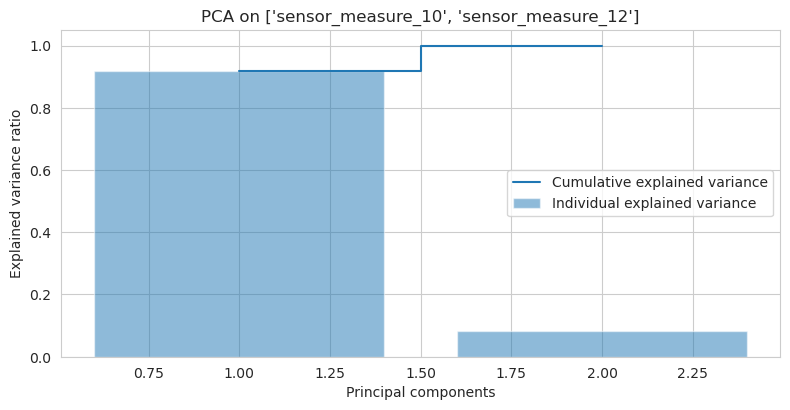

Cluster 1.1 Components Needed: 1


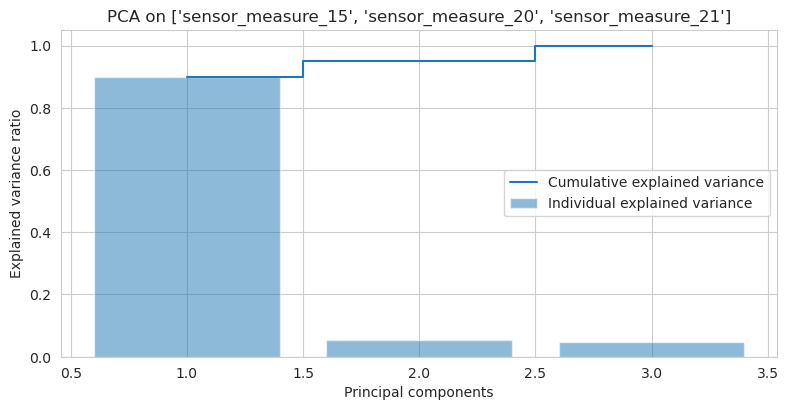

Cluster 1.2 Components Needed: 1


In [80]:
#Split Cluster 1 further into cluster 1.1 (10,12) and cluster 1.2 (15, 20, 21)
cluster_11 = ['sensor_measure_10', 'sensor_measure_12']
cluster_12 = ['sensor_measure_15', 'sensor_measure_20', 'sensor_measure_21']

print("Cluster 1.1 Components Needed:", perform_pca(cluster_11))
print("Cluster 1.2 Components Needed:", perform_pca(cluster_12, 0.89))

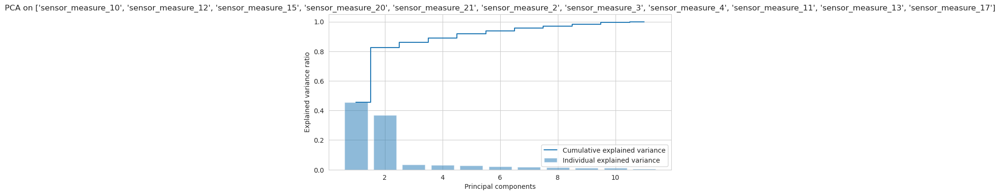

Both clusters together Components Needed: 7


In [81]:
combined_cluster = cluster_1 + cluster_2
print("Both clusters together Components Needed:", perform_pca(combined_cluster, 0.95))

Perform PCA and remove features

In [82]:
# Define the clusters of features
clusters = {
    'cluster_1': ['sensor_measure_10', 'sensor_measure_12', 'sensor_measure_15', 'sensor_measure_20', 'sensor_measure_21'],
    #'cluster_11': ['sensor_measure_10', 'sensor_measure_12'],
    #'cluster_12': ['sensor_measure_15', 'sensor_measure_20', 'sensor_measure_21'],
    'cluster_2': ['sensor_measure_2', 'sensor_measure_3', 'sensor_measure_4', 'sensor_measure_11','sensor_measure_13' ,'sensor_measure_17']
}

# Initialize the StandardScaler
scaler = StandardScaler()

# Function to perform PCA and return a DataFrame of results and loadings
def perform_pca(features, cluster_name):
    # Filter and scale the data
    X = turbine3_train[features]
    X_scaled = scaler.fit_transform(X)

    # Configure PCA to capture 90% of the variance
    pca = PCA(n_components=0.9)
    X_pca = pca.fit_transform(X_scaled)

    # Calculate number of components and explained variance
    num_components = pca.n_components_
    variance_ratio = pca.explained_variance_ratio_.sum()

    # Create DataFrame for PCA results
    df_pca = pd.DataFrame(X_pca, columns=[f'{cluster_name}_PC{i+1}' for i in range(num_components)])

    # Create DataFrame for Loadings
    loadings_df = pd.DataFrame(pca.components_, columns=features, index=[f'{cluster_name}_PC{i+1}' for i in range(num_components)])

    return df_pca, variance_ratio, loadings_df

# Apply PCA to each cluster
results = {}
for name, features in clusters.items():
    df_pca, variance_ratio, loadings_df = perform_pca(features, name)
    results[name] = {'PCA Results': df_pca, 'Explained Variance Ratio': variance_ratio, 'Loadings': loadings_df}

# Print results in a structured way
for cluster, result in results.items():
    print(f"\n{cluster} - Number of components: {result['PCA Results'].shape[1]}")
    print(f"{cluster} - Explained variance ratio: {result['Explained Variance Ratio']:.4f}")
    print(f"\n{cluster} - Principal Component Loadings:")
    display(result['Loadings'])


cluster_1 - Number of components: 2
cluster_1 - Explained variance ratio: 0.9197

cluster_1 - Principal Component Loadings:


,sensor_measure_10,sensor_measure_12,sensor_measure_15,sensor_measure_20,sensor_measure_21
cluster_1_PC1,0.399643,0.468516,-0.459948,0.451431,0.453250
cluster_1_PC2,0.780269,0.273539,0.272851,-0.357507,-0.337783



cluster_2 - Number of components: 4
cluster_2 - Explained variance ratio: 0.9383

cluster_2 - Principal Component Loadings:


,sensor_measure_2,sensor_measure_3,sensor_measure_4,sensor_measure_11,sensor_measure_13,sensor_measure_17
cluster_2_PC1,0.396120,0.401453,0.426622,0.439026,0.368533,0.413953
cluster_2_PC2,0.497424,-0.127763,0.272226,0.150129,-0.795349,-0.083789
cluster_2_PC3,-0.215301,0.867812,-0.007446,-0.034798,-0.243775,-0.373972
cluster_2_PC4,-0.657020,-0.001568,0.216459,0.130601,-0.375431,0.602879


In [83]:
# Create a copy of train_data without the cluster columns
all_cluster_columns = [col for cluster in clusters.values() for col in cluster]  # Flatten the list of cluster columns
train_data_reduced = turbine3_train.drop(columns=all_cluster_columns)

# Combine the reduced train_data with PCA results from each cluster
for cluster, result in results.items():
    train_data_reduced = pd.concat([train_data_reduced, result['PCA Results']], axis=1)

# Make RUL last column
rul_column = train_data_reduced.pop('RUL')
train_data_reduced['RUL'] = rul_column

# Display the first few rows of the new DataFrame to verify the changes
display(train_data_reduced.head())

,unit_number,cycle,operational_setting_1,operational_setting_2,sensor_measure_1,sensor_measure_6,sensor_measure_14,cluster_1_PC1,cluster_1_PC2,cluster_2_PC1,cluster_2_PC2,cluster_2_PC3,cluster_2_PC4,RUL
0,1,1,-0.0005,0.0004,518.67,21.61,8145.32,-0.363083,-0.295356,-1.374211,0.112037,-0.130764,-0.485150,258
1,1,2,0.0008,-0.0003,518.67,21.61,8152.85,-0.394516,-0.258866,-1.000722,0.035995,-0.237419,-0.395933,257
2,1,3,-0.0014,-0.0002,518.67,21.61,8150.17,-0.572691,-0.130817,-1.319928,0.211919,-0.150790,-0.075661,256
3,1,4,-0.0020,0.0001,518.67,21.61,8146.56,-0.507536,-0.098039,-0.698903,0.042988,-0.367806,-1.140444,255
4,1,5,0.0016,0.0000,518.67,21.61,8147.80,0.334456,-0.722522,-1.473381,-0.836645,0.610892,0.615260,254


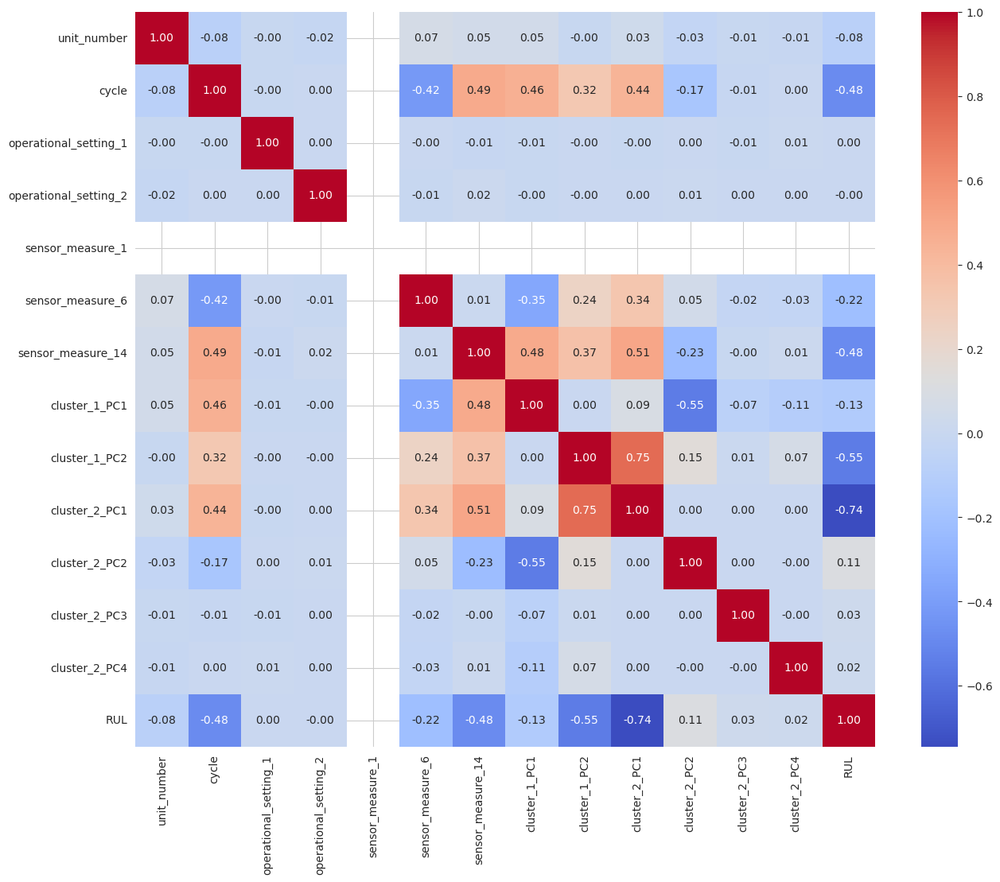

In [84]:
columns_to_drop = cluster_1 + cluster_2
train_data_reduced_modified = train_data_reduced.drop(columns=[col for col in columns_to_drop if col in train_data_reduced.columns])

# Compute the correlation matrix for the modified DataFrame
corr_matrix = train_data_reduced_modified.corr()

# Visualize the correlation matrix
plt.figure(figsize=(15, 12))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm')
plt.show()

### 1.4 Turbine 4

#### 1.4.1 Data inspection

In [85]:
turbine4_train.head()

,unit_number,cycle,operational_setting_1,operational_setting_2,operational_setting_3,sensor_measure_1,sensor_measure_2,sensor_measure_3,sensor_measure_4,sensor_measure_5,...,sensor_measure_13,sensor_measure_14,sensor_measure_15,sensor_measure_16,sensor_measure_17,sensor_measure_18,sensor_measure_19,sensor_measure_20,sensor_measure_21,RUL
0,1,1,42.0049,0.8400,100.0,445.00,549.68,1343.43,1112.93,3.91,...,2387.99,8074.83,9.3335,0.02,330,2212,100.00,10.62,6.3670,320
1,1,2,20.0020,0.7002,100.0,491.19,606.07,1477.61,1237.50,9.35,...,2387.73,8046.13,9.1913,0.02,361,2324,100.00,24.37,14.6552,319
2,1,3,42.0038,0.8409,100.0,445.00,548.95,1343.12,1117.05,3.91,...,2387.97,8066.62,9.4007,0.02,329,2212,100.00,10.48,6.4213,318
3,1,4,42.0000,0.8400,100.0,445.00,548.70,1341.24,1118.03,3.91,...,2388.02,8076.05,9.3369,0.02,328,2212,100.00,10.54,6.4176,317
4,1,5,25.0063,0.6207,60.0,462.54,536.10,1255.23,1033.59,7.05,...,2028.08,7865.80,10.8366,0.02,305,1915,84.93,14.03,8.6754,316


In [86]:
turbine4_test.head()

,unit_number,cycle,operational_setting_1,operational_setting_2,operational_setting_3,sensor_measure_1,sensor_measure_2,sensor_measure_3,sensor_measure_4,sensor_measure_5,...,sensor_measure_12,sensor_measure_13,sensor_measure_14,sensor_measure_15,sensor_measure_16,sensor_measure_17,sensor_measure_18,sensor_measure_19,sensor_measure_20,sensor_measure_21
0,1,1,20.0072,0.7000,100.0,491.19,606.67,1481.04,1227.81,9.35,...,313.03,2387.78,8048.98,9.2229,0.02,362,2324,100.00,24.31,14.7007
1,1,2,24.9984,0.6200,60.0,462.54,536.22,1256.17,1031.48,7.05,...,163.61,2028.09,7863.46,10.8632,0.02,306,1915,84.93,14.36,8.5748
2,1,3,42.0000,0.8420,100.0,445.00,549.23,1340.13,1105.88,3.91,...,129.98,2387.95,8071.13,9.3960,0.02,328,2212,100.00,10.39,6.4365
3,1,4,42.0035,0.8402,100.0,445.00,549.19,1339.70,1107.26,3.91,...,129.48,2387.90,8078.89,9.3594,0.02,328,2212,100.00,10.56,6.2367
4,1,5,35.0079,0.8400,100.0,449.44,555.10,1353.04,1117.80,5.48,...,181.82,2387.87,8057.83,9.3030,0.02,333,2223,100.00,14.85,8.9326


In [87]:
unit_train = turbine4_train["unit_number"].unique()
print(f"We have {len(unit_train)} motors.")

unit_test = turbine4_test["unit_number"].unique()
print(f"We have {len(unit_test)} motors.")

We have 249 motors.
We have 248 motors.


This mean that we have 249 complete time series.

In [88]:
cycles_train = []
for motor_id in unit_train:
    temp = turbine4_train[turbine4_train["unit_number"]==motor_id]
    print("Turbofan motor withID {} have in total {} cycles".format(motor_id, temp.shape[0]))
    cycles_train.append(temp.shape[0])

Turbofan motor withID 1 have in total 321 cycles
Turbofan motor withID 2 have in total 299 cycles
Turbofan motor withID 3 have in total 307 cycles
Turbofan motor withID 4 have in total 274 cycles
Turbofan motor withID 5 have in total 193 cycles
Turbofan motor withID 6 have in total 331 cycles
Turbofan motor withID 7 have in total 221 cycles
Turbofan motor withID 8 have in total 230 cycles
Turbofan motor withID 9 have in total 334 cycles
Turbofan motor withID 10 have in total 354 cycles
Turbofan motor withID 11 have in total 301 cycles
Turbofan motor withID 12 have in total 272 cycles
Turbofan motor withID 13 have in total 256 cycles
Turbofan motor withID 14 have in total 253 cycles
Turbofan motor withID 15 have in total 224 cycles
Turbofan motor withID 16 have in total 184 cycles
Turbofan motor withID 17 have in total 151 cycles
Turbofan motor withID 18 have in total 343 cycles
Turbofan motor withID 19 have in total 210 cycles
Turbofan motor withID 20 have in total 245 cycles
Turbofan 

In [89]:
cycles_test = []
for motor_id in unit_test:
    temp = turbine4_test[turbine4_test["unit_number"]==motor_id]
    print("Turbofan motor withID {} have in total {} cycles".format(motor_id, temp.shape[0]))
    cycles_test.append(temp.shape[0])

Turbofan motor withID 1 have in total 230 cycles
Turbofan motor withID 2 have in total 153 cycles
Turbofan motor withID 3 have in total 141 cycles
Turbofan motor withID 4 have in total 208 cycles
Turbofan motor withID 5 have in total 51 cycles
Turbofan motor withID 6 have in total 146 cycles
Turbofan motor withID 7 have in total 54 cycles
Turbofan motor withID 8 have in total 248 cycles
Turbofan motor withID 9 have in total 284 cycles
Turbofan motor withID 10 have in total 23 cycles
Turbofan motor withID 11 have in total 82 cycles
Turbofan motor withID 12 have in total 270 cycles
Turbofan motor withID 13 have in total 227 cycles
Turbofan motor withID 14 have in total 102 cycles
Turbofan motor withID 15 have in total 168 cycles
Turbofan motor withID 16 have in total 240 cycles
Turbofan motor withID 17 have in total 334 cycles
Turbofan motor withID 18 have in total 247 cycles
Turbofan motor withID 19 have in total 24 cycles
Turbofan motor withID 20 have in total 115 cycles
Turbofan motor

Each motor has diferent amount of cycles (diferent time serie length).

In [90]:
# Display basic statistics of the dataset
print("\nBasic statistics of the train dataset:")
print(turbine4_train.describe())


Basic statistics of the train dataset:
        unit_number         cycle  operational_setting_1  \
count  61249.000000  61249.000000           61249.000000   
mean     124.325181    134.311417              23.999823   
std       71.995350     89.783389              14.780722   
min        1.000000      1.000000               0.000000   
25%       60.000000     62.000000              10.004600   
50%      126.000000    123.000000              25.001400   
75%      185.000000    191.000000              41.998100   
max      249.000000    543.000000              42.008000   

       operational_setting_2  operational_setting_3  sensor_measure_1  \
count           61249.000000           61249.000000      61249.000000   
mean                0.571347              94.031576        472.882435   
std                 0.310703              14.251954         26.436832   
min                 0.000000              60.000000        445.000000   
25%                 0.250700             100.000000   

In [91]:
print("\nBasic statistics of the test dataset:")
print(turbine4_test.describe())


Basic statistics of the test dataset:
        unit_number         cycle  operational_setting_1  \
count  41214.000000  41214.000000           41214.000000   
mean     120.006017    108.739094              24.115207   
std       71.685208     83.717459              14.714512   
min        1.000000      1.000000               0.000000   
25%       57.000000     43.000000              10.004700   
50%      118.000000     91.000000              25.001500   
75%      181.000000    155.000000              41.998100   
max      248.000000    486.000000              42.008000   

       operational_setting_2  operational_setting_3  sensor_measure_1  \
count           41214.000000           41214.000000      41214.000000   
mean                0.574725              94.072888        472.711616   
std                 0.308868              14.211218         26.321455   
min                 0.000000              60.000000        445.000000   
25%                 0.250700             100.000000    

In [92]:
# Check for missing values
print("\nMissing values in the train dataset:")
print(turbine4_train.isnull().sum())

print("\nMissing values in the test dataset:")
print(turbine4_test.isnull().sum())


Missing values in the train dataset:
unit_number              0
cycle                    0
operational_setting_1    0
operational_setting_2    0
operational_setting_3    0
sensor_measure_1         0
sensor_measure_2         0
sensor_measure_3         0
sensor_measure_4         0
sensor_measure_5         0
sensor_measure_6         0
sensor_measure_7         0
sensor_measure_8         0
sensor_measure_9         0
sensor_measure_10        0
sensor_measure_11        0
sensor_measure_12        0
sensor_measure_13        0
sensor_measure_14        0
sensor_measure_15        0
sensor_measure_16        0
sensor_measure_17        0
sensor_measure_18        0
sensor_measure_19        0
sensor_measure_20        0
sensor_measure_21        0
RUL                      0
dtype: int64

Missing values in the test dataset:
unit_number              0
cycle                    0
operational_setting_1    0
operational_setting_2    0
operational_setting_3    0
sensor_measure_1         0
sensor_measure_2     

No nans, that is good.

In [93]:
turbine4_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61249 entries, 0 to 61248
Data columns (total 27 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   unit_number            61249 non-null  int64  
 1   cycle                  61249 non-null  int64  
 2   operational_setting_1  61249 non-null  float64
 3   operational_setting_2  61249 non-null  float64
 4   operational_setting_3  61249 non-null  float64
 5   sensor_measure_1       61249 non-null  float64
 6   sensor_measure_2       61249 non-null  float64
 7   sensor_measure_3       61249 non-null  float64
 8   sensor_measure_4       61249 non-null  float64
 9   sensor_measure_5       61249 non-null  float64
 10  sensor_measure_6       61249 non-null  float64
 11  sensor_measure_7       61249 non-null  float64
 12  sensor_measure_8       61249 non-null  float64
 13  sensor_measure_9       61249 non-null  float64
 14  sensor_measure_10      61249 non-null  float64
 15  se

In [94]:
turbine4_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41214 entries, 0 to 41213
Data columns (total 26 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   unit_number            41214 non-null  int64  
 1   cycle                  41214 non-null  int64  
 2   operational_setting_1  41214 non-null  float64
 3   operational_setting_2  41214 non-null  float64
 4   operational_setting_3  41214 non-null  float64
 5   sensor_measure_1       41214 non-null  float64
 6   sensor_measure_2       41214 non-null  float64
 7   sensor_measure_3       41214 non-null  float64
 8   sensor_measure_4       41214 non-null  float64
 9   sensor_measure_5       41214 non-null  float64
 10  sensor_measure_6       41214 non-null  float64
 11  sensor_measure_7       41214 non-null  float64
 12  sensor_measure_8       41214 non-null  float64
 13  sensor_measure_9       41214 non-null  float64
 14  sensor_measure_10      41214 non-null  float64
 15  se

Everything is numeric, so we dont have to encode the categorical columns, because it doesnt exist.

#### 1.4.2 RUL example

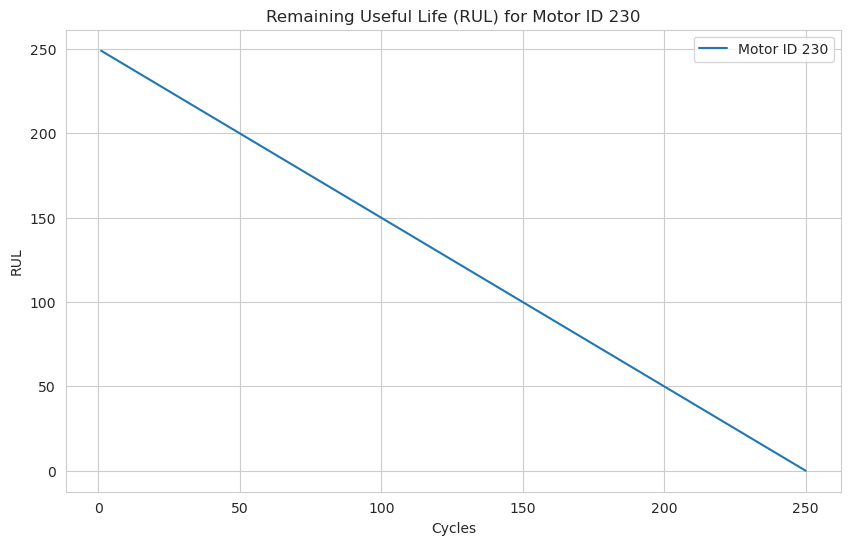

In [95]:
# Example motor ID
motor_id = 230
motor_data = turbine4_train[turbine4_train["unit_number"] == motor_id]

# Set the aesthetic style of the plots
sns.set_style("whitegrid")

# Plot the RUL with "cycles" on the x-axis using Seaborn
plt.figure(figsize=(10, 6))
sns.lineplot(data=motor_data, x="cycle", y="RUL", label=f'Motor ID {motor_id}')
plt.title(f'Remaining Useful Life (RUL) for Motor ID {motor_id}')
plt.xlabel('Cycles')
plt.ylabel('RUL')
plt.legend()
plt.show()

#### 1.4.3 Feature distributions

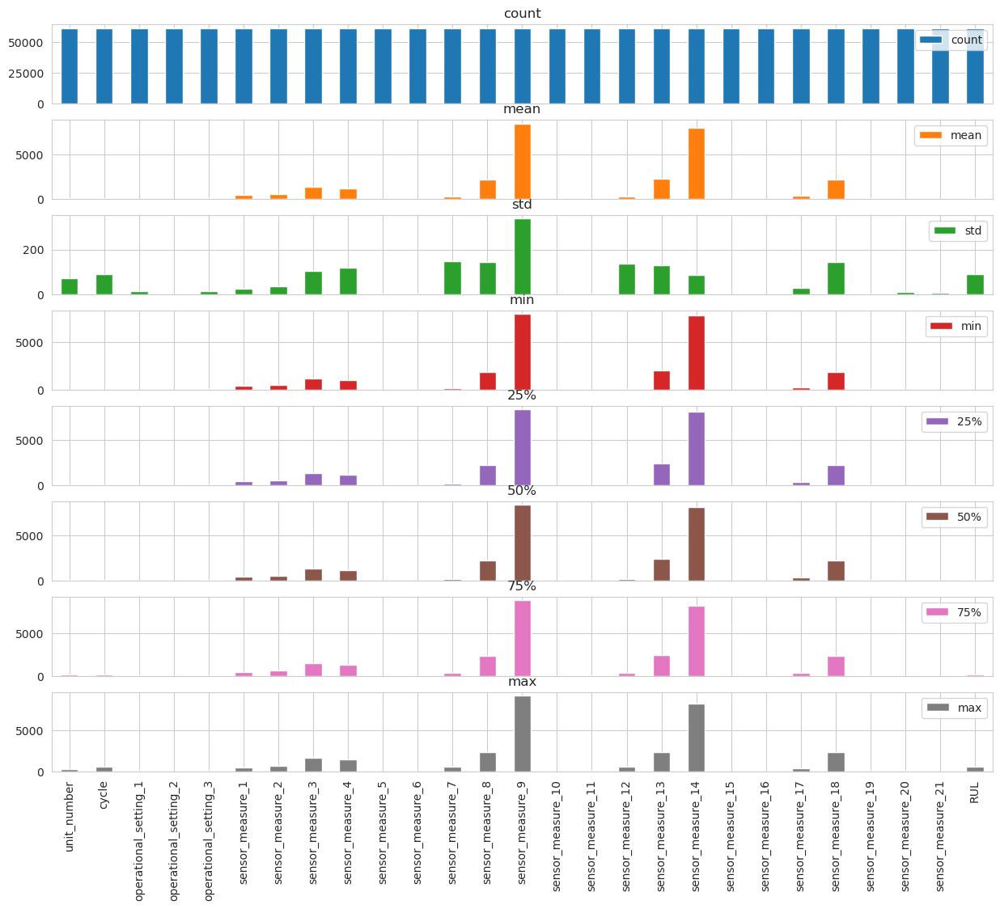

In [96]:
# plot an overview of whats going on in the columns
axes = turbine4_train.describe().T.plot.bar(subplots=True, figsize=(15,12))

It seems that there are columns with constant values.

In [97]:
cols_const = [ col for col in turbine4_train.columns if len(turbine4_train[col].unique()) <= 1 ]
print('Columns with constant values: \n' + str(cols_const) + '\n')

Columns with constant values: 
[]



No there arent but if we search for only 2 unique values?

In [98]:
cols_const = [ col for col in turbine4_train.columns if len(turbine4_train[col].unique()) <= 2 ]
print('Columns with constant values: \n' + str(cols_const) + '\n')

cols_const = [ col for col in turbine4_test.columns if len(turbine4_test[col].unique()) <= 2 ]
print('Columns with constant values: \n' + str(cols_const) + '\n')

Columns with constant values: 
['operational_setting_3', 'sensor_measure_16', 'sensor_measure_19']

Columns with constant values: 
['operational_setting_3', 'sensor_measure_16', 'sensor_measure_19']



In train and test data they match.

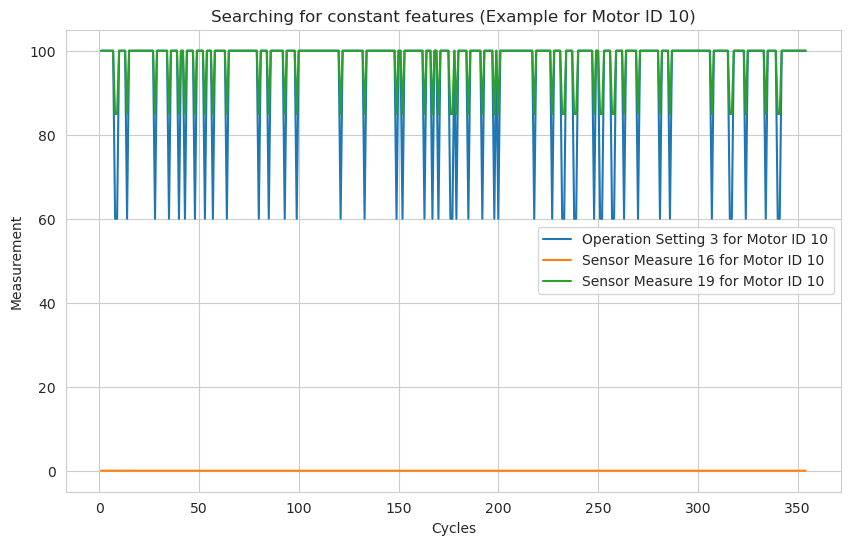

In [99]:
# Example motor ID
motor_id = 10
motor_data = turbine4_train[turbine4_train["unit_number"] == motor_id]

# Plot the RUL with "cycles" on the x-axis using Seaborn
plt.figure(figsize=(10, 6))
sns.lineplot(data=motor_data, x="cycle", y="operational_setting_3", label=f'Operation Setting 3 for Motor ID {motor_id}')
sns.lineplot(data=motor_data, x="cycle", y="sensor_measure_16", label=f'Sensor Measure 16 for Motor ID {motor_id}')
sns.lineplot(data=motor_data, x="cycle", y="sensor_measure_19", label=f'Sensor Measure 19 for Motor ID {motor_id}')
plt.title(f'Searching for constant features (Example for Motor ID {motor_id})')
plt.xlabel('Cycles')
plt.ylabel('Measurement')
plt.legend()
plt.show()

Ok, maybe could be useful eliminate this columns. We try with different motor id and th Sensor Measure 16 is always constan. Also the other two, Operation Setting 3 and Sensor Measure 19 have only two values and they are correlated.

#### 1.4.4 Correlation

<Axes: >

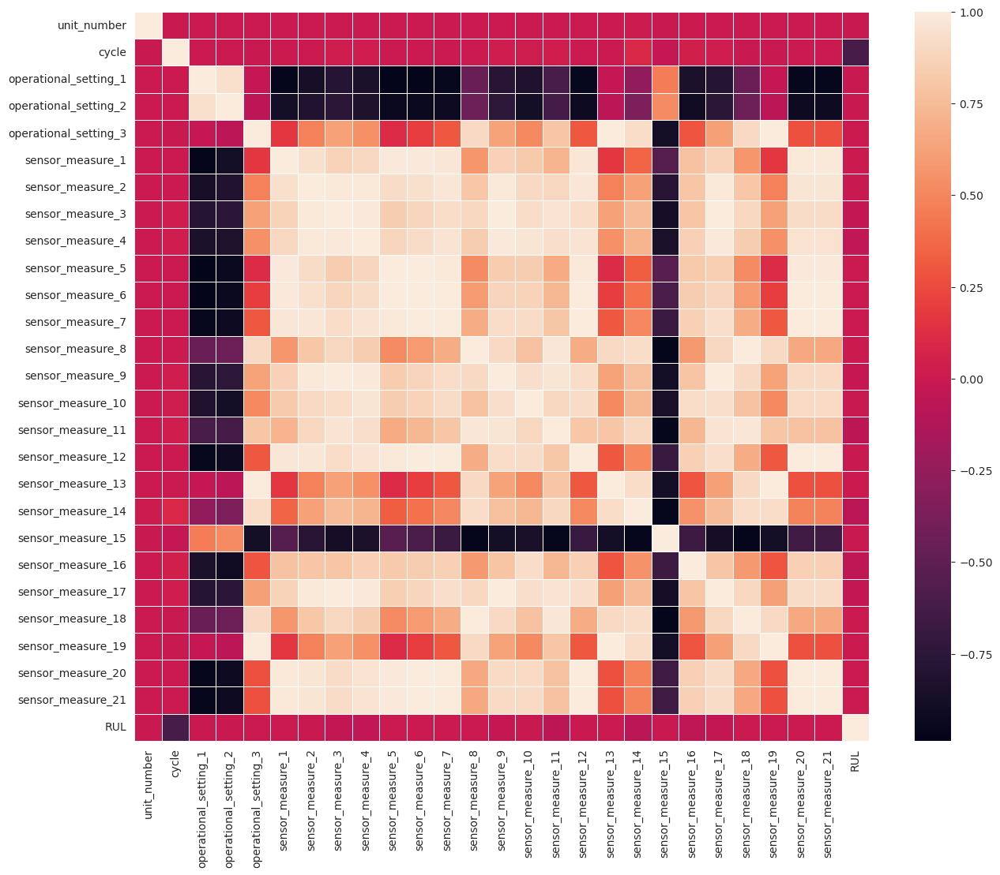

In [100]:
# Pearson correlation heatmap
analysis_data_corr = turbine4_train.corr(method='pearson')
fig, ax = plt.subplots(figsize=(15,12))
sns.heatmap(analysis_data_corr, linewidths=.5)

In [101]:
# Print highly correlated values
analysis_data_corr2 = pd.DataFrame(np.tril(analysis_data_corr.values), columns=analysis_data_corr.columns, index = analysis_data_corr.index)

correlating = []
for col in analysis_data_corr2.columns:
    ser = analysis_data_corr2[col]
    idx = np.logical_or(-0.8 > ser,  ser > 0.8)
    for i, c in zip(ser[idx].index, ser[idx].values):
        if (i, col, c) not in correlating and i != col:
            correlating.append((col, i, c))

print('Highly correlating values:')
for c in correlating:
    print(c)

Highly correlating values:
('operational_setting_1', 'operational_setting_2', 0.9437957915253659)
('operational_setting_1', 'sensor_measure_1', -0.9647537825551034)
('operational_setting_1', 'sensor_measure_2', -0.8683901310670603)
('operational_setting_1', 'sensor_measure_4', -0.8399879849209932)
('operational_setting_1', 'sensor_measure_5', -0.98738240721035)
('operational_setting_1', 'sensor_measure_6', -0.976518260435562)
('operational_setting_1', 'sensor_measure_7', -0.9515816690180171)
('operational_setting_1', 'sensor_measure_10', -0.823819118986815)
('operational_setting_1', 'sensor_measure_12', -0.9511577073510264)
('operational_setting_1', 'sensor_measure_16', -0.840823399514854)
('operational_setting_1', 'sensor_measure_20', -0.9620426253630363)
('operational_setting_1', 'sensor_measure_21', -0.9620518497410266)
('operational_setting_2', 'sensor_measure_1', -0.886122667495125)
('operational_setting_2', 'sensor_measure_2', -0.8116126104744334)
('operational_setting_2', 'senso

Maybe we can eliminate one of the high correlated features, the information is redundant. And the constant values of the previous part, maybe be can ignore it.

In [102]:
# Select the correlations with the target variable 'RUL'
rul_corr = analysis_data_corr['RUL']

# Sort the correlations by absolute value
sorted_rul_corr = rul_corr.reindex(rul_corr.abs().sort_values(ascending=False).index)

# Print the sorted correlating values with RUL
print('Correlating values with RUL, sorted by absolute value:')
for feature, correlation in sorted_rul_corr.items():
    print((feature, correlation))

Correlating values with RUL, sorted by absolute value:
('RUL', 1.0)
('cycle', -0.6106197186967642)
('sensor_measure_14', -0.07812615219035073)
('sensor_measure_11', -0.0566392400577737)
('sensor_measure_16', -0.053804336930271035)
('sensor_measure_4', -0.04588110859302568)
('sensor_measure_17', -0.032939303551029676)
('sensor_measure_3', -0.03292405654292328)
('sensor_measure_9', -0.02472715028406107)
('sensor_measure_10', -0.008924050245450826)
('sensor_measure_2', -0.004443240063718993)
('sensor_measure_15', -0.003957072898584357)
('unit_number', -0.003655914776624505)
('sensor_measure_20', 0.0028117009588077063)
('sensor_measure_21', 0.0027907932394577693)
('sensor_measure_18', 0.0027646377576236777)
('operational_setting_1', -0.0023803262557565495)
('operational_setting_3', 0.002303388225444186)
('sensor_measure_19', 0.002303388225443806)
('operational_setting_2', -0.0022795344868175756)
('sensor_measure_8', 0.002086059038859893)
('sensor_measure_1', 0.0018894117842805657)
('sensor

The correlation is minimal.

#### 1.4.5 Time and Distribution Plots

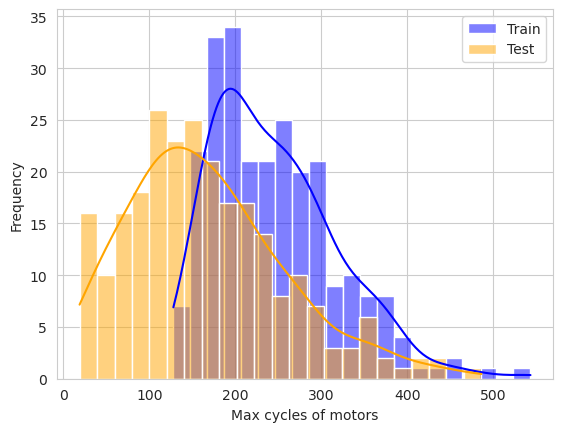

In [103]:
sns.histplot(data=cycles_train, binwidth=20, kde=True, color='blue', label='Train')
sns.histplot(data=cycles_test, binwidth=20, kde=True, color='orange', label='Test')

# Adding x and y labels
plt.xlabel("Max cycles of motors")  # Adding x label
plt.ylabel("Frequency")             # Adding y label

# Adding legend
plt.legend()

# Show the plot
plt.show()

At first eye it is good that the train and test dataset have similar distributions form. The max cycle of test isnt real the max cycle, because in the test data the time line ends before the failure, but we can see a trend that is preserved in train and test data. The failure for train is around 200 cycles for the mean. The distribution is a bit skewed to the left. We have some outliers maschines that complete more than 400 cycles.

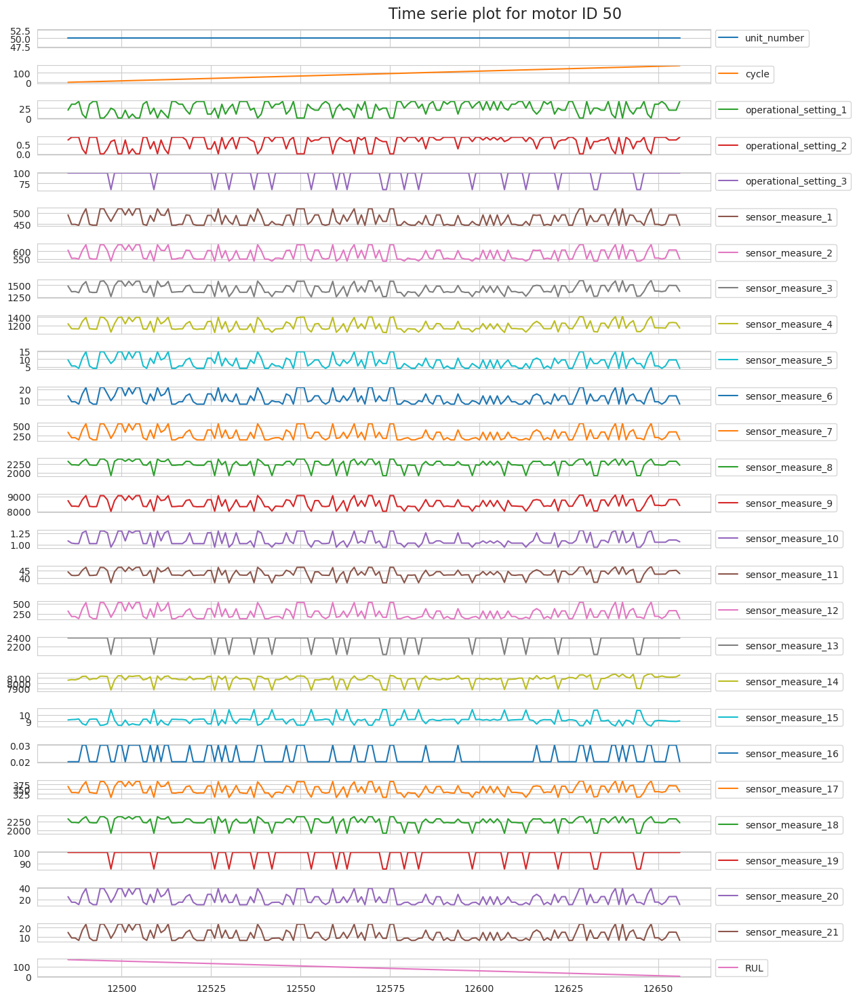

In [104]:
# Plot all sensor data of one motor
motor_id = 50

axes = turbine4_train[turbine4_train['unit_number']==motor_id].plot(subplots=True, figsize=(15, 15))
for ax in axes:
    # Set the legend to be outside the plot on the right
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout(rect=[0, 0, 0.85, 0.97])  # Make room on the right for the legends
plt.suptitle(f'Time serie plot for motor ID {motor_id}', fontsize=16)
plt.show()

It is not easy to see a trend or something here. Lets se more in detail one motor feature.

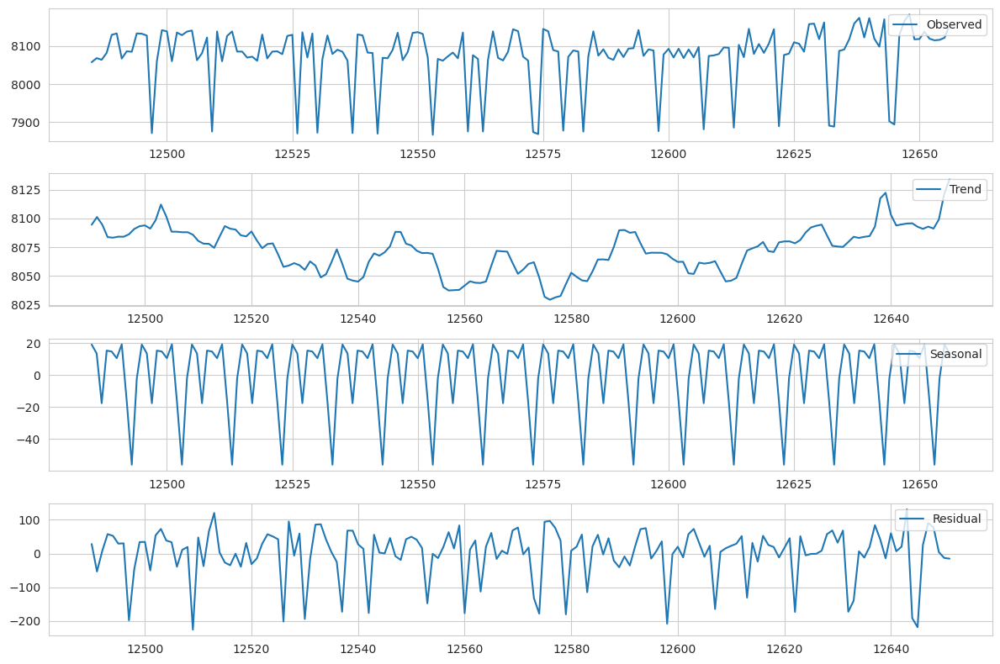

In [105]:
feature = 'sensor_measure_14' #Choose feature to see
motor_id = 50
ts = turbine4_train[turbine4_train['unit_number'] == motor_id][feature]

decomposition = sm.tsa.seasonal_decompose(ts, model='additive', period=10)
# Plot the decomposition components
plt.figure(figsize=(12, 8))

plt.subplot(411)
plt.plot(ts, label='Observed')
plt.legend(loc='upper right')

plt.subplot(412)
plt.plot(decomposition.trend, label='Trend')
plt.legend(loc='upper right')

plt.subplot(413)
plt.plot(decomposition.seasonal, label='Seasonal')
plt.legend(loc='upper right')

plt.subplot(414)
plt.plot(decomposition.resid, label='Residual')
plt.legend(loc='upper right')

plt.tight_layout()
plt.show()

Now it is easier to see the trend of each sensor. Lets plot all sensor trends of one motor.

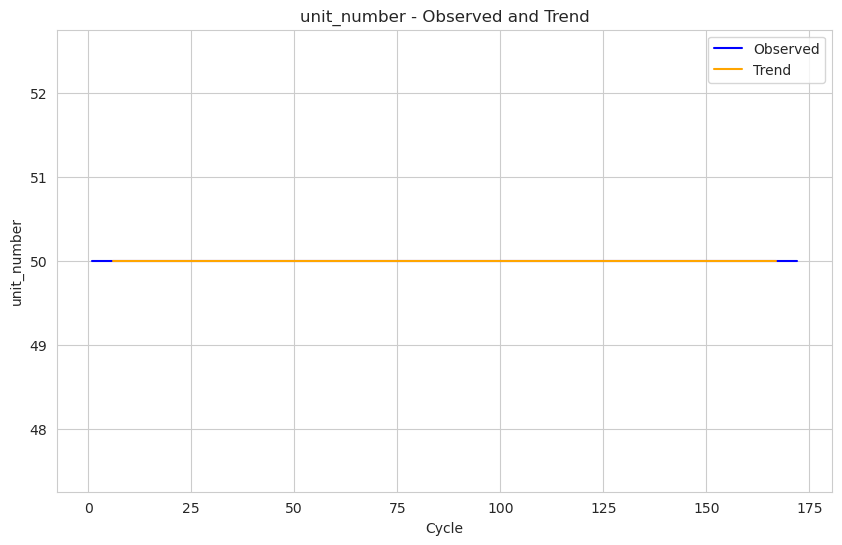

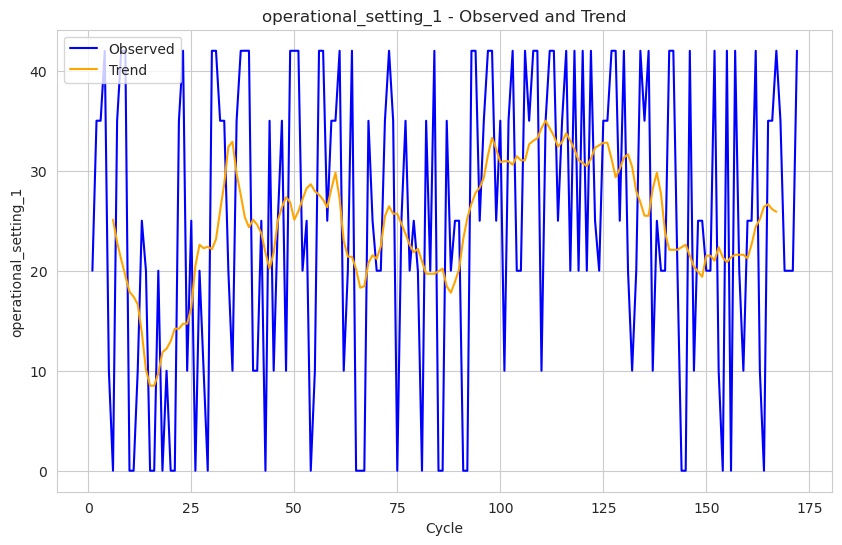

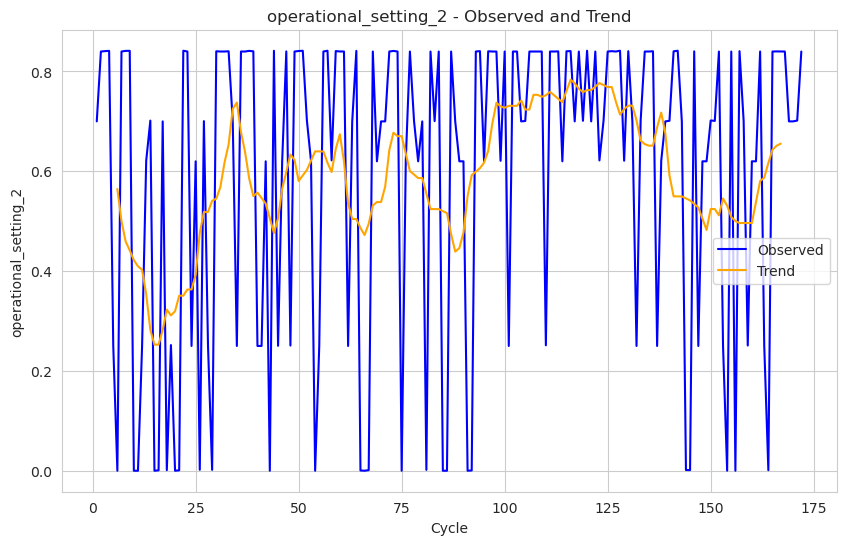

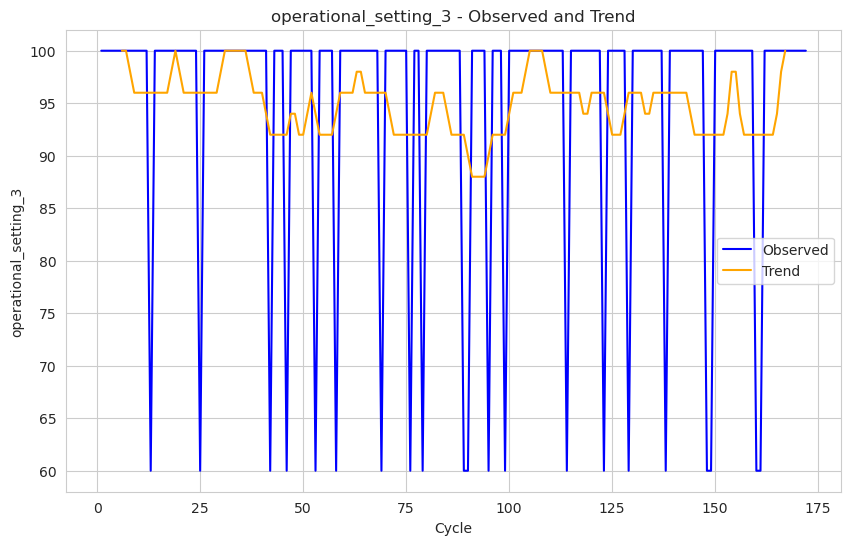

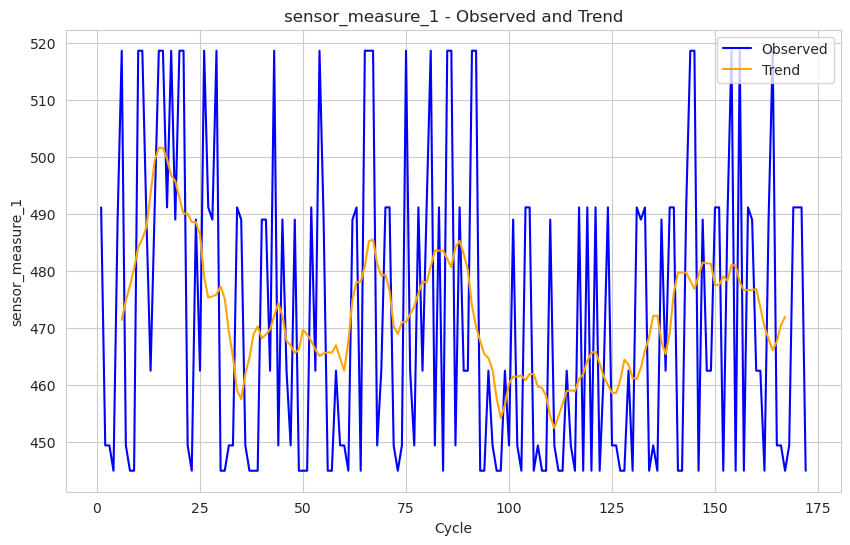

...

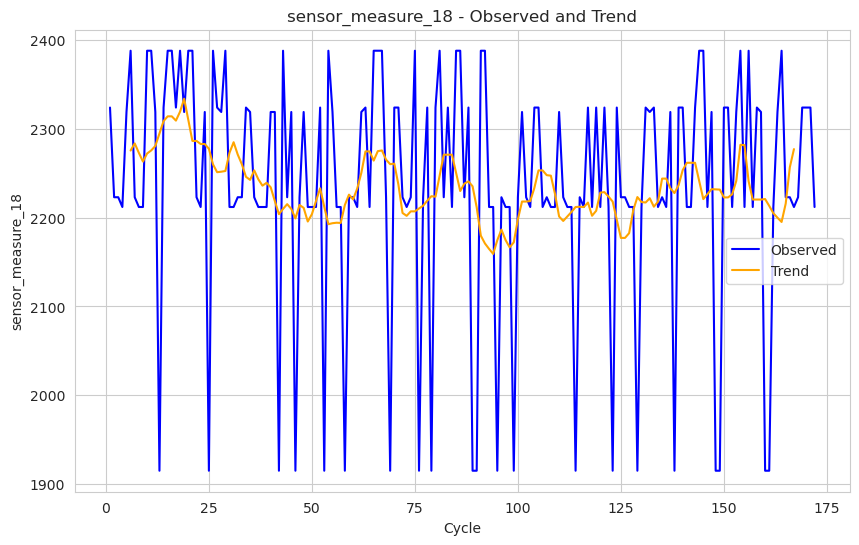

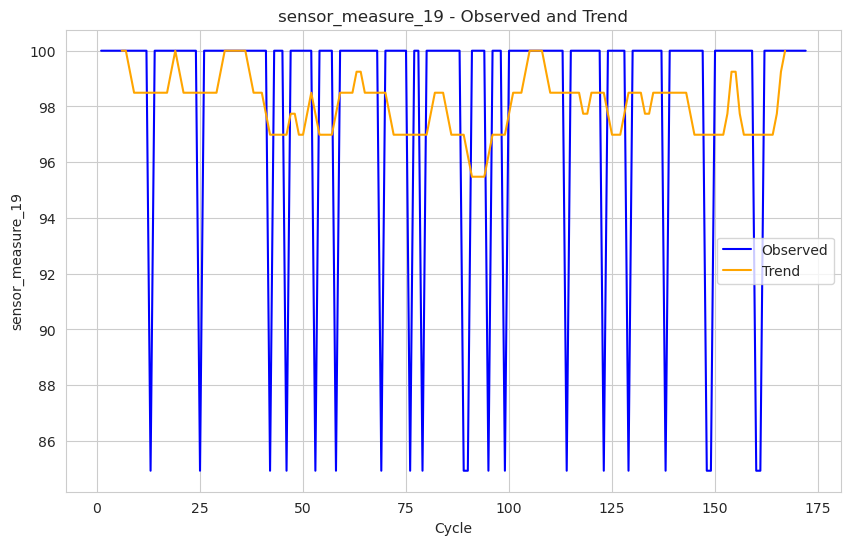

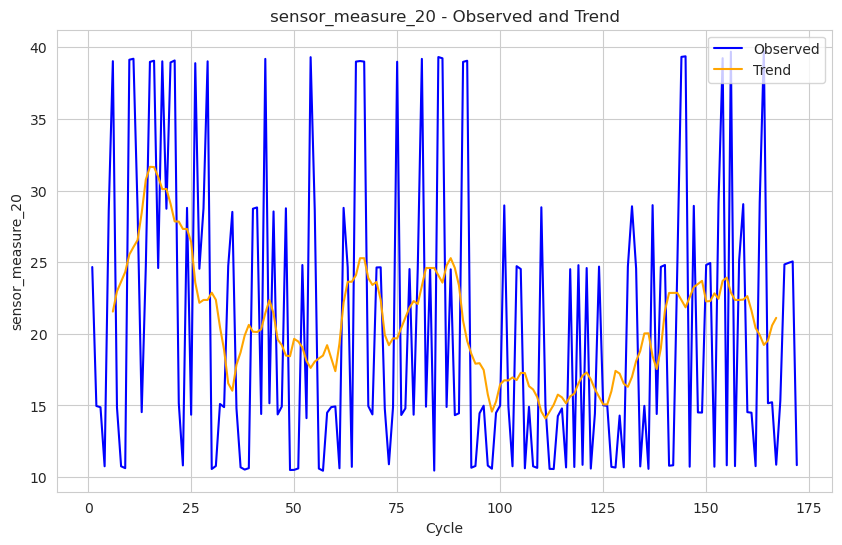

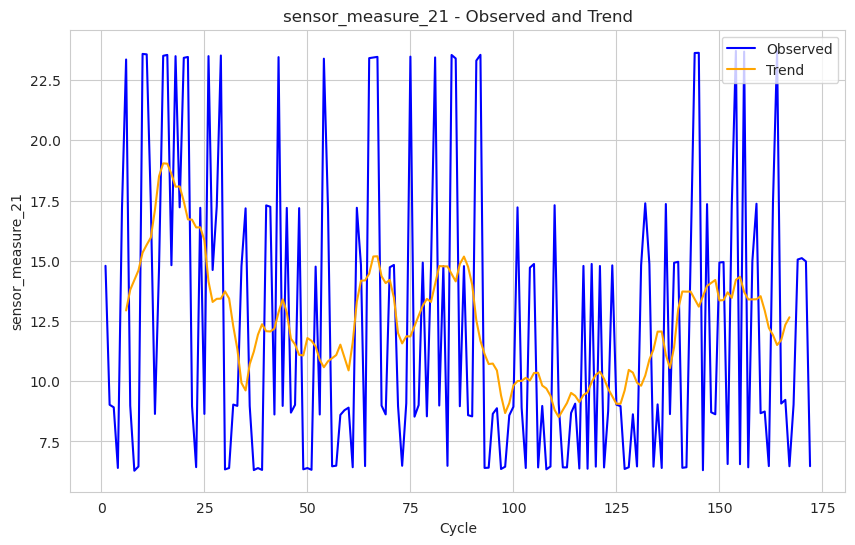

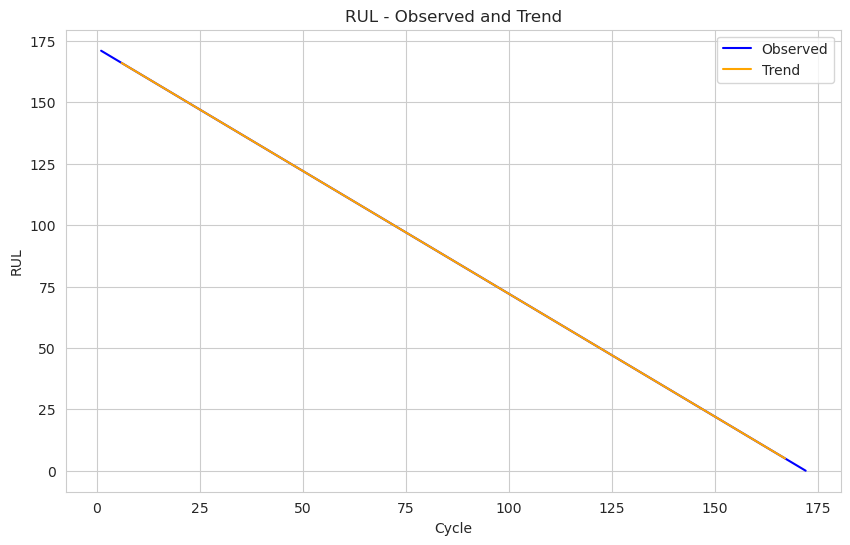

In [106]:
motor_id = 50
unit_data = turbine4_train[turbine4_train['unit_number'] == motor_id].set_index('cycle')
period = 10  # Adjust the period as needed

# Plot observed and trend data for each sensor column
for feature in unit_data.columns:
    ts = unit_data[feature]

    # Perform seasonal decomposition
    decomposition = sm.tsa.seasonal_decompose(ts, model='additive', period=period)

    # Plot the observed and trend components
    plt.figure(figsize=(10, 6))
    plt.plot(ts, label='Observed', color='blue')
    plt.plot(decomposition.trend, label='Trend', color='orange')
    plt.xlabel('Cycle')
    plt.ylabel(feature)
    plt.title(f'{feature} - Observed and Trend')
    plt.legend()
    plt.grid(True)
    plt.show()


It is not easy to say something. But we can see a trend that maybe a model can learn. Lets try to see some motors togeter

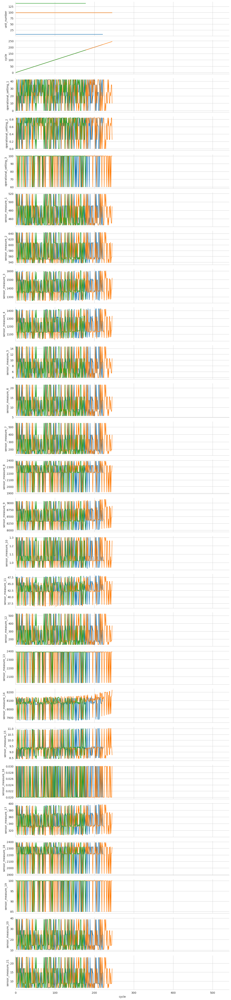

In [109]:
# Plot random 3 motors.
random_motor_ids = pd.Series(unit_train).sample(n=3, random_state=42).tolist()
filtered_data = turbine4_train[turbine4_train['unit_number'].isin(random_motor_ids)]
g = sns.PairGrid(data=filtered_data, x_vars='cycle', y_vars=input_file_column_names, hue="unit_number", height=2, aspect=6,)
g = g.map(plt.plot)
g = g.set(xlim=(turbine4_train['RUL'].min(), turbine4_train['RUL'].max()))

The tree time lines look very alike. But it is difficult to say something, they overlap a lot.

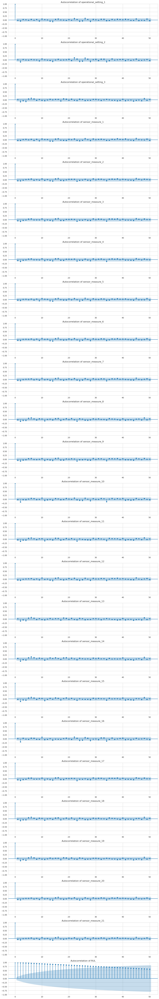

In [108]:
motor_id = 10  # Example unit_id, change as needed
unit_data = turbine4_train[turbine4_train['unit_number'] == motor_id].set_index('cycle')
unit_data = unit_data.drop(['unit_number'], axis=1)

# Create subplots for autocorrelation plots
num_data = len(unit_data.columns)
fig, axes = plt.subplots(nrows=num_data, ncols=1, figsize=(12, num_data * 3))

# Compute and plot autocorrelation for each sensor column
for ax, feature in zip(axes, unit_data.columns):
    ts = unit_data[feature]
    
    # Plot the autocorrelation function (ACF)
    sm.graphics.tsa.plot_acf(ts.dropna(), lags=50, ax=ax)
    ax.set_title(f'Autocorrelation of {feature}')

plt.tight_layout()
plt.show()


It is not so good, the autocorrelation is near 0 almost all the time, this tell that the data its pretty random.

## 2. Take aways

1. Turbine 1
    - ...
2. Turbine 2
    - etc
3. Turbine 3
    - etc
4. Turbine 4
    - No missing values
    - There are some features with constant values (1 and 2 values only). The feature operational setting 3 and sensor measure 19 have only two values, but they are strong correlated => eliminate one or both?
    - There are strong correlated features, we can discard some of them.
    - No correlation of features to RUL.
    - Max cycle distribution of train and test similar, good for generalization.
    - Plotting some motors we can see some minimal trend, but mostly it is random. Autocorrelation also confirm this randomness.